In [1]:
import torch
print("CUDA available:", torch.cuda.is_available())
print("CUDA version:", torch.version.cuda)


CUDA available: True
CUDA version: 12.1


In [6]:
import tensorflow as tf
import os
import numpy as np
import cv2

class PreprocessImage:
    def __init__(self):
        pass

    def preprocess_image_forGender(self, filename):
        """
        Load the specified file as a JPEG image, preprocess it, and
        resize it to the target shape for Gender Classification.
        """
        TARGET_SHAPE = (256,256,3)
        image_string = tf.io.read_file(filename)
        image = tf.image.decode_jpeg(image_string, channels=3)
        image = tf.image.resize(image, TARGET_SHAPE[:2])
        return tf.expand_dims(image, axis=0)
        
        



    def preprocess_image_forEmbeddings(self,image_np: np.ndarray):

        TARGET_SHAPE = (224, 224, 3)

        # Convert numpy array to JPEG-encoded bytes
        _, buffer = cv2.imencode('.jpg', image_np)
        image_data = buffer.tobytes()  # Convert the encoded image to bytes

        # Now preprocess the image 
        image = tf.image.decode_jpeg(image_data, channels=3)
        image = tf.image.convert_image_dtype(image, tf.float32)
        image = tf.image.resize(image, TARGET_SHAPE[:2])

        return tf.expand_dims(image, axis=0)


In [41]:
#Write functions to load our trained models and csv files which contains embeddings of our scrapped data
from tensorflow.keras.models import load_model
import pandas as pd

#Initializing dictionaries
LOADED_MODELS = dict()
LOADED_CSVS = dict()

def load_models():
    """
    Load Various Models for Recommendation Engine Pipeline
    """
    if len(LOADED_MODELS) == 6:
        return LOADED_MODELS
    else:
        print("Loading Models...")
        GENDER_CLASSIFIER = load_model("./gender_classifier_EfficientNet.h5")
        TOPWEAR_EMBEDDING = load_model("./embedding generating models/embedding_topwear_InceptionV3.h5")
        BOTTOMWEAR_EMBEDDING = load_model("./embedding generating models/embedding_bottomwear_InceptionV3.h5")
        FOOTWEAR_EMBEDDING = load_model("./embedding generating models/embedding_footwear_InceptionV3.h5")
        EYEWEAR_EMBEDDING = load_model("./embedding generating models/embedding_eyewear_InceptionV3.h5")
        HANDBAGS_EMBEDDING = load_model("./embedding generating models/embedding_handbags_InceptionV3.h5")

        LOADED_MODELS["gender_classifier"] = GENDER_CLASSIFIER
        LOADED_MODELS["topwear"] = TOPWEAR_EMBEDDING
        LOADED_MODELS["bottomwear"] = BOTTOMWEAR_EMBEDDING
        LOADED_MODELS["footwear"] = FOOTWEAR_EMBEDDING
        LOADED_MODELS["eyewear"] = EYEWEAR_EMBEDDING
        LOADED_MODELS["handbag"] = HANDBAGS_EMBEDDING
        print("Models Loaded!")
        return LOADED_MODELS
    
def load_CSVs():
    """
    Load Various CSV files for Embedding Generation Pipeline
    """
    if len(LOADED_CSVS) == 9:
        return LOADED_CSVS
    else:
        print("Loading CSVs...")
        MENS_TOPWEAR_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/mens_topwear_embeddings.csv")
        MENS_BOTTOMWEAR_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/mens_bottomwear_embeddings.csv")
        MENS_FOOTWEAR_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/mens_footwear_embeddings.csv")
        MENS_EYEWEAR_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/mens_eyewear_embeddings.csv")
        WOMENS_TOPWEAR_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_topwear_embeddings.csv")
        WOMENS_BOTTOMWEAR_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_bottomwear_embeddings.csv")
        WOMENS_FOOTWEAR_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_footwear_embeddings.csv")
        WOMENS_EYEWEAR_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/womens_eyewear_embeddings.csv")
        HANDBAGS_CSV = pd.read_csv("./downloaded_scrapped_data_embeddings/handbags_embeddings.csv")

        
        LOADED_CSVS["mens_topwear"] = MENS_TOPWEAR_CSV
        LOADED_CSVS["mens_bottomwear"] = MENS_BOTTOMWEAR_CSV
        LOADED_CSVS["mens_footwear"] = MENS_FOOTWEAR_CSV
        LOADED_CSVS["mens_eyewear"] = MENS_EYEWEAR_CSV
        LOADED_CSVS["womens_topwear"] = WOMENS_TOPWEAR_CSV
        LOADED_CSVS["womens_bottomwear"] = WOMENS_BOTTOMWEAR_CSV
        LOADED_CSVS["womens_footwear"] = WOMENS_FOOTWEAR_CSV
        LOADED_CSVS["womens_eyewear"] = WOMENS_EYEWEAR_CSV
        LOADED_CSVS["handbags"] = HANDBAGS_CSV

        print("CSVs Loaded!")
        return LOADED_CSVS

In [13]:
#Now lets write a class that can do gender classification for us using our trained model

class GenderClassification:
    def __init__(self, image, loaded_models):
        """
        Initializes the GenderClassification class.
        
        :param image: Preprocessed image for gender classification.
        :param loaded_models: Dictionary containing loaded models with "gender_classifier" as a key.
        """
        self.image = image
        self.model = loaded_models.get("gender_classifier")

    def predict_gender(self):
        """
        Predicts the gender (men or female) from the image using the gender classification model.
        
        :return: String indicating the predicted gender: "men" or "female".
        """
        if self.model is None:
            raise ValueError("The 'gender_classifier' model is not found in the loaded_models dictionary.")
        
        predictions = self.model.predict(self.image)
        predicted_class = tf.argmax(predictions, axis=1).numpy()[0]

        return "male" if predicted_class == 0 else "female"


In [14]:
#Now write code to use preprocess class method by passing it file path
#And then give the prepocessed image to gender classification class as input to get output of whether male or female is detected.
img_path = "./Examples/FullShot_Example8.png"
preprocess = PreprocessImage()
preprocessed_img = preprocess.preprocess_image_forGender(img_path)

#NOw lets first load our models by calling load models function
load_models()

#Now lets call our gender classifier class to predict the class
gender_classifier = GenderClassification(preprocessed_img,LOADED_MODELS)
predicted_gender = gender_classifier.predict_gender()
print(predicted_gender)



Loading Models...
Models Loaded!
1/1 [==============================] - 6s 6s/step
male


In [6]:
#NOw lets do the same thing by giving a image of a women
img_path = "./Examples/FullShot_Example9.png"
preprocess = PreprocessImage()
preprocessed_img = preprocess.preprocess_image_forGender(img_path)

#NOw lets first load our models by calling load models function
load_models()

#Now lets call our gender classifier class to predict the class
gender_classifier = GenderClassification(preprocessed_img,LOADED_MODELS)
predicted_gender = gender_classifier.predict_gender()
print(predicted_gender)

Loading Models...
Models Loaded!
1/1 [==============================] - 1s 992ms/step
female


In [15]:
#Now lets see for more examples of male images
#We have already loaded models by calling load_models() previously. So no need to call it again and again

img_path = "./Examples/FullShot_Example10.png"
preprocess = PreprocessImage()
preprocessed_img = preprocess.preprocess_image_forGender(img_path)


#Now lets call our gender classifier class to predict the class
gender_classifier = GenderClassification(preprocessed_img,LOADED_MODELS)
predicted_gender = gender_classifier.predict_gender()
print(predicted_gender)

1/1 [==============================] - 0s 42ms/step
male


In [16]:
#Now lets see for more examples of female image
#We have already loaded models by calling load_models() previously. So no need to call it again and again

img_path = "./Examples/FullShot_Example5.jpg"
preprocess = PreprocessImage()
preprocessed_img = preprocess.preprocess_image_forGender(img_path)


#Now lets call our gender classifier class to predict the class
gender_classifier = GenderClassification(preprocessed_img,LOADED_MODELS)
predicted_gender = gender_classifier.predict_gender()
print(predicted_gender)

1/1 [==============================] - 0s 28ms/step
female


In [8]:
#Now lets see for more examples of male image

img_path = "./Examples/FullShot_Example3.jpg"
preprocess = PreprocessImage()
preprocessed_img = preprocess.preprocess_image_forGender(img_path)


#Now lets call our gender classifier class to predict the class
gender_classifier = GenderClassification(preprocessed_img,LOADED_MODELS)
predicted_gender = gender_classifier.predict_gender()
print(predicted_gender)

1/1 [==============================] - 0s 22ms/step
male


In [10]:
#Now lets see for more examples of male image which is not full shot

img_path = "./Examples/NotFullShot_Example2.jpg"
preprocess = PreprocessImage()
preprocessed_img = preprocess.preprocess_image_forGender(img_path)


#Now lets call our gender classifier class to predict the class
gender_classifier = GenderClassification(preprocessed_img,LOADED_MODELS)
predicted_gender = gender_classifier.predict_gender()
print(predicted_gender)


1/1 [==============================] - 0s 14ms/step
male


In [17]:
import tensorflow as tf

print("cuDNN Version:", tf.sysconfig.get_build_info()["cudnn_version"])


cuDNN Version: 64_8


In [18]:
import cv2
from ultralytics import YOLO

class ExtractObjects:
    def __init__(self):
        pass
    
    def load_model(self, weights_path):
        model = YOLO(weights_path)
        return model

    def get_predictions(self, model, image_path):
        image = cv2.imread(image_path)
        results = model.predict(image, imgsz=512)
        return results

    def generate_bbox(self, image_path, results, model):
        outputs = {}
        detected_objects = {}
        image = cv2.imread(image_path)


        for result in results:
            boxes = result.boxes.xyxy.cpu().numpy()
            confs = result.boxes.conf.cpu().numpy()
            classes = result.boxes.cls.cpu().numpy()

            for i in range(len(boxes)):
                x1, y1, x2, y2 = boxes[i]
                conf = confs[i]
                cls = int(classes[i])
                class_name = model.names[cls]

                if class_name not in detected_objects or detected_objects[class_name][0] < conf:
                    detected_objects[class_name] = (conf, (x1, y1, x2, y2))

        for class_name, (conf, (x1, y1, x2, y2)) in detected_objects.items():
            x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2)
            object_slice = image[y1:y2, x1:x2]
            outputs[class_name] = object_slice

        outputs["original_image"] = image
        return outputs

    def extract_objects(self, weights_path, image_path):
        model = self.load_model(weights_path)
        results = self.get_predictions(model, image_path)
        outputs = self.generate_bbox(image_path, results, model)
        return outputs



0: 512x384 1 TOPWEAR, 1 BOTTOMWEAR, 1 FOOTWEAR, 1 EYEWEAR, 529.1ms
Speed: 12.6ms preprocess, 529.1ms inference, 1274.3ms postprocess per image at shape (1, 3, 512, 384)


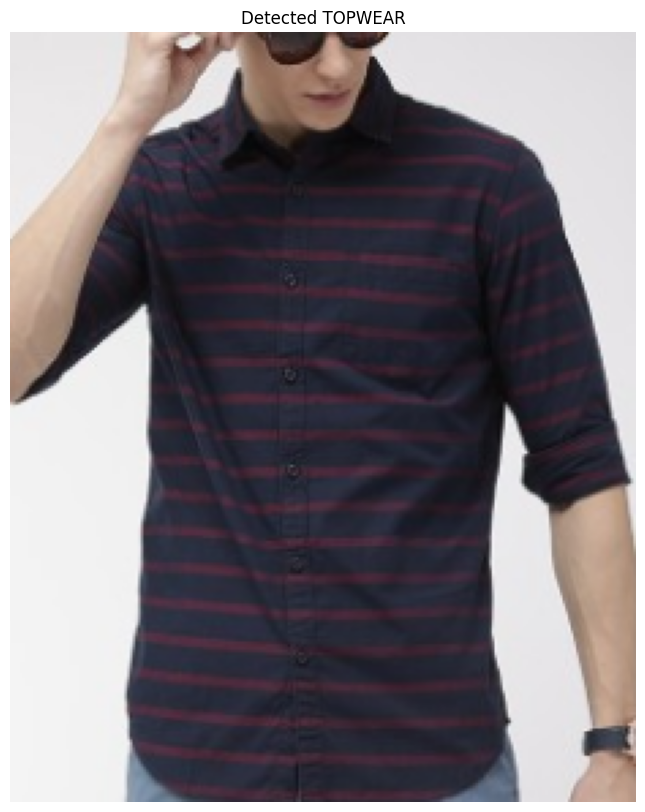

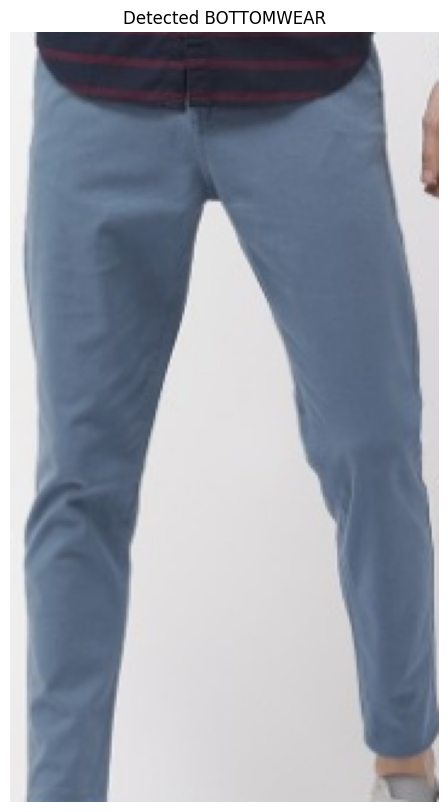

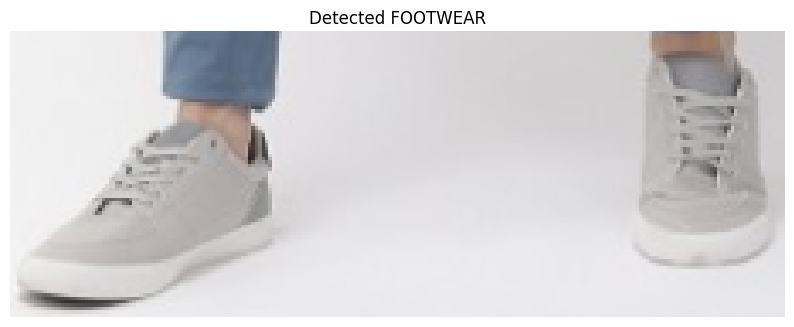

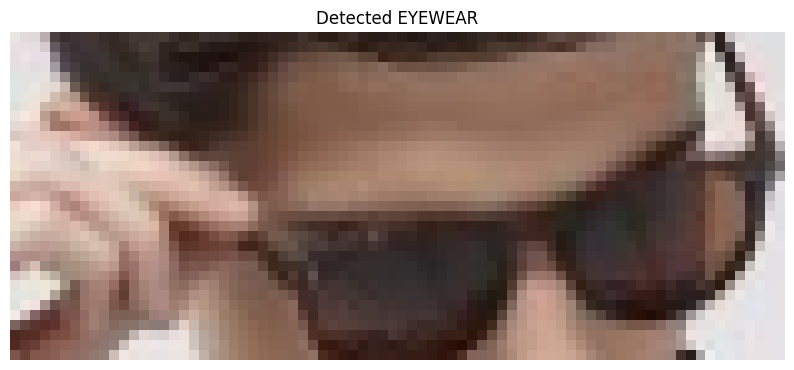

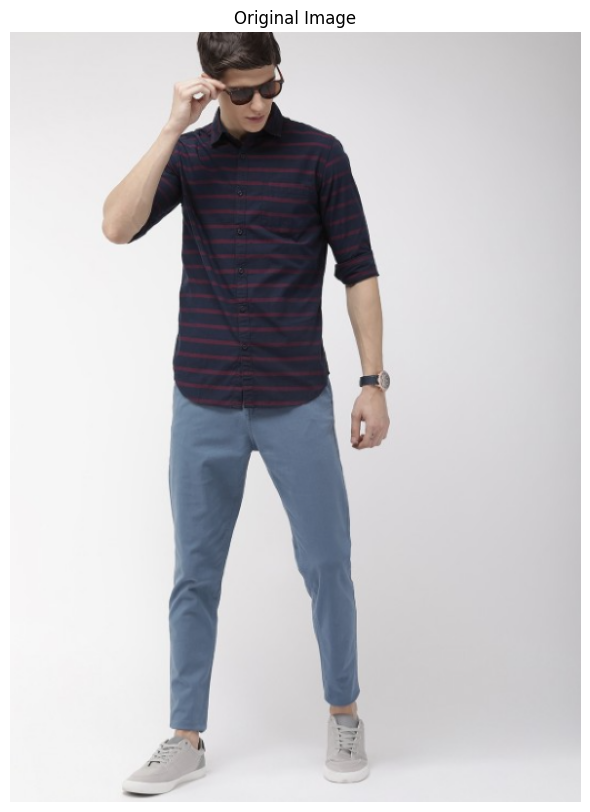

In [19]:
import matplotlib.pyplot as plt

weights_path = "./runs/detect/yolo_small_train/weights/best.pt"  
image_path ="./Examples/FullShot_Example8.png" 

#Now lets create instance of ExtractObjects class
extract_obj_inst = ExtractObjects()
outputs = extract_obj_inst.extract_objects(weights_path, image_path)

def display_image(image, title="Image"):
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.title(title)
    plt.axis('off')
    plt.show()

# Displaying the results in the notebook
for class_name, img_slice in outputs.items():
    if class_name != "original_image":
        display_image(img_slice, title=f"Detected {class_name}")
display_image(outputs["original_image"], title="Original Image")


0: 512x352 1 TOPWEAR, 1 FOOTWEAR, 1 HANDBAG, 212.9ms
Speed: 6.9ms preprocess, 212.9ms inference, 0.5ms postprocess per image at shape (1, 3, 512, 352)


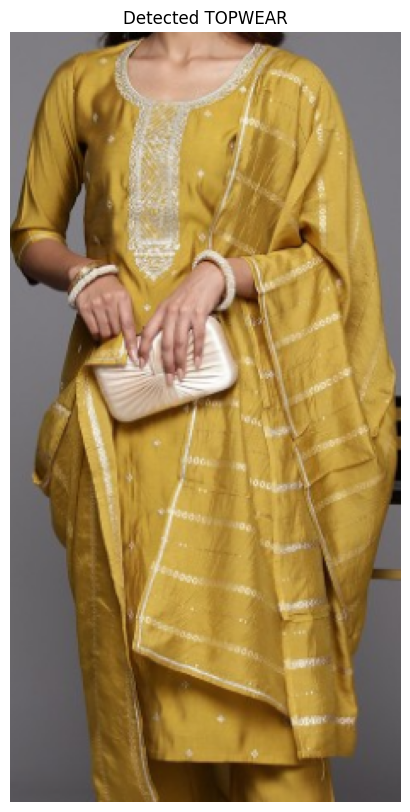

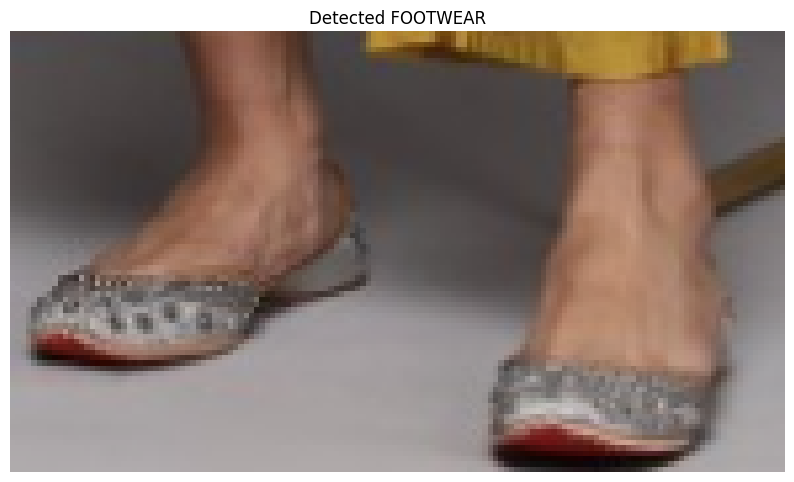

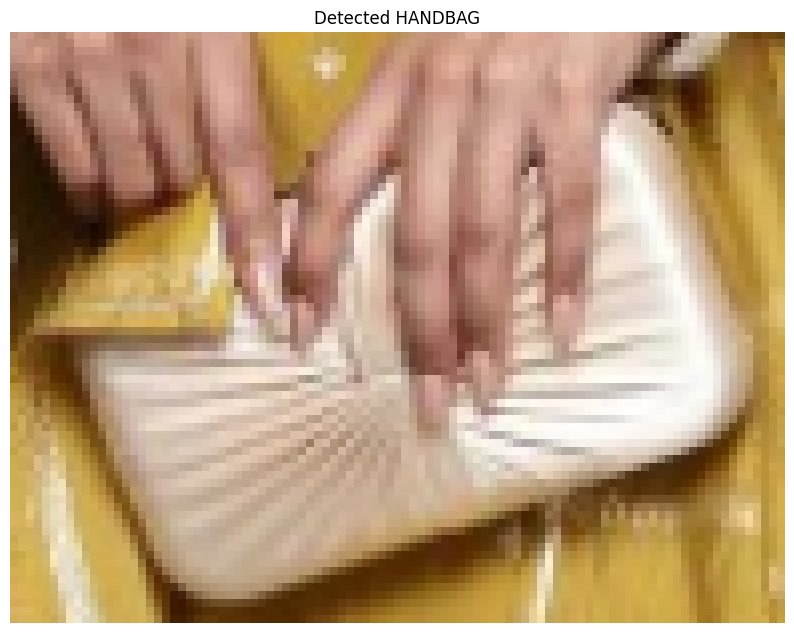

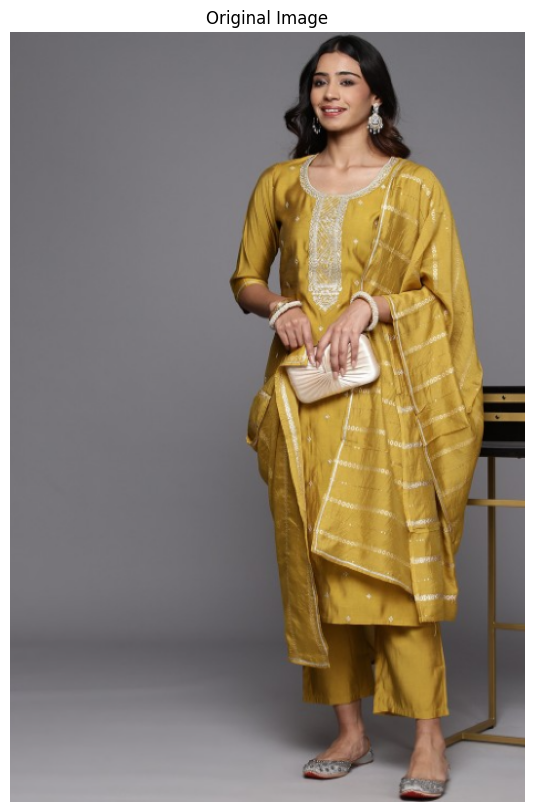

In [20]:
weights_path = "./runs/detect/yolo_small_train/weights/best.pt"  
image_path ="./Examples/FullShot_Example9.png" 

#Now lets create instance of ExtractObjects class
extract_obj_inst = ExtractObjects()
outputs = extract_obj_inst.extract_objects(weights_path, image_path)

# Displaying the results in the notebook
for class_name, img_slice in outputs.items():
    if class_name != "original_image":
        display_image(img_slice, title=f"Detected {class_name}")
display_image(outputs["original_image"], title="Original Image")

In [26]:
outputs.keys()

dict_keys(['TOPWEAR', 'FOOTWEAR', 'HANDBAG', 'original_image'])

In [23]:
type(outputs)

dict

In [24]:
type(outputs["TOPWEAR"])

numpy.ndarray

In [25]:
import copy
#Now Lets write a function that preprocess these extracted object images
def preprocess_all_extracted_objects(output_dict):
    """
    Preprocess all image slices in the dictionary except for the 'original_image' key.
    """
    preprocess = PreprocessImage()
    output_dict_copy = copy.deepcopy(output_dict)  #We are creatind deep copy here because we will later need these unprocessed image slices from output_dict later to display the extracted objects
    for class_name, image_slice in output_dict_copy.items():
        if class_name != "original_image":
            output_dict_copy[class_name] = preprocess.preprocess_image_forEmbeddings(image_slice)

    return output_dict_copy


#Now lets use this above function to preprocess the extracted objects image
output_dict = preprocess_all_extracted_objects(outputs)

In [29]:
#Now lets write class that will find the similar products based on our extracted objects image slices
import numpy as np
from tqdm import tqdm


# Enable tqdm for pandas. This is to show percentage of completion while generating the embeddings. Due to this only we are able to use progress_apply in below code in find_similar_embeddings function
tqdm.pandas()

class FindSimilarObjects:
    def __init__(self):
        pass
    
    def generate_embeddings(self, output_dict, Loaded_Models):
        """
        Generates embeddings for each detected object in the output_dict using the corresponding models in Loaded_Models.
        
        Args:
        - output_dict: Dictionary with class names as keys and preprocessed image slices as values.
        - Loaded_Models: Dictionary with model names as keys and model instances as values.

        Returns:
        - embeddings_dict: Dictionary with class names as keys and embeddings as values.
        """
        embeddings_dict = {}

        for class_name, image_slice in output_dict.items():
            if class_name != "original_image":  # Skip the original image key
                class_name = class_name.lower()  # Convert key to lowercase
                model_key = class_name
                model = Loaded_Models.get(model_key)

                if model is not None:
                    # Assume the model takes the image slice directly and outputs embeddings
                    
                    embedding = model(image_slice)
                    embeddings_dict[class_name] = embedding[0].numpy().astype(np.float32).tolist()  # Convert to numpy array if needed

        return embeddings_dict
    
    def find_similar_embeddings(self,embeddings_dict,detected_gender,LOADED_CSVS):
        
        # Initialize an empty dictionary where we will store dataframe consisting of top 8 similar images url & product url for each class_name
        similar_items_urls = {}

        for class_name,embedding_of_object in embeddings_dict.items():
            if detected_gender == "male":

                if class_name=="topwear":
                    df = LOADED_CSVS["mens_topwear"]
                elif class_name=="bottomwear":
                    df = LOADED_CSVS["mens_bottomwear"]
                elif class_name=="eyewear":
                    df = LOADED_CSVS["mens_eyewear"]
                elif class_name=="footwear":
                    df = LOADED_CSVS["mens_footwear"]
                elif class_name=="handbag":
                    df = LOADED_CSVS["handbags"]
                    
            else:
                if class_name=="topwear":
                    df = LOADED_CSVS["womens_topwear"]
                elif class_name=="bottomwear":
                    df = LOADED_CSVS["womens_bottomwear"]
                elif class_name=="eyewear":
                    df = LOADED_CSVS["womens_eyewear"]
                elif class_name=="footwear":
                    df = LOADED_CSVS["womens_footwear"]
                elif class_name=="handbag":
                    df = LOADED_CSVS["handbags"]

            #Now lets calculate the distance of our embedding of extracted object with the embeddings of our scrapped data
            df['distance'] = df['embedding'].progress_apply(lambda x: np.linalg.norm(np.asarray(eval(x), dtype=np.float32) - np.asarray(embedding_of_object, dtype=np.float32)))

            # Sort the DataFrame by the 'distance' column in ascending order
            df_sorted = df.sort_values(by='distance', ascending=True).reset_index(drop=True)

            # Create a new DataFrame with the first 10 rows and specific columns: 'image_url' and 'product_url'
            top_10_similar_df = df_sorted[['image_url', 'product_url','distance']].head(10)
        
            #store this top_10_similar_df as a value for class_name as a key in similar_items_urls dictionary
            similar_items_urls[class_name] = top_10_similar_df
           

        return similar_items_urls
    
    




In [30]:
import requests
import matplotlib.pyplot as plt
from io import BytesIO
import cv2
from PIL import Image

def display_image(image, title="Image"):
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.title(title)
    plt.axis('off')
    plt.show()



#NOw lets write a function that can plot the results so that we can see the similar recommended products
def show_similar_items(output,similar_items_urls):
    """output: dictionary containing class_names(such as "original_image","topwear"etc.) as key and image slice (which is not preprocessed) of extracted objects"""
    """similar_items_urls: it is a dictionary which has class_names as key and dataframe consisting of image&product url of 8 most similar images as a value"""
    for class_name,img_slice in output.items():
        
        if class_name=="original_image":
            display_image(img_slice,title="Original Image")
        

        else:
            display_image(img_slice, title=f"Detected {class_name}")
            class_name = class_name.lower()  # Convert key to lowercase
            image_product_urls = similar_items_urls[class_name]

            for index, row in image_product_urls.iterrows():

                plt.figure(figsize=(9,9))
    
                # Download and display the image from the URL
                response = requests.get(row["image_url"])
                image = Image.open(BytesIO(response.content))
                plt.imshow(image)
                plt.axis("off")
                plt.show()
                #Also print product_url
                print("Shop Now @ ", row["product_url"])
                print(254 * "=")

            


Loading Models...
Models Loaded!
1/1 [==============================] - 1s 746ms/step
Predicted Gender: female

0: 512x384 1 TOPWEAR, 1 BOTTOMWEAR, 1 FOOTWEAR, 229.8ms
Speed: 0.0ms preprocess, 229.8ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 384)
Loading CSVs...
CSVs Loaded!


100%|██████████| 1834/1834 [00:00<00:00, 1842.03it/s]


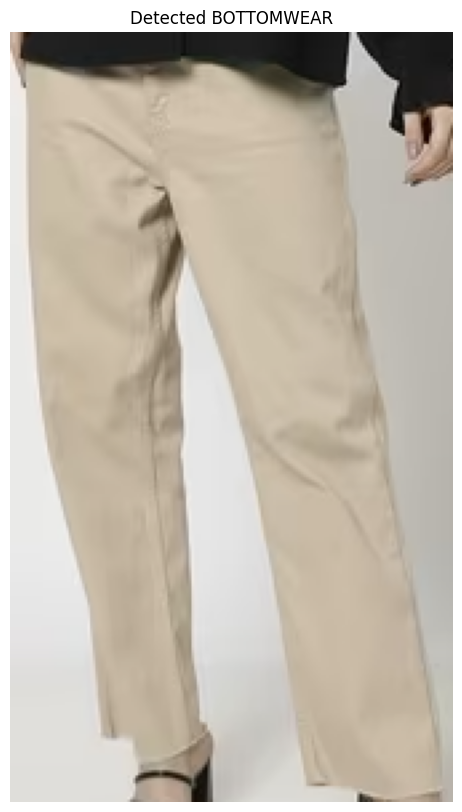

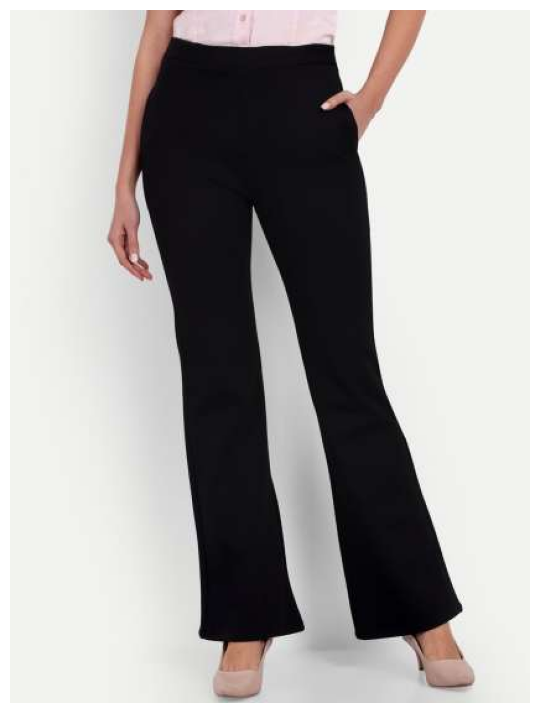

Shop Now @  https://www.myntra.com/trousers/broadstar/broadstar-women-smart-flared-high-rise-easy-wash-bootcut-trousers/23674490/buy


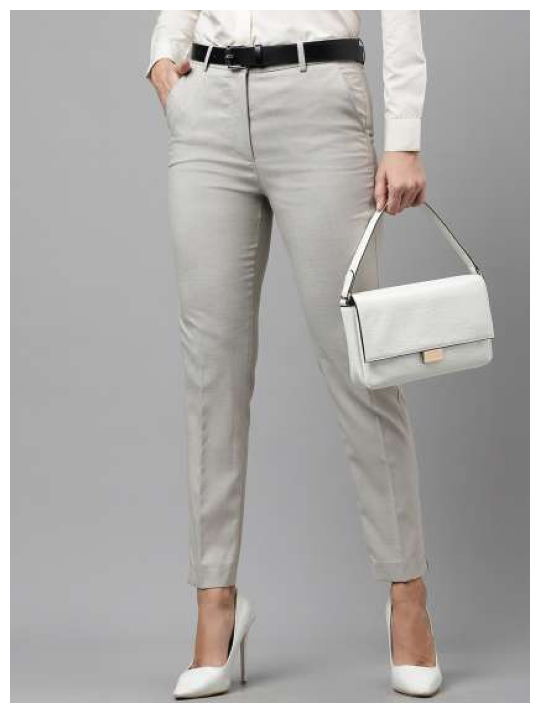

Shop Now @  https://www.myntra.com/trousers/hancock/hancock-women-slim-fit-high-rise-wrinkle-free-elastane-and-stretchable-formal-trousers/25769680/buy


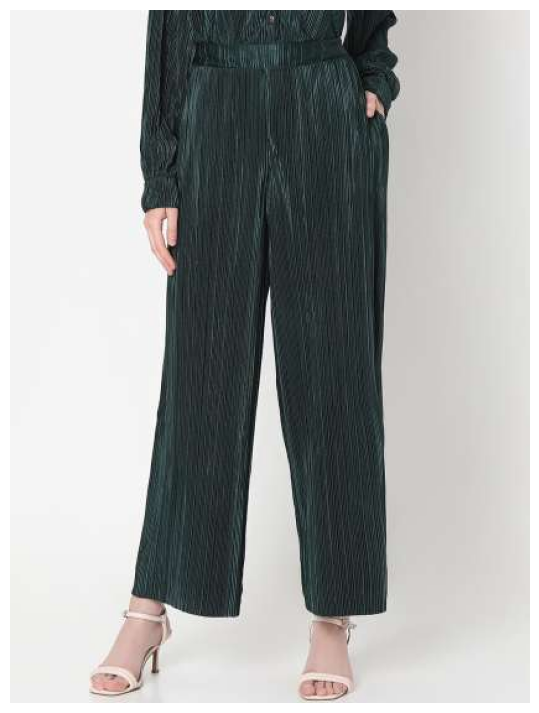

Shop Now @  https://www.myntra.com/trousers/vero+moda/vero-moda-women-straight-fit-high-rise-trousers/28084688/buy


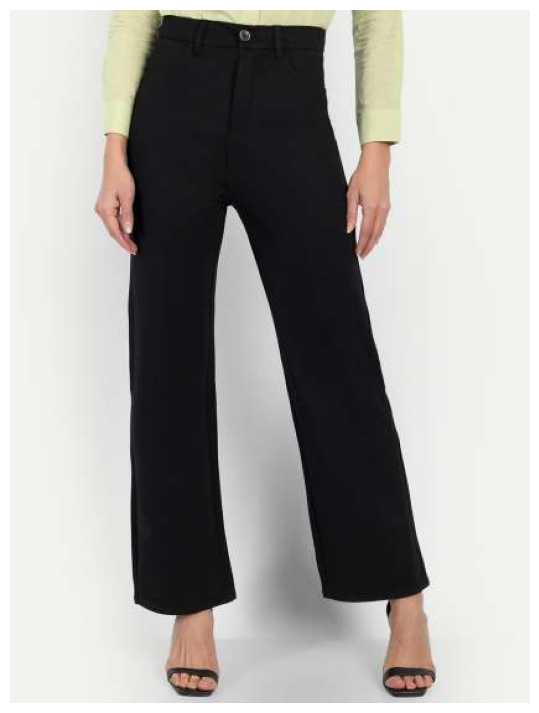

Shop Now @  https://www.myntra.com/trousers/next+one/next-one-women-smart-straight-fit-high-rise-stretchable-knitted-formal-trouser/27241212/buy


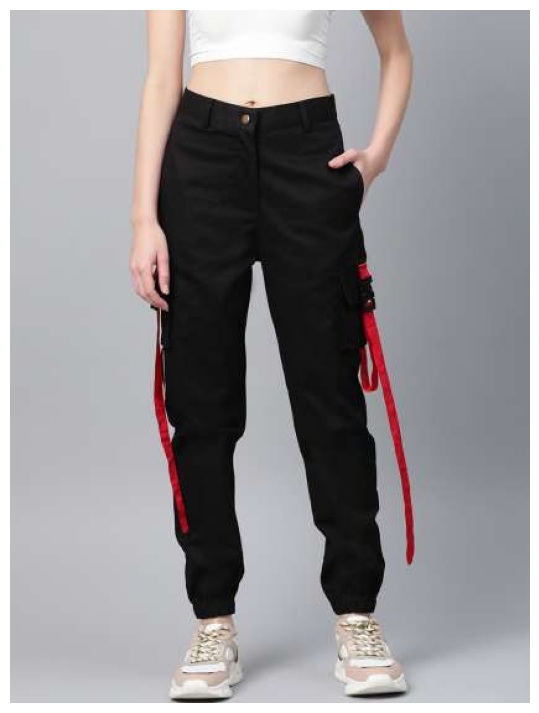

Shop Now @  https://www.myntra.com/trousers/street+9/street-9-women-black-cargos/12277604/buy


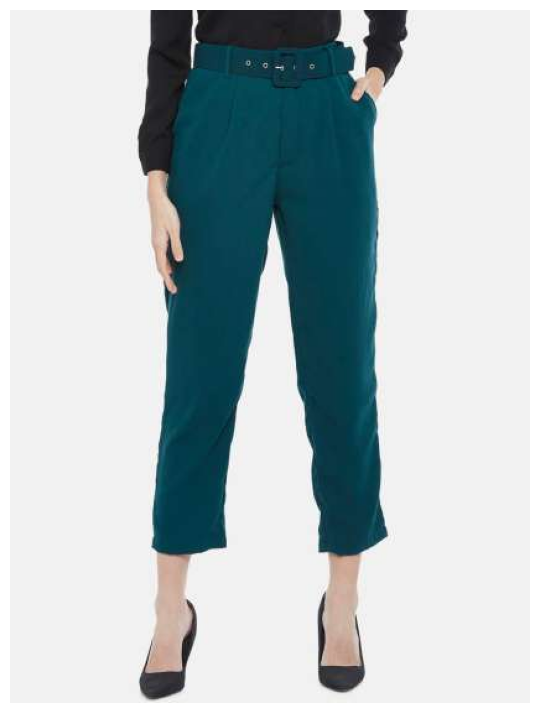

Shop Now @  https://www.myntra.com/trousers/annabelle+by+pantaloons/annabelle-by-pantaloons-women-teal-tapered-fit-high-rise-pleated-trousers/17302328/buy


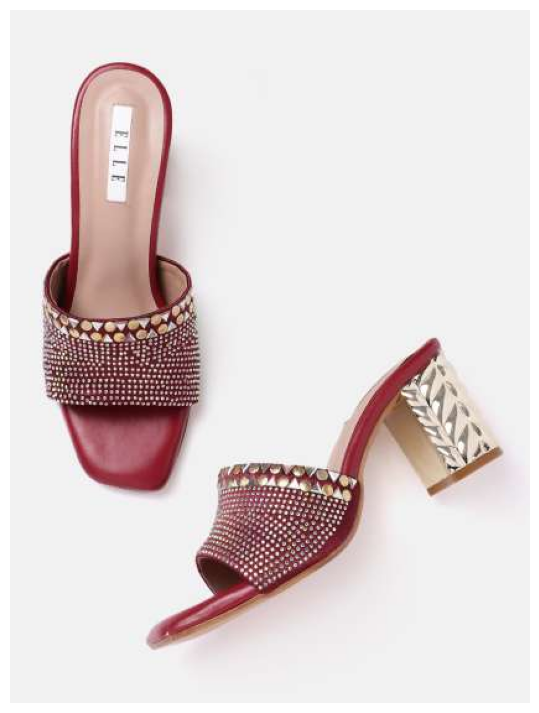

Shop Now @  https://www.myntra.com/heels/elle/elle-women-stones-embellished-party-block-heels/22722062/buy


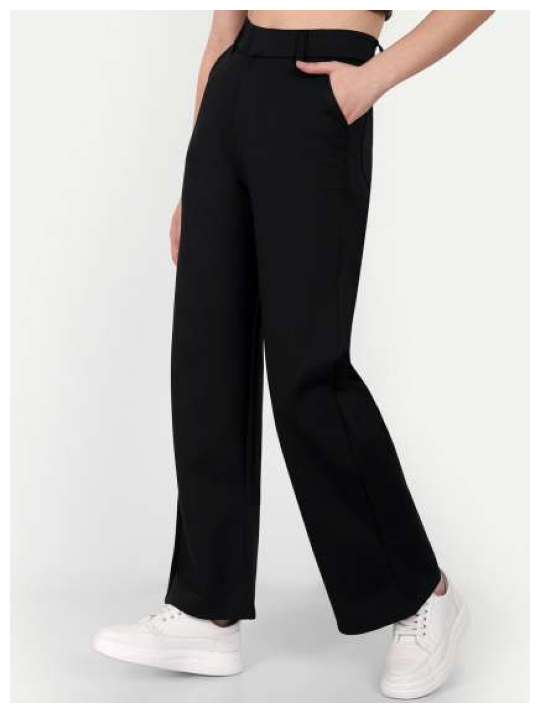

Shop Now @  https://www.myntra.com/trousers/broadstar/broadstar-women-smart-flat-front-high-rise-wide-leg-stretchable-parallel-trousers/27239706/buy


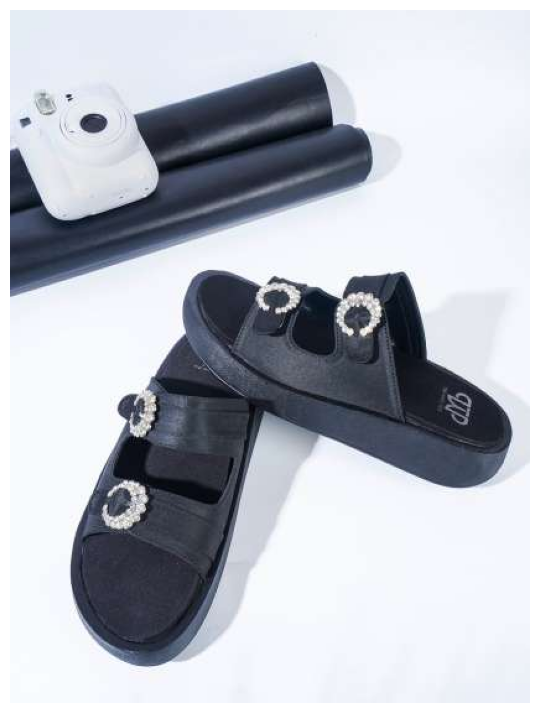

Shop Now @  https://www.myntra.com/heels/the+white+pole/the-white-pole-embellished-party-platform-heels/26156862/buy


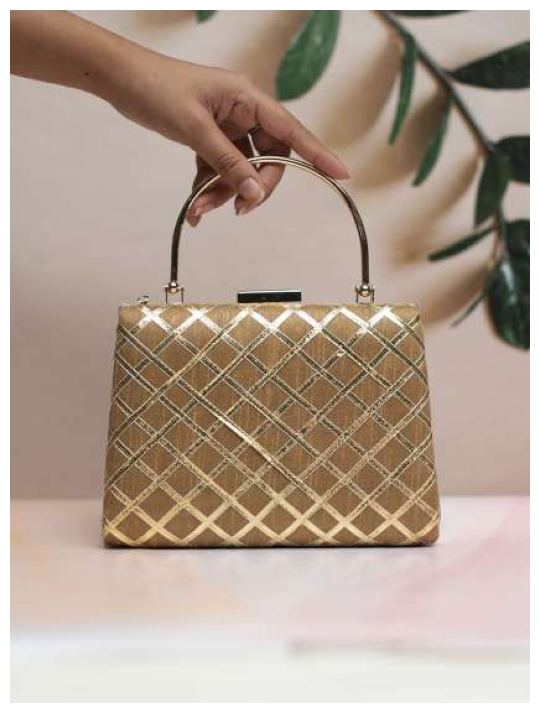

Shop Now @  https://www.myntra.com/clutches/artklim/artklim-embellished-gota-patti-fabric-party-box-clutch/29767622/buy


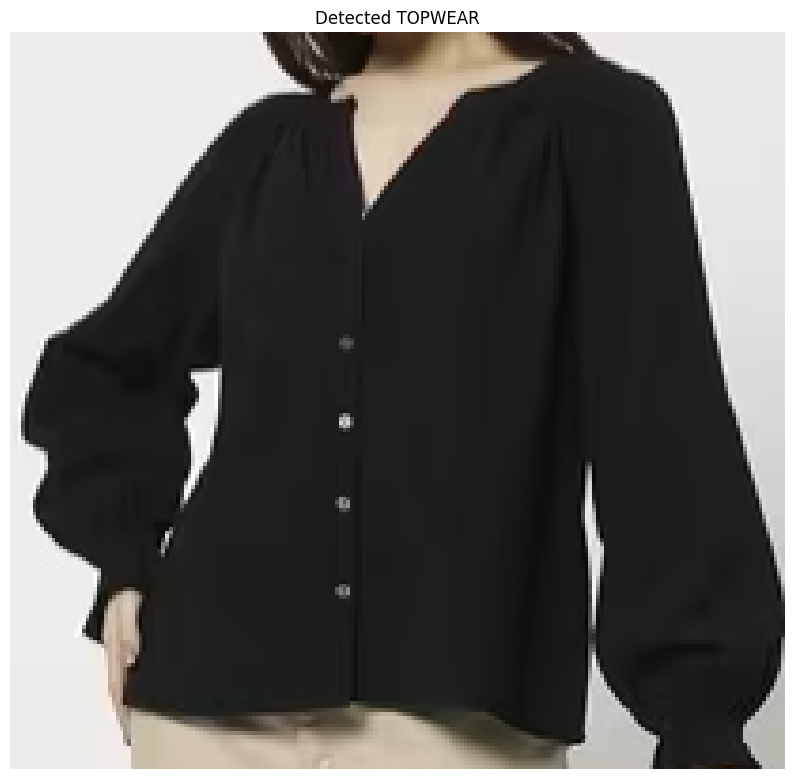

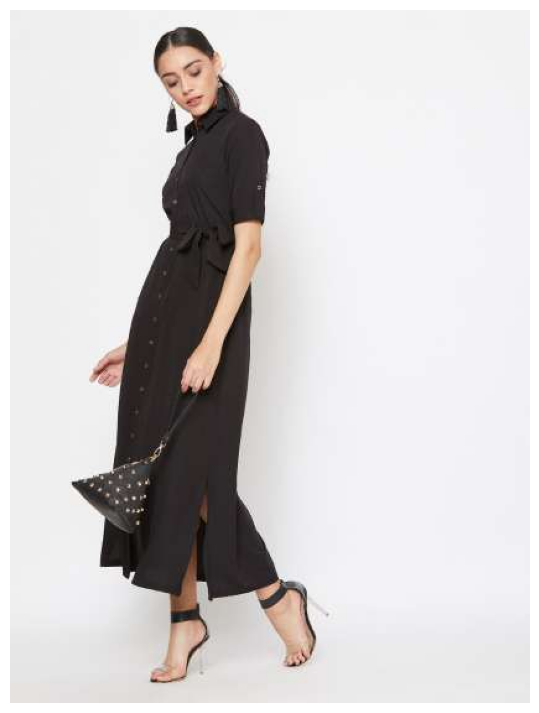

Shop Now @  https://www.myntra.com/dresses/uptownie+lite/uptownie-lite-women-button-down-shirt-maxi-dress/11511486/buy


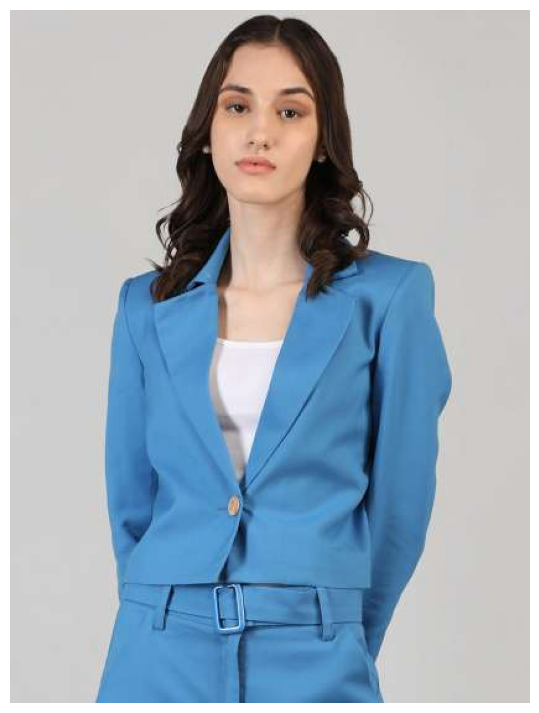

Shop Now @  https://www.myntra.com/blazers/dlanxa/dlanxa-women-single-breasted-formal-blazer/21042062/buy


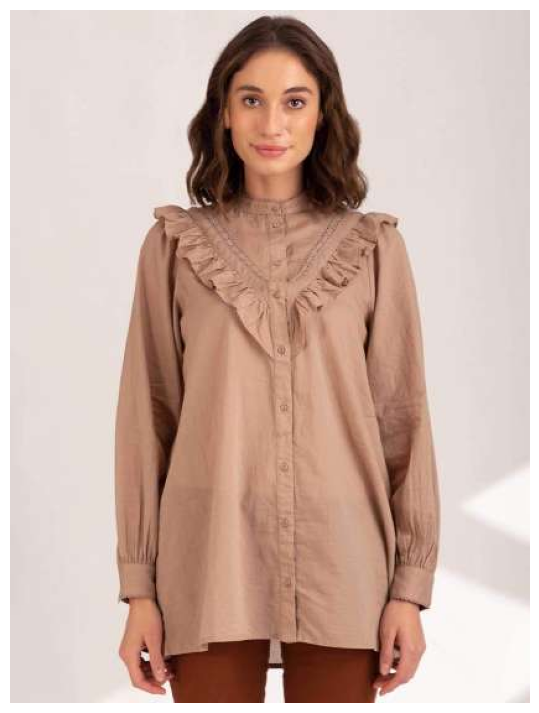

Shop Now @  https://www.myntra.com/tops/b.copenhagen/b-copenhagen-beige-pure-cotton-shirt-style-top/21097576/buy


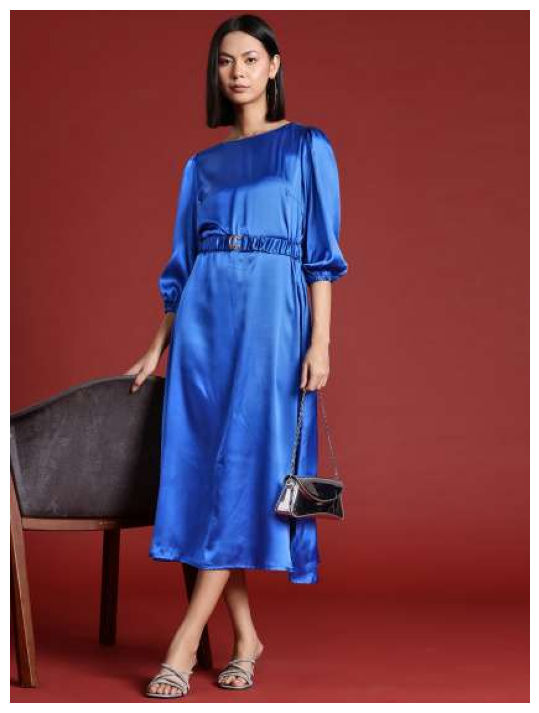

Shop Now @  https://www.myntra.com/dresses/all+about+you/all-about-you-satin-a-line-midi-dress-with-belt/26000112/buy


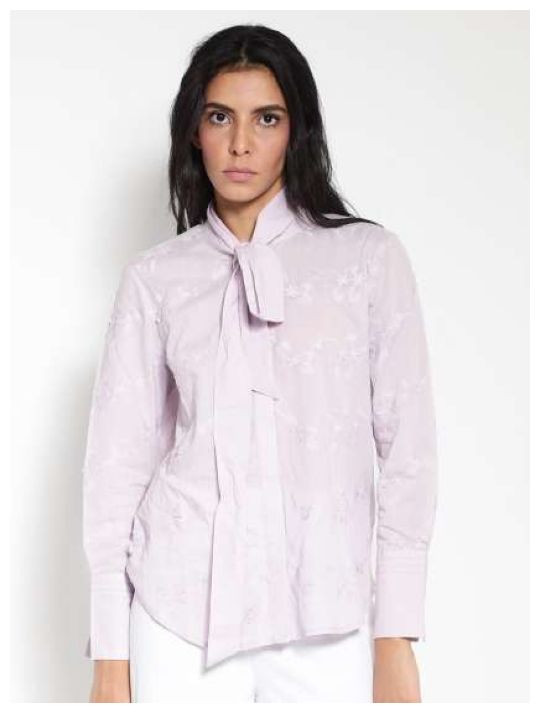

Shop Now @  https://www.myntra.com/shirts/rareism/rareism-comfort-floral-self-design-cotton-casual-shirt/29361750/buy


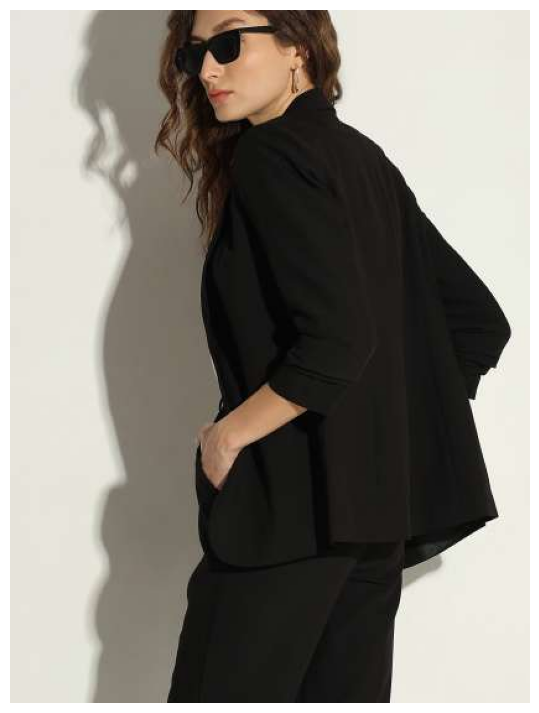

Shop Now @  https://www.myntra.com/blazers/vero+moda/vero-moda-single-breasted-formal-blazers/27260430/buy


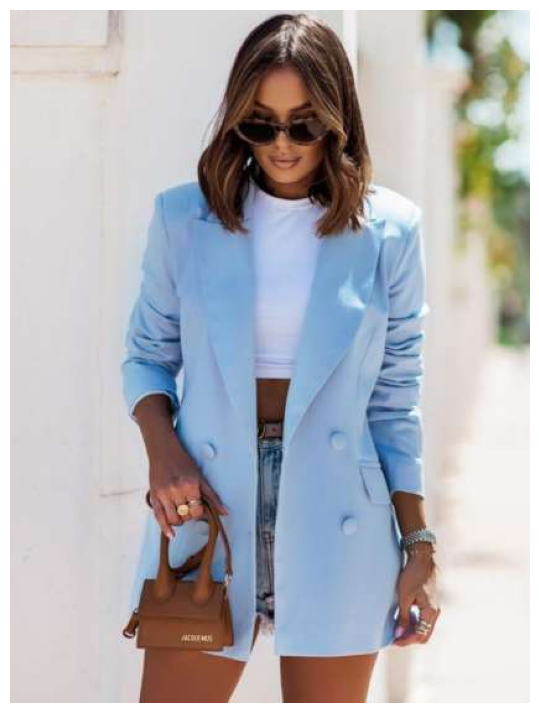

Shop Now @  https://www.myntra.com/blazers/stylecast/stylecast-blue-slim-fit-double-breasted-blazer/29308566/buy


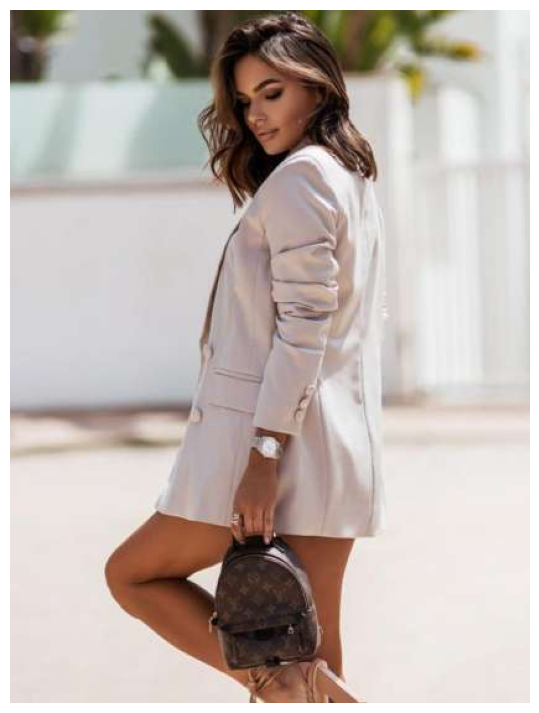

Shop Now @  https://www.myntra.com/blazers/stylecast/stylecast-beige-double-breasted-blazer/29308564/buy


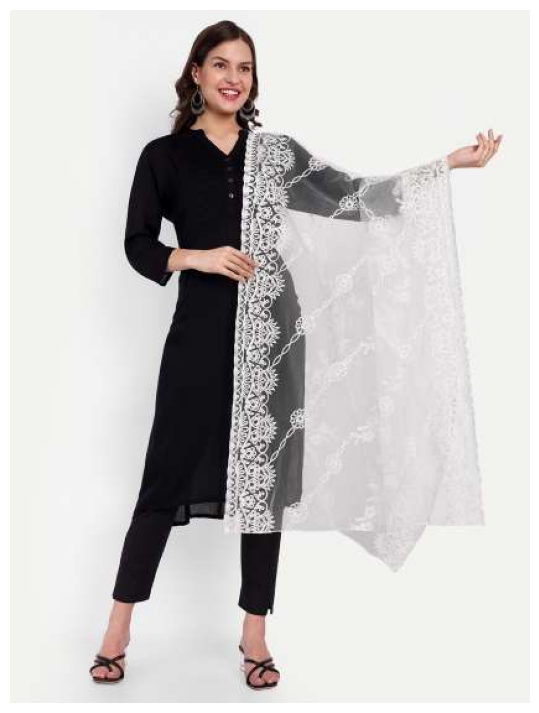

Shop Now @  https://www.myntra.com/dupatta/kalini/kalini-ethnic-motifs-embroidered-dupatta-with-thread-work/29934499/buy


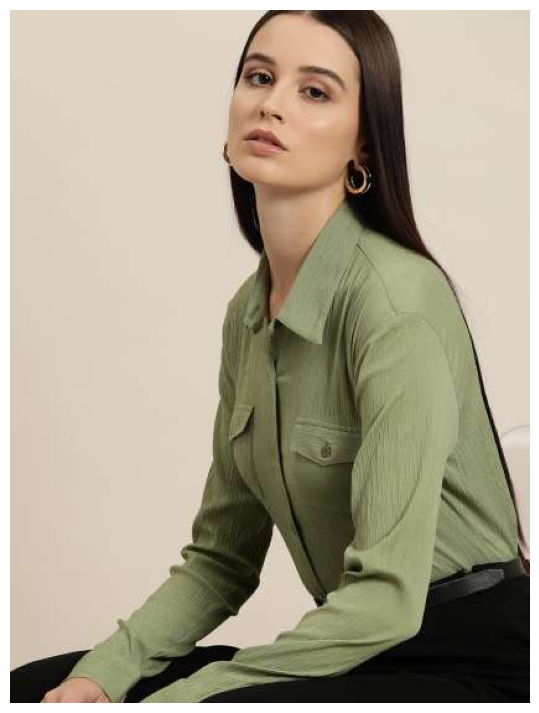

Shop Now @  https://www.myntra.com/shirts/invictus/invictus-standard-opaque-formal-shirt/25102002/buy


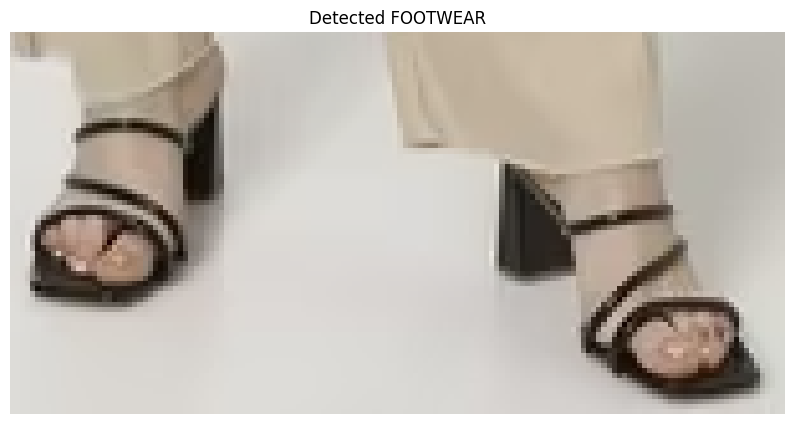

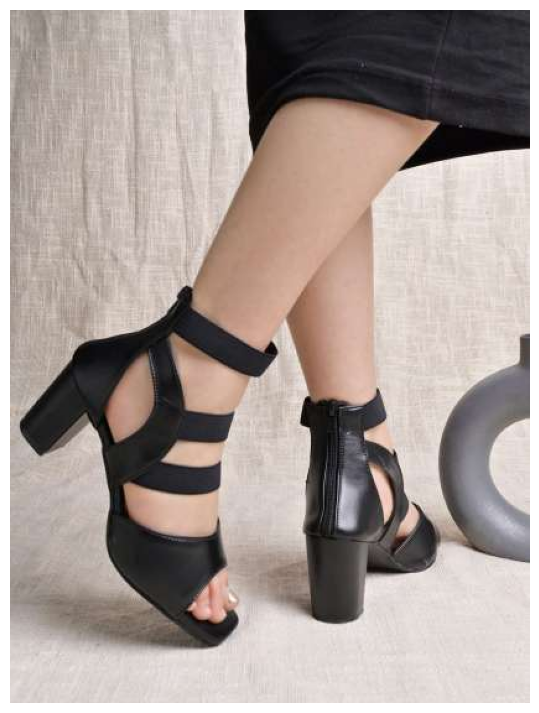

Shop Now @  https://www.myntra.com/heels/shoetopia/shoetopia-open-toe-block-heel-gladiators/29120018/buy


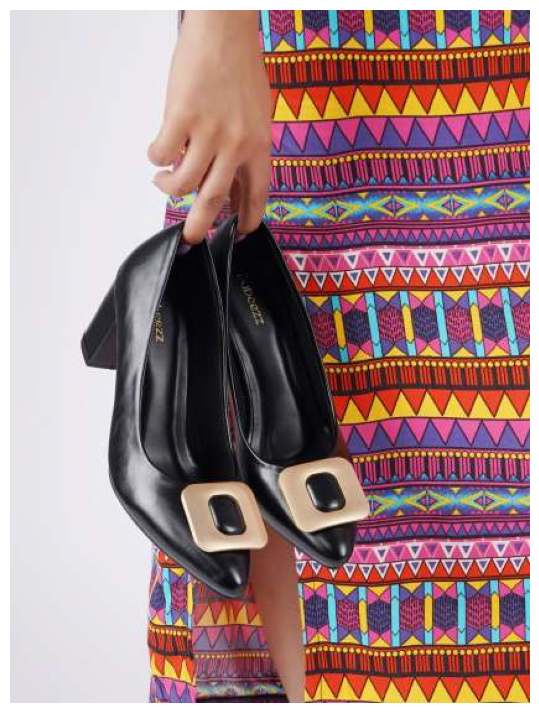

Shop Now @  https://www.myntra.com/heels/rubeezz/rubeezz-women-black-solid-party-block-pumps/17846144/buy


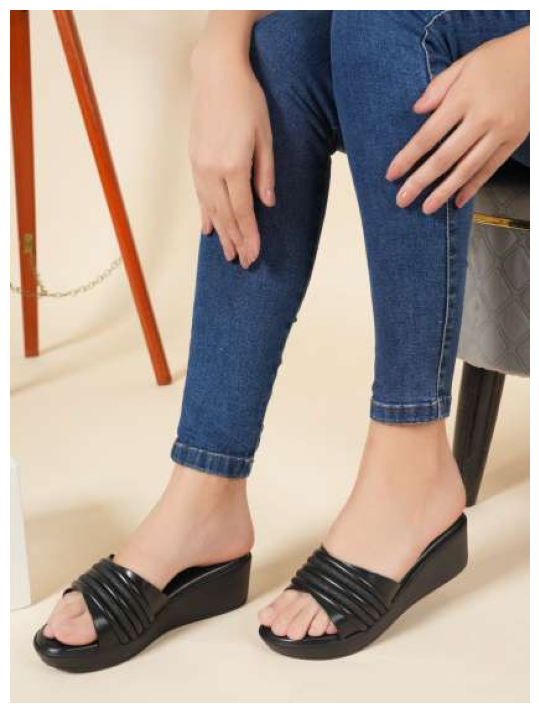

Shop Now @  https://www.myntra.com/heels/luxyfeel/luxyfeel-striped-open-toe-wedge-heels/25967118/buy


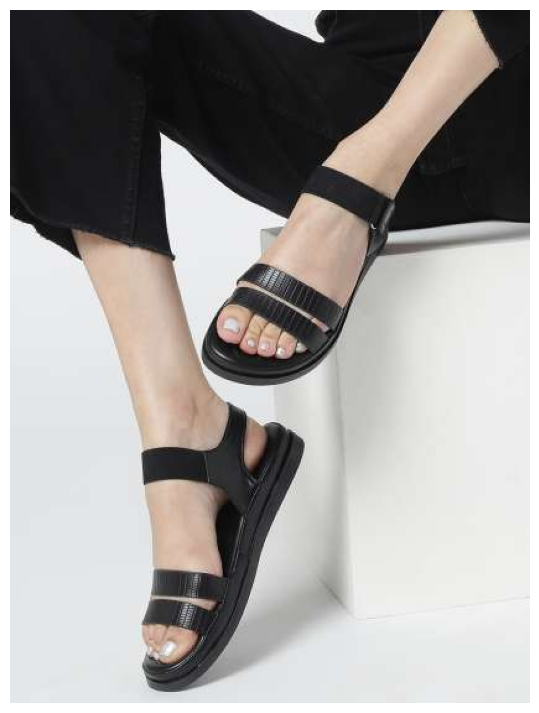

Shop Now @  https://www.myntra.com/flats/marc+loire/marc-loire-textured-open-toe-flats-with-backstrap-/24574068/buy


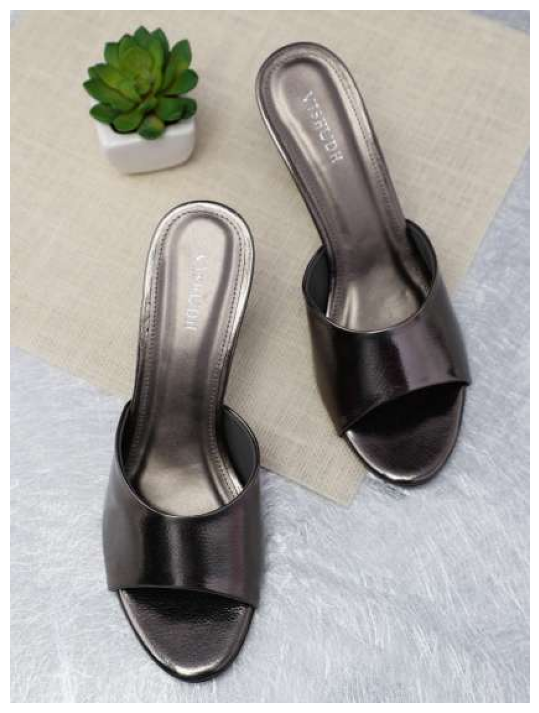

Shop Now @  https://www.myntra.com/heels/vishudh/vishudh-women-grey-solid-peep-toes/13203284/buy


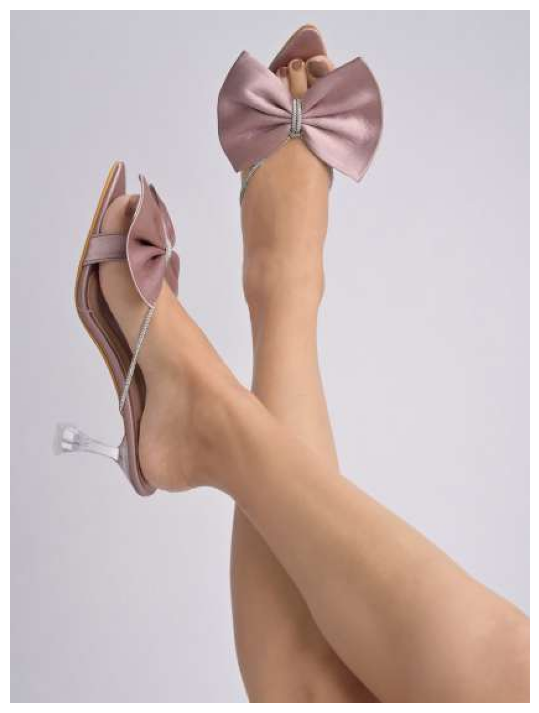

Shop Now @  https://www.myntra.com/heels/shoetopia/shoetopia-embellished-slim-heeled-pumps-with-bows/27371318/buy


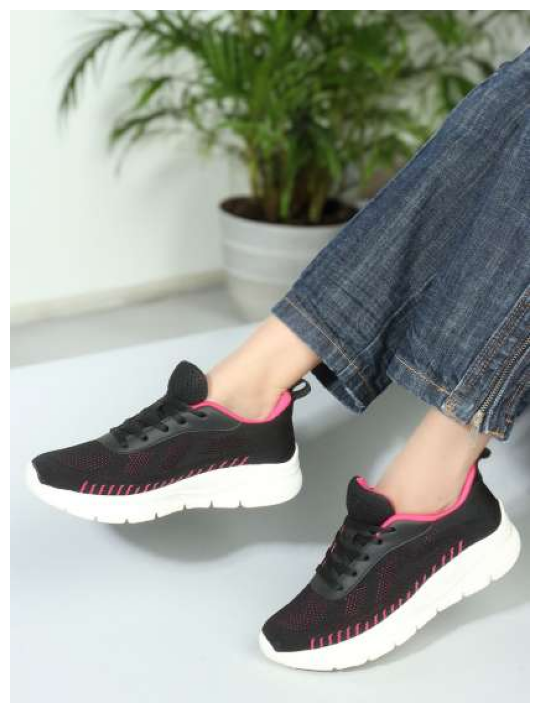

Shop Now @  https://www.myntra.com/sports-shoes/carlton+london+sports/carlton-london-sports-women-mesh-walking-shoes/29755394/buy


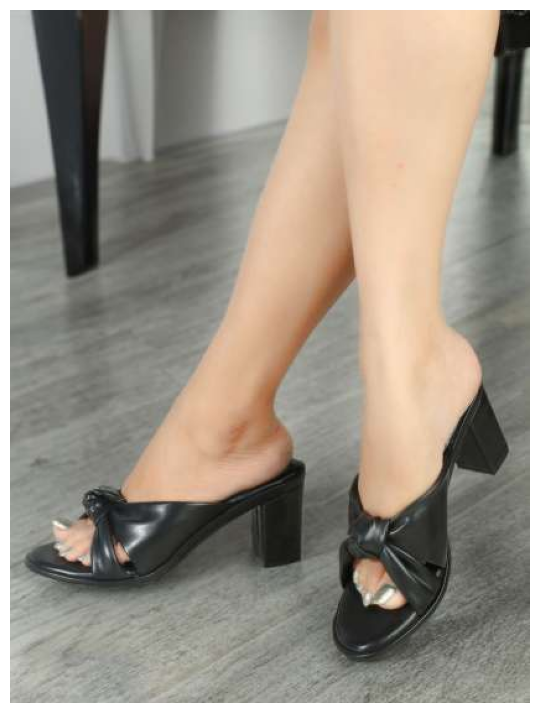

Shop Now @  https://www.myntra.com/heels/elle/elle-knotted-party-block-heels/26261094/buy


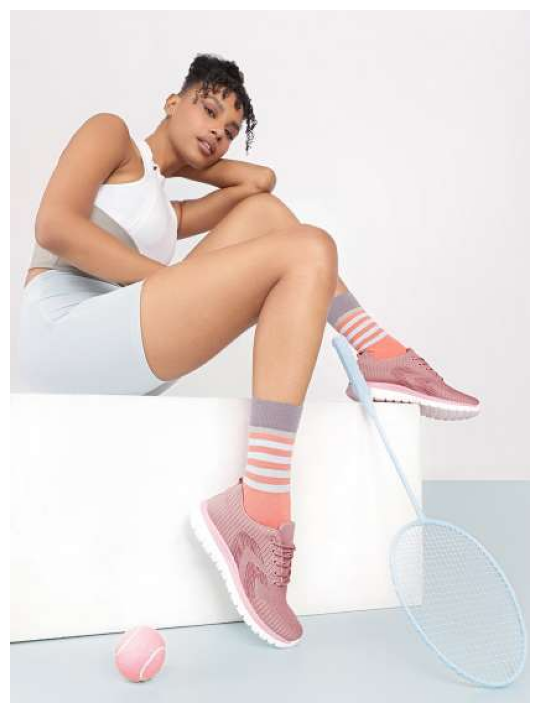

Shop Now @  https://www.myntra.com/sports-shoes/mast+%26+harbour/mast--harbour-women-running-shoes/22202528/buy


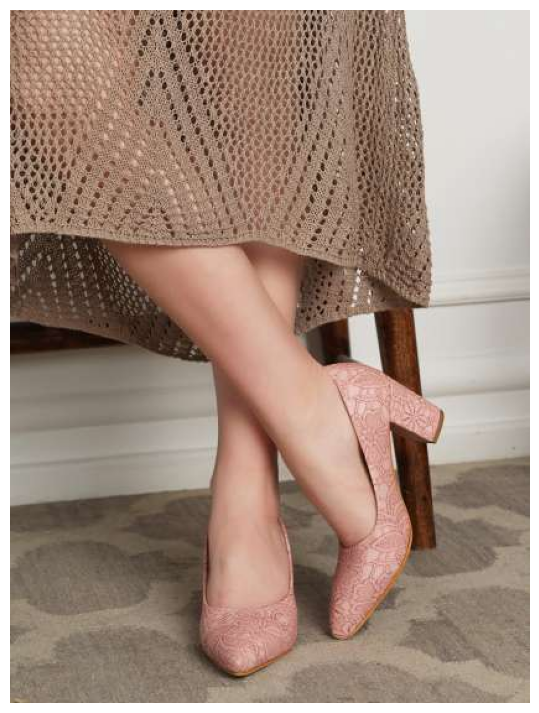

Shop Now @  https://www.myntra.com/heels/mast+%26+harbour/mast--harbour-pink-textured-round-toe-block-heels/29201742/buy


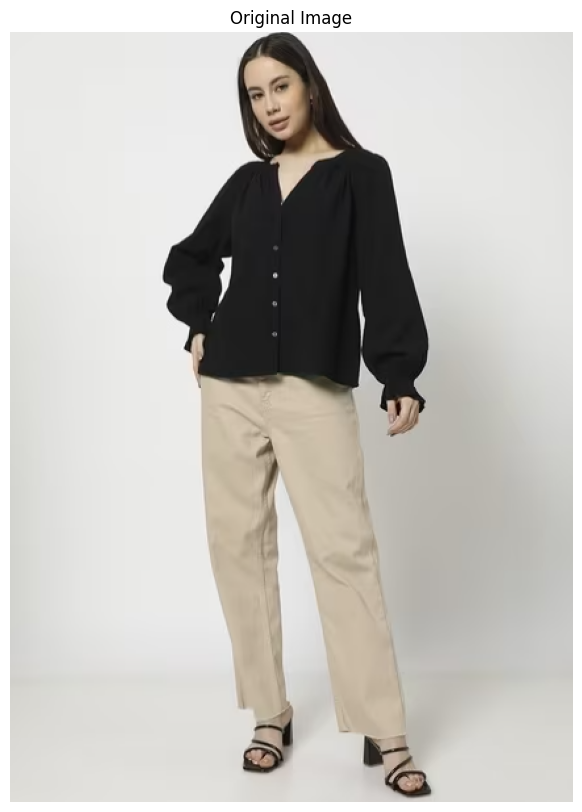

In [42]:
import copy
import requests
import matplotlib.pyplot as plt
from io import BytesIO
import cv2
from PIL import Image

class FIND_SIMILAR_PRODUCTS:
    def __init__(self, img_path, weights_path):
        self.img_path = img_path
        self.weights_path = weights_path
        self.LOADED_MODELS = None
        self.LOADED_CSVS = None
        self.preprocess = PreprocessImage()
        self.find_similar_objects = FindSimilarObjects()

    def load_models(self):
        # Load your models and store them in the class attribute
        self.LOADED_MODELS = load_models()

    def predict_gender(self):
        # Preprocess the image and predict gender
        preprocessed_img = self.preprocess.preprocess_image_forGender(self.img_path)
        gender_classifier = GenderClassification(preprocessed_img, self.LOADED_MODELS)
        return gender_classifier.predict_gender()

    def extract_objects(self):
        # Extract objects using YOLO model
        extract_obj_inst = ExtractObjects()
        return extract_obj_inst.extract_objects(self.weights_path, self.img_path)

    def preprocess_all_extracted_objects(self, output_dict):
        """
        Preprocess all image slices in the dictionary except for the 'original_image' key.
        """
        output_dict_copy = copy.deepcopy(output_dict)  # We are creating a deep copy here because we will later need these unprocessed image slices from output_dict to display the extracted objects
        for class_name, image_slice in output_dict_copy.items():
            if class_name != "original_image":
                output_dict_copy[class_name] = self.preprocess.preprocess_image_forEmbeddings(image_slice)
        return output_dict_copy

    def generate_embeddings(self, preprocessed_outputs):
        # Generate embeddings for the extracted objects
        return self.find_similar_objects.generate_embeddings(preprocessed_outputs, self.LOADED_MODELS)

    def load_CSVs(self):
        # Load necessary CSVs for finding similar objects
        self.LOADED_CSVS = load_CSVs()

    def find_similar_embeddings(self, embeddings_extractedobjects, predicted_gender):
        # Find similar objects based on the embeddings and gender
        return self.find_similar_objects.find_similar_embeddings(embeddings_extractedobjects, predicted_gender, self.LOADED_CSVS)

    def display_image(self, image, title="Image"):
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(10, 10))
        plt.imshow(image_rgb)
        plt.title(title)
        plt.axis('off')
        plt.show()

    def show_similar_items(self, output, similar_items_urls):
        """Display the original image, detected objects, and recommended similar products."""
        for class_name, img_slice in output.items():
            if class_name == "original_image":
                self.display_image(img_slice, title="Original Image")
            else:
                self.display_image(img_slice, title=f"Detected {class_name}")
                class_name = class_name.lower()  # Convert key to lowercase
                image_product_urls = similar_items_urls[class_name]

                for index, row in image_product_urls.iterrows():
                    plt.figure(figsize=(9, 9))

                    # Download and display the image from the URL
                    response = requests.get(row["image_url"])
                    image = Image.open(BytesIO(response.content))
                    plt.imshow(image)
                    plt.axis("off")
                    plt.show()

                    # Also print product URL
                    print("Shop Now @ ", row["product_url"])
                    print(254 * "=")

    def run(self):
        # Step 1: Load models
        self.load_models()

        # Step 2: Predict gender
        predicted_gender = self.predict_gender()
        print(f"Predicted Gender: {predicted_gender}")

        # Step 3: Extract objects from the image using YOLO model
        outputs = self.extract_objects()

        # Step 4: Preprocess extracted objects for embedding generation
        preprocessed_outputs = self.preprocess_all_extracted_objects(outputs)

        # Step 5: Generate embeddings for the extracted objects
        embeddings_extractedobjects = self.generate_embeddings(preprocessed_outputs)

        # Step 6: Load necessary CSVs
        self.load_CSVs()

        # Step 7: Find similar objects based on embeddings and gender
        similar_objects_urls = self.find_similar_embeddings(embeddings_extractedobjects, predicted_gender)

        # Step 8: Display the results
        self.show_similar_items(outputs, similar_objects_urls)


# Lets use the instance of class we wrote above to find similar items
img_path = "./Examples/Test5.png"
weights_path = "./runs/detect/yolo_small_train/weights/best.pt"
finder = FIND_SIMILAR_PRODUCTS(img_path, weights_path)
finder.run()


1/1 [==============================] - 0s 28ms/step
Predicted Gender: male

0: 512x352 1 TOPWEAR, 1 BOTTOMWEAR, 1 FOOTWEAR, 1 EYEWEAR, 207.8ms
Speed: 0.0ms preprocess, 207.8ms inference, 8.6ms postprocess per image at shape (1, 3, 512, 352)


100%|██████████| 1837/1837 [00:01<00:00, 1079.36it/s]


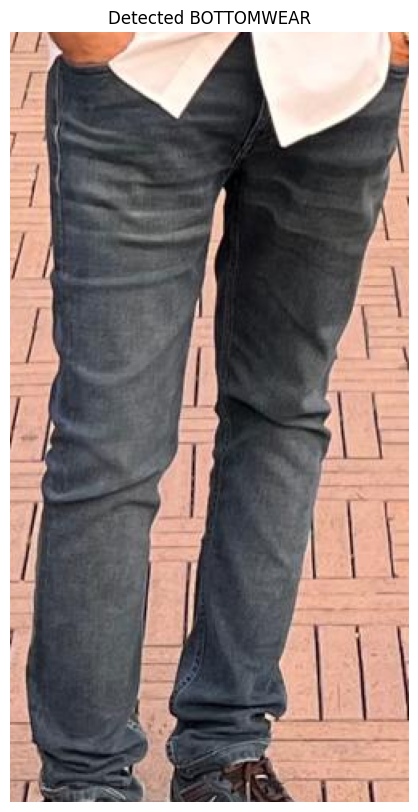

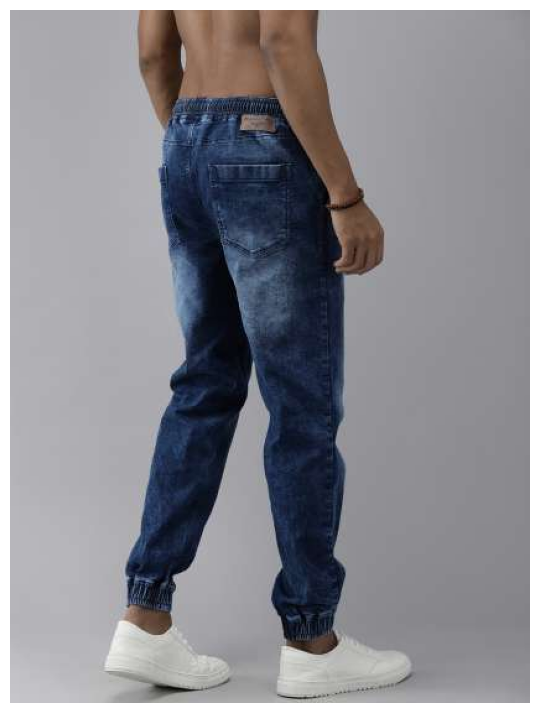

Shop Now @  https://www.myntra.com/trousers/roadster/roadster-men-navy-blue-solid-slim-fit-stretchable-denim-joggers/19699222/buy


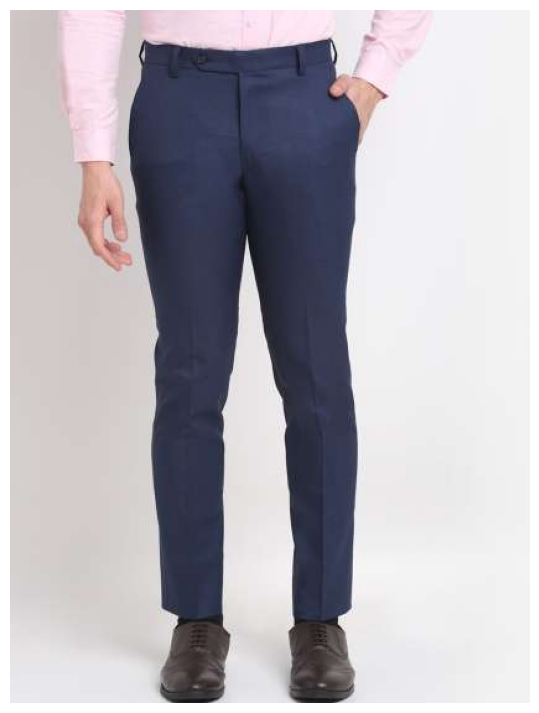

Shop Now @  https://www.myntra.com/trousers/ennoble/ennoble-men-tapered-fit-formal-trousers/21550732/buy


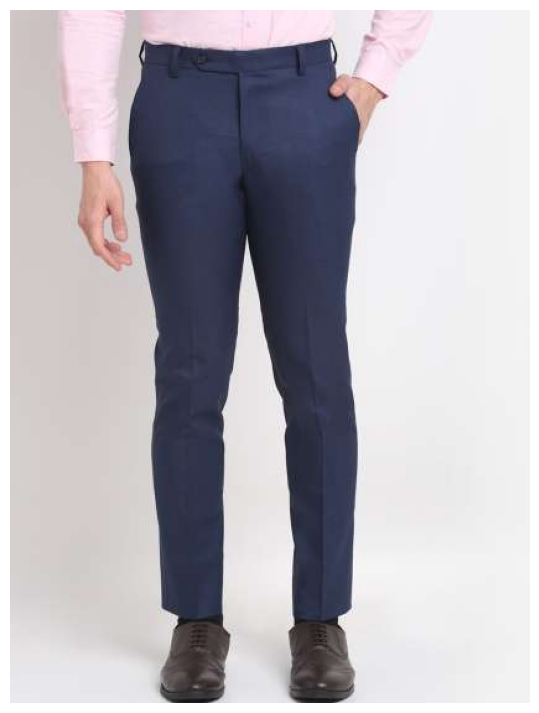

Shop Now @  https://www.myntra.com/trousers/ennoble/ennoble-men-tapered-fit-formal-trousers/21550732/buy


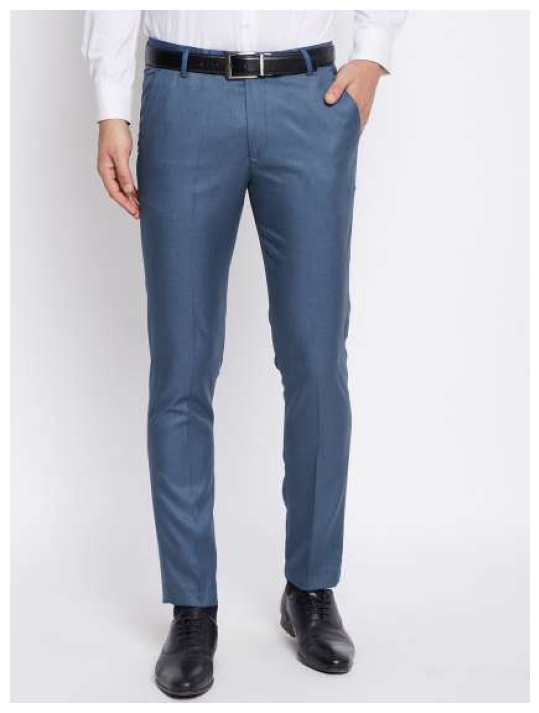

Shop Now @  https://www.myntra.com/trousers/vei+sastre/vei-sastre-men-blue-smart-slim-fit-formal-trouser/20737582/buy


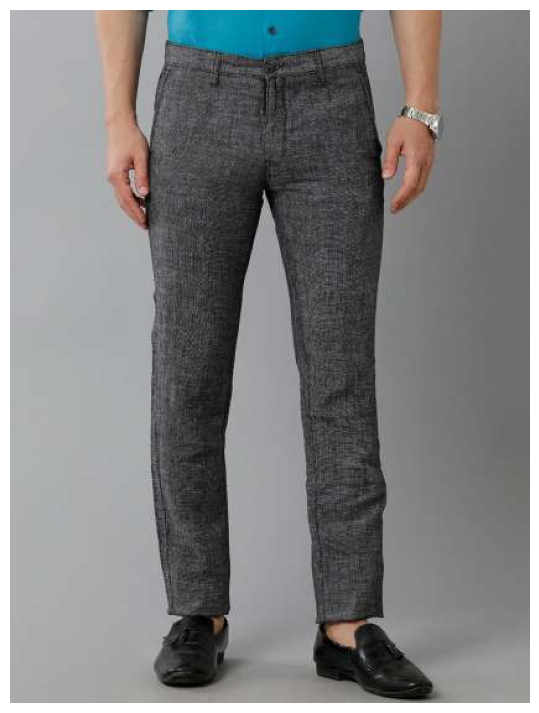

Shop Now @  https://www.myntra.com/trousers/linen+club/linen-club-men-self-designed-mid-rise-slim-fit-pure-linen-trousers/22778730/buy


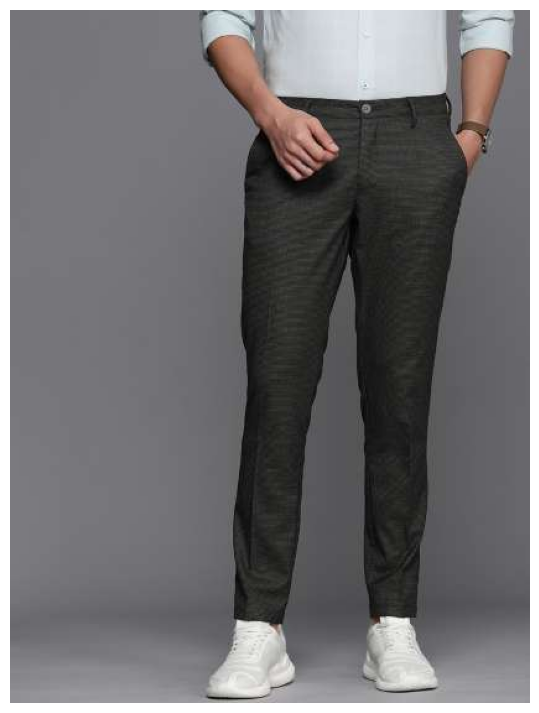

Shop Now @  https://www.myntra.com/trousers/louis+philippe+ath.work/louis-philippe-athwork-men-textured-tapered-fit-smart-casual-trousers/24871480/buy


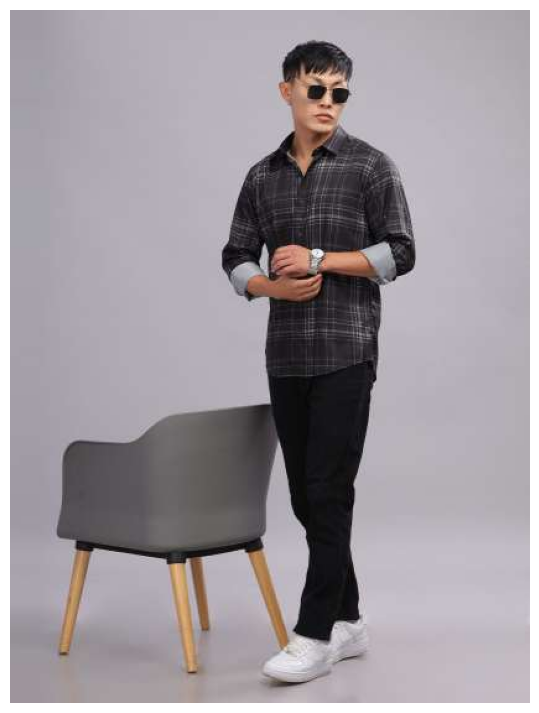

Shop Now @  https://www.myntra.com/shirts/paul+street/paul-street-men-standard-slim-fit-tartan-checks-opaque-checked-party-shirt/29671440/buy


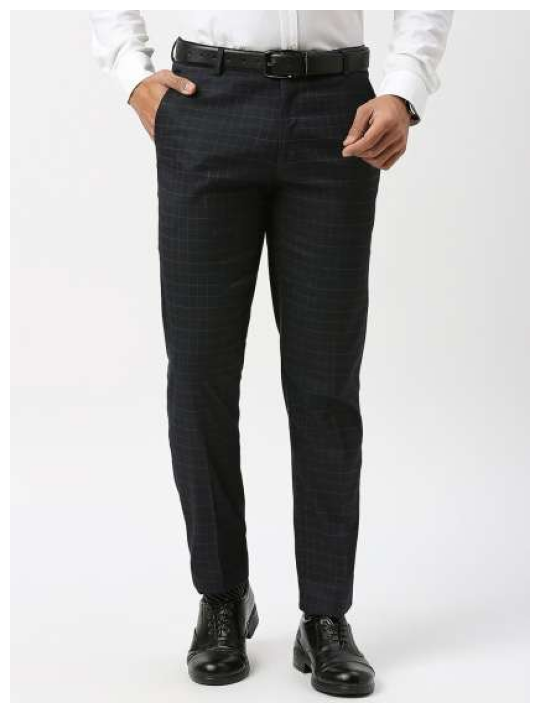

Shop Now @  https://www.myntra.com/trousers/berkshire/berkshire-men-smart-slim-fit-mid-rise-checked-easy-wash-formal-trousers/27657712/buy


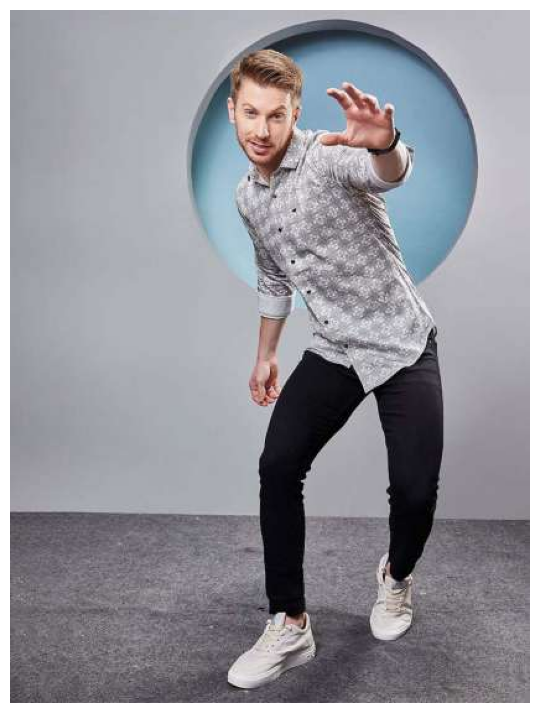

Shop Now @  https://www.myntra.com/shirts/almaty/almaty-men-comfort-slim-fit-opaque-printed-party-shirt/27980458/buy


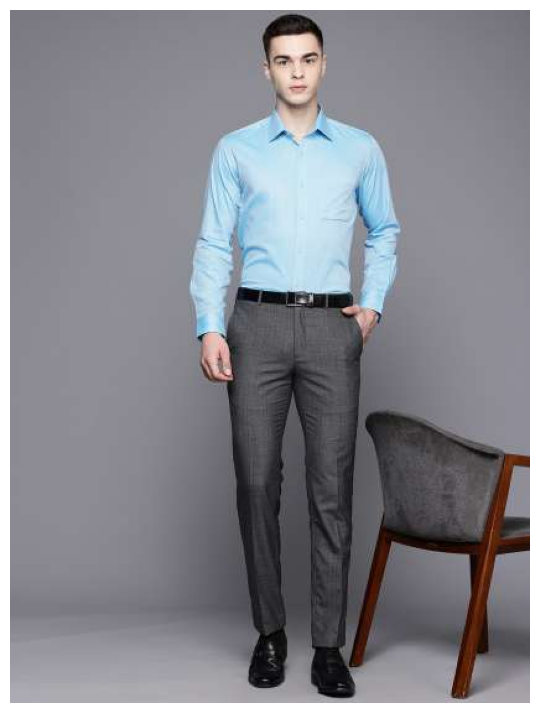

Shop Now @  https://www.myntra.com/trousers/raymond/raymond-men-checked-slim-fit-trousers/29315276/buy


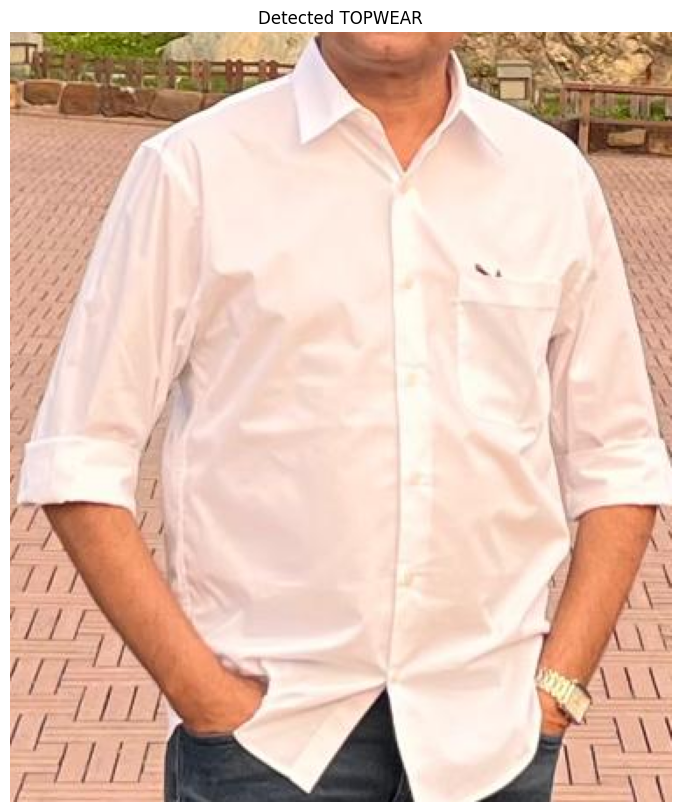

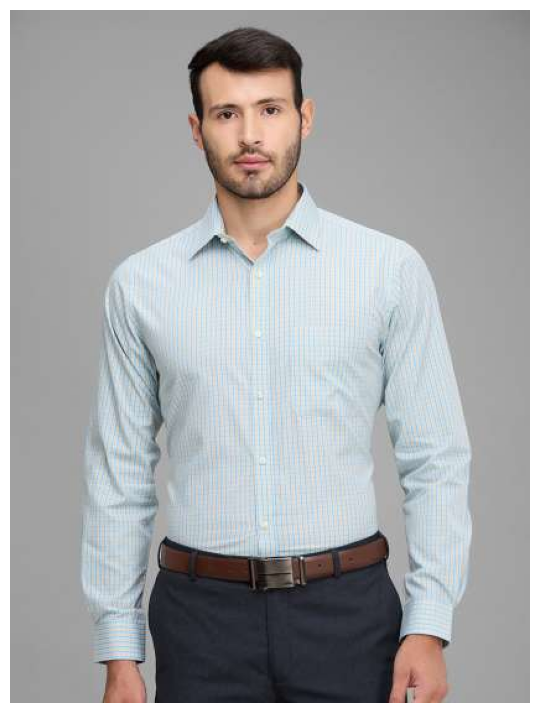

Shop Now @  https://www.myntra.com/shirts/raymond/raymond-slim-fit-checked-spread-collar-cotton-formal-shirt/29353762/buy


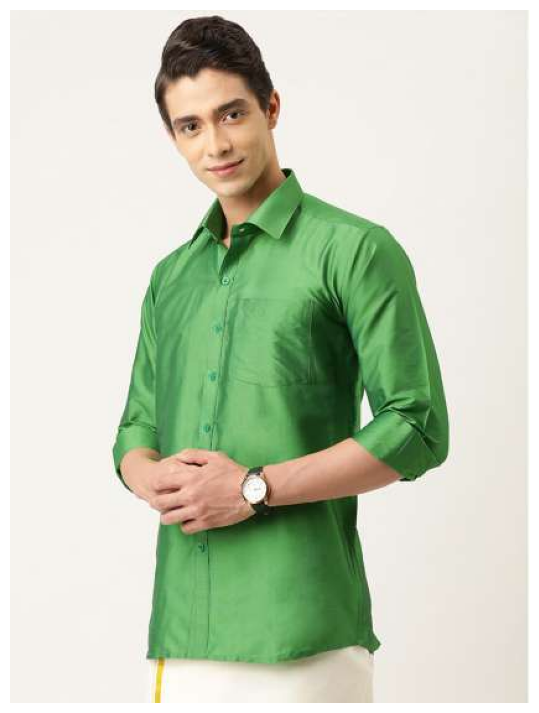

Shop Now @  https://www.myntra.com/shirts/thangamagan/thangamagan-spread-collar-party-shirt/22238210/buy


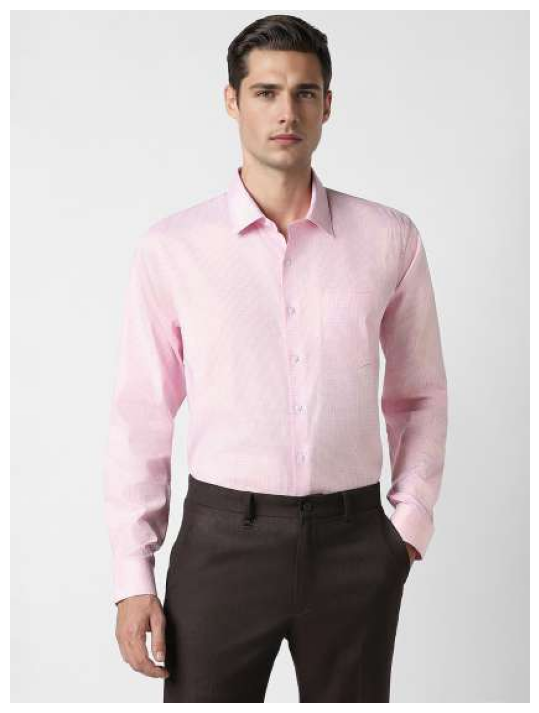

Shop Now @  https://www.myntra.com/shirts/van+heusen/van-heusen-spread-collar-cotton-formal-shirt/27470218/buy


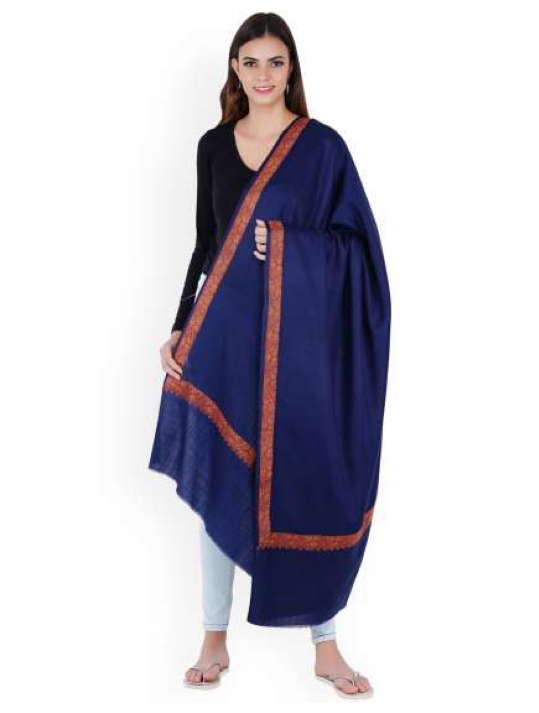

Shop Now @  https://www.myntra.com/shawl/muffly/muffly-blue-embroidered-woolen-shawl/18543802/buy


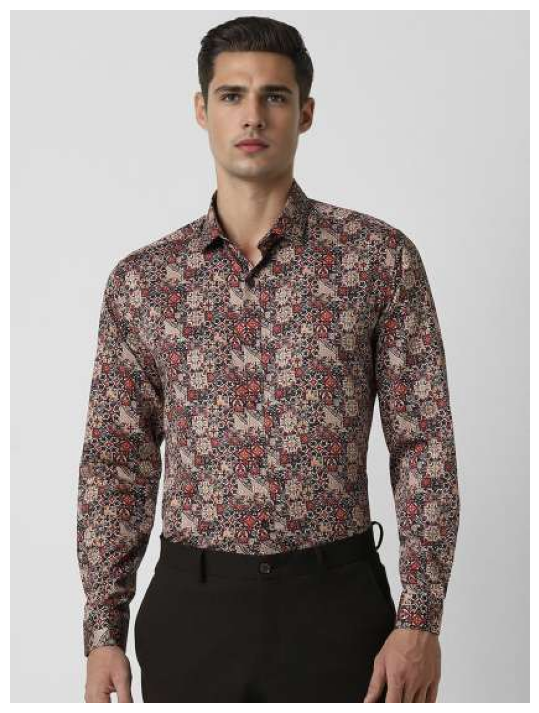

Shop Now @  https://www.myntra.com/shirts/v+dot/v-dot-men-slim-fit-floral-cotton-printed-party-shirt/28745930/buy


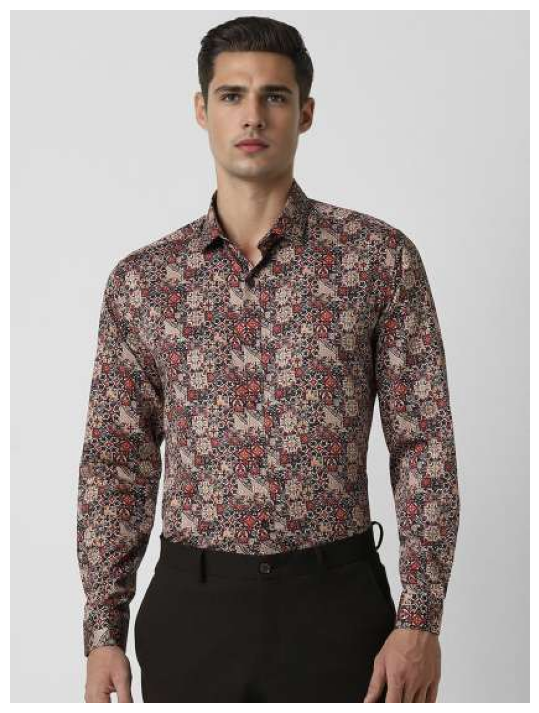

Shop Now @  https://www.myntra.com/shirts/v+dot/v-dot-slim-fit-floral-cotton-printed-party-shirt/28745932/buy


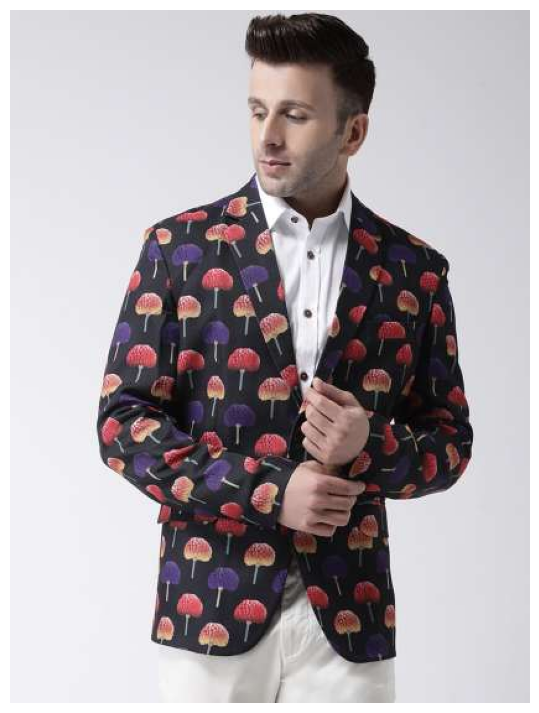

Shop Now @  https://www.myntra.com/blazers/hangup+trend/hangup-trend-men-black--purple-printed-regular-fit-single-breasted-party-blazers/19888172/buy


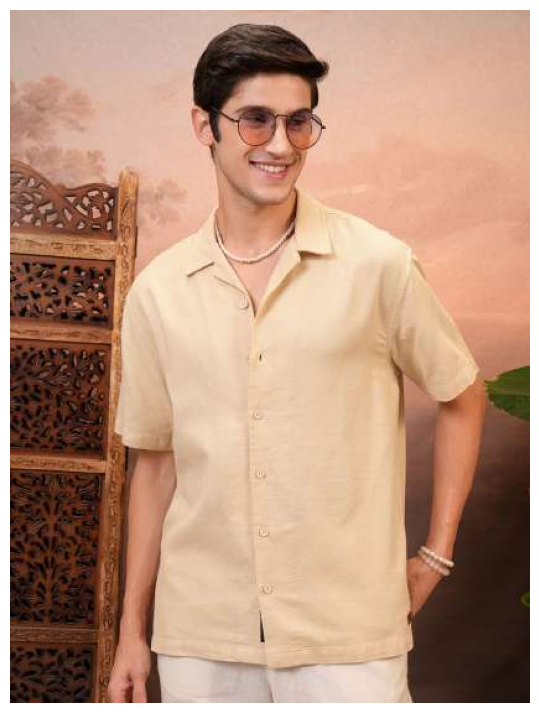

Shop Now @  https://www.myntra.com/shirts/locomotive/locomotive-men-opaque-casual-shirt/28901214/buy


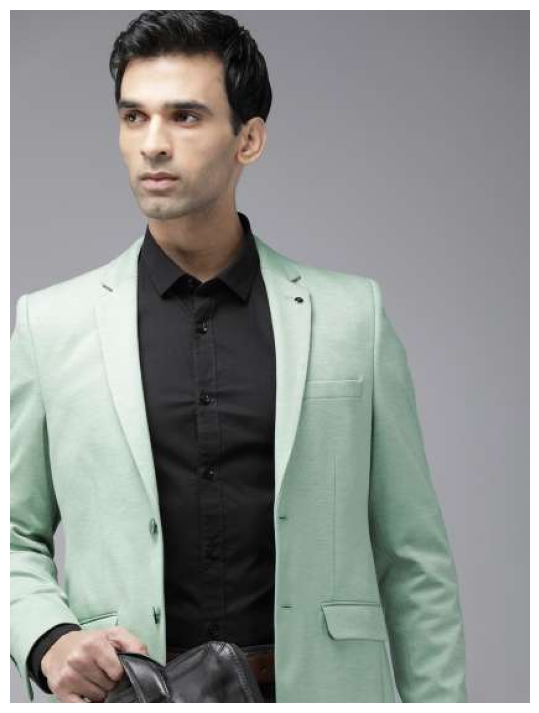

Shop Now @  https://www.myntra.com/blazers/van+heusen/van-heusen-ultra-slim-fit-single-breasted-formal-blazer/25100024/buy


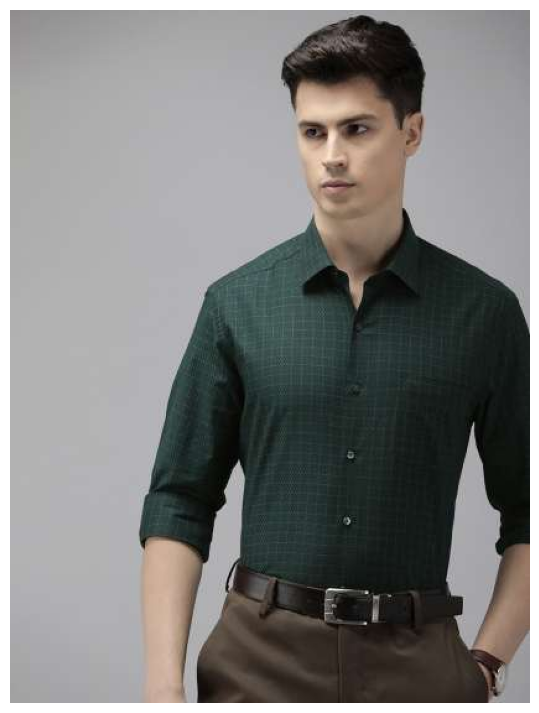

Shop Now @  https://www.myntra.com/shirts/arrow/arrow-men-original-slim-fit-grid-tattersall-checks-pure-cotton-formal-shirt/27481652/buy


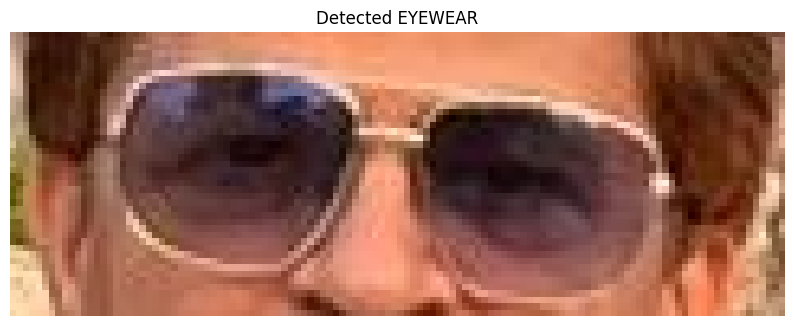

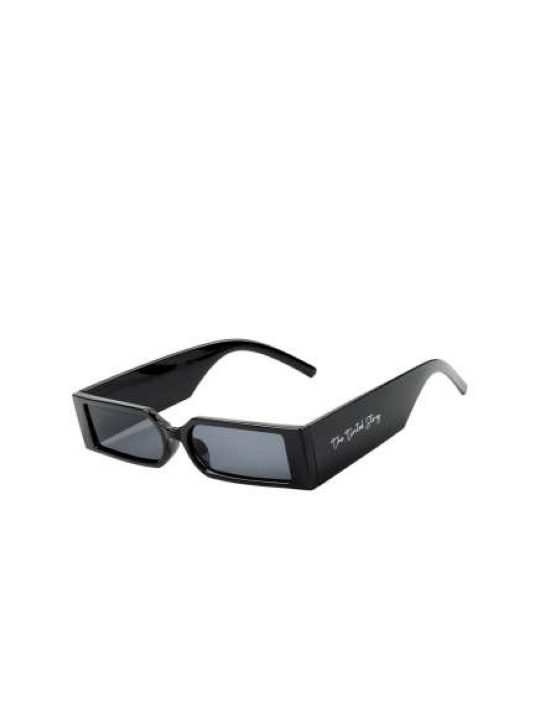

Shop Now @  https://www.myntra.com/sunglasses/the+tinted+story/the-tinted-story-unisex-rectangle-sunglasses-with-uv-protected-lens-tts171-blr/29061814/buy


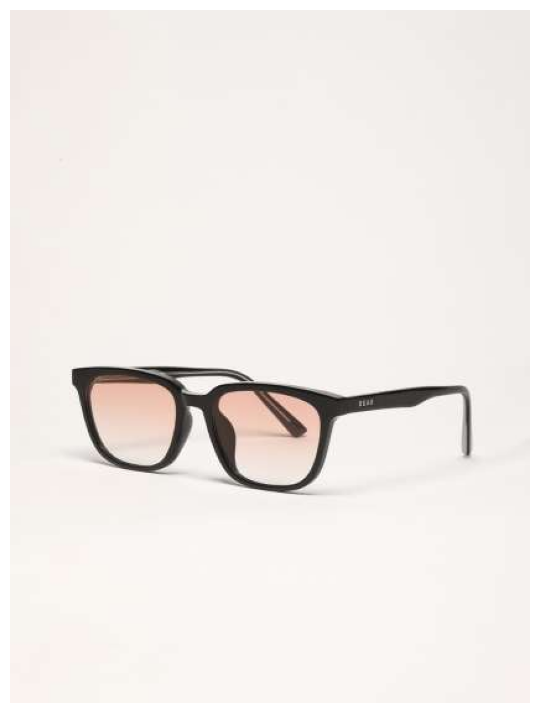

Shop Now @  https://www.myntra.com/sunglasses/the+bear+house/the-bear-house-men-full-rim-wayfarer-sunglasses-bsg-boder-bk/28532798/buy


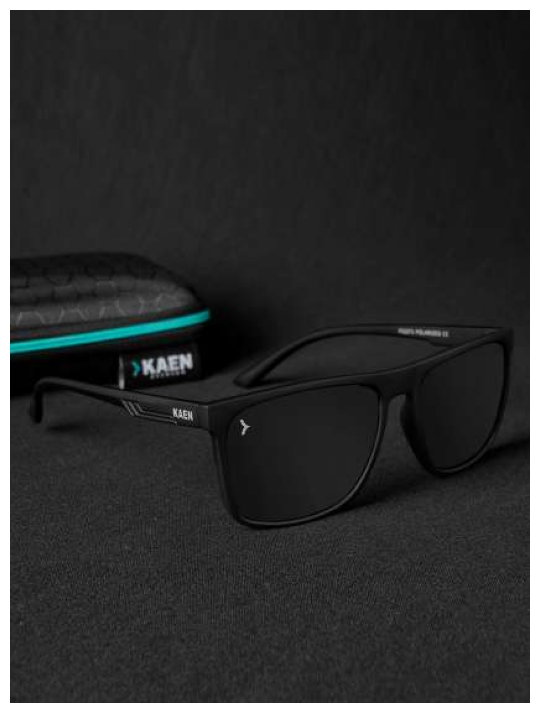

Shop Now @  https://www.myntra.com/sunglasses/kaen+eyewear/kaen-eyewear-unisex-square-sunglasses-with-polarised-lens-kaskoda/26705234/buy


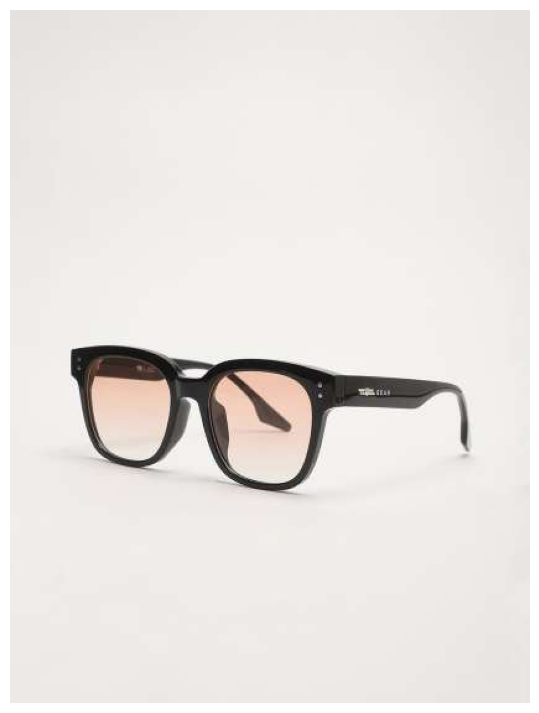

Shop Now @  https://www.myntra.com/sunglasses/the+bear+house/the-bear-house-men-oversized-sunglasses-bsg-kristian-bk/28308008/buy


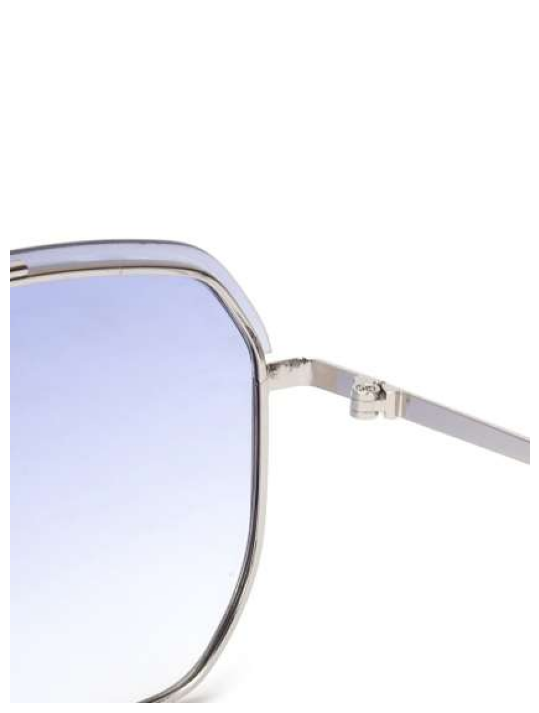

Shop Now @  https://www.myntra.com/sunglasses/hashtag+eyewear/hashtag-eyewear-men-rectangle-sunglasses-with-uv-protected-lens/28927946/buy


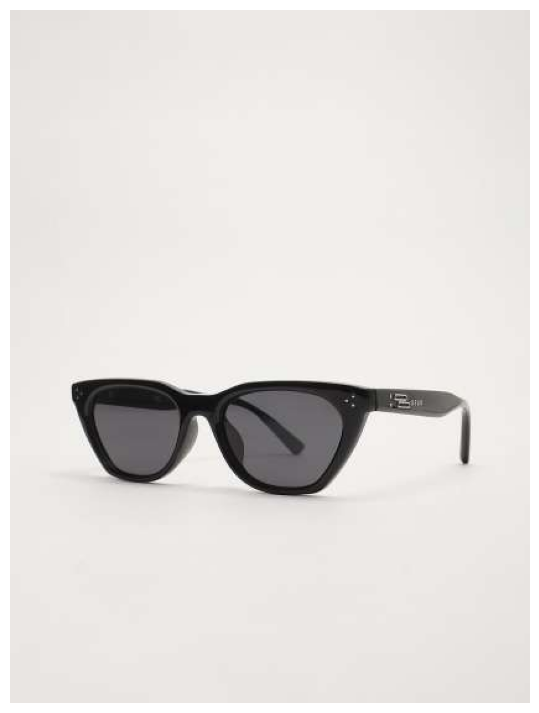

Shop Now @  https://www.myntra.com/sunglasses/the+bear+house/the-bear-house-men-cateye-sunglasses-bsg-decep-bk/27832500/buy


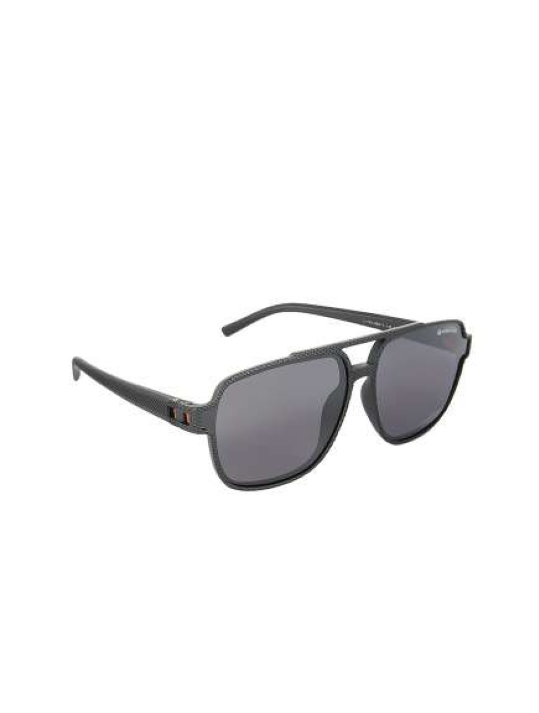

Shop Now @  https://www.myntra.com/sunglasses/giordano/giordano-men-polarised-and-uv-protected-lens-full-rim-aviator-sunglasses-ga90321c01/22664236/buy


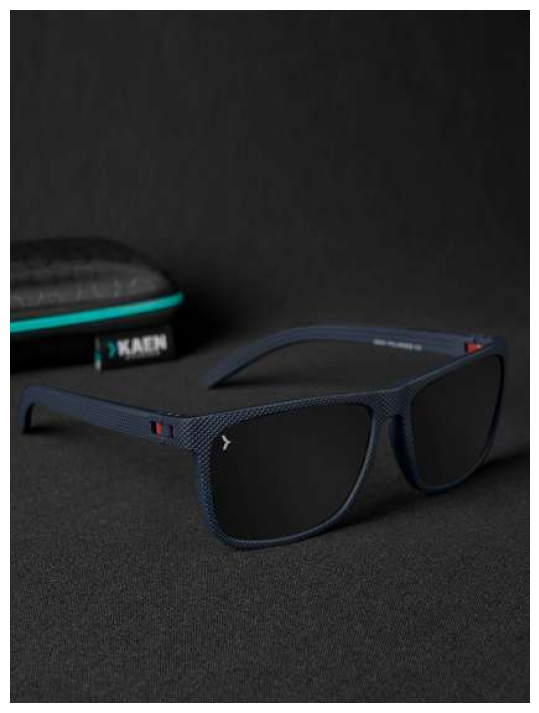

Shop Now @  https://www.myntra.com/sunglasses/kaen+eyewear/kaen-eyewear-unisex-square-sunglasses-with-polarised-lens-kaskevc3/26705228/buy


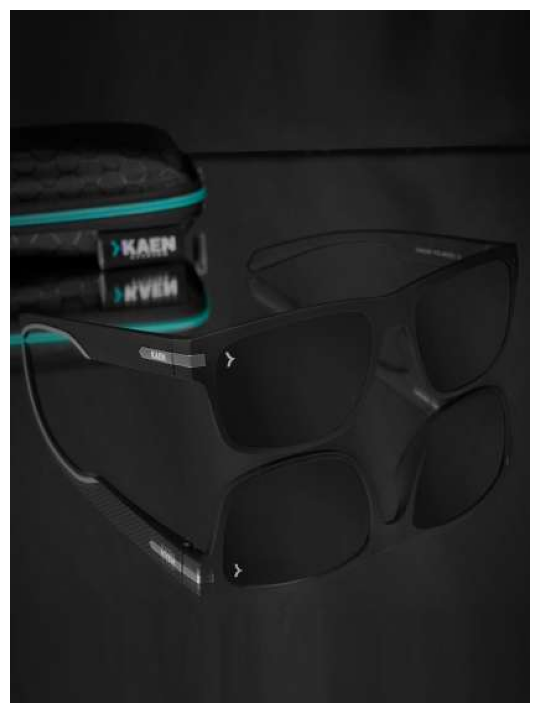

Shop Now @  https://www.myntra.com/sunglasses/eyewearlabs/eyewearlabs-unisex-rectangle-sunglasses-with-polarised-lens-elkaskael/27326526/buy


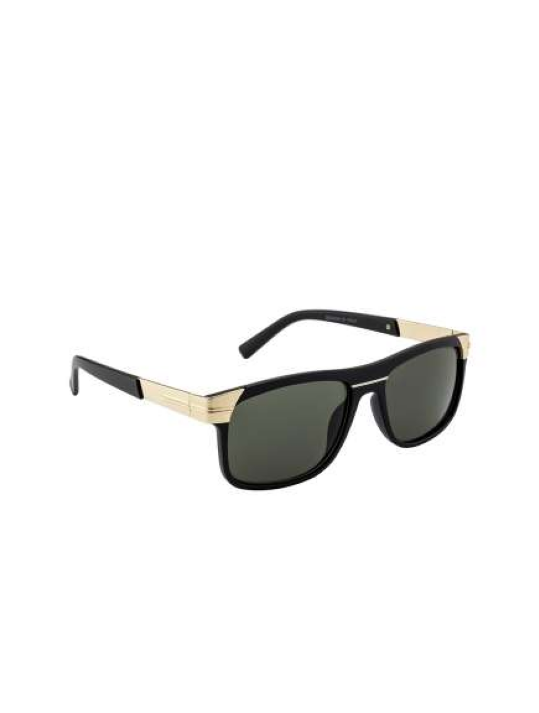

Shop Now @  https://www.myntra.com/sunglasses/mast+%26+harbour/mast--harbour-unisex-square-sunglasses-with-uv-protected-lens-mh-sh3395-c4/25610844/buy


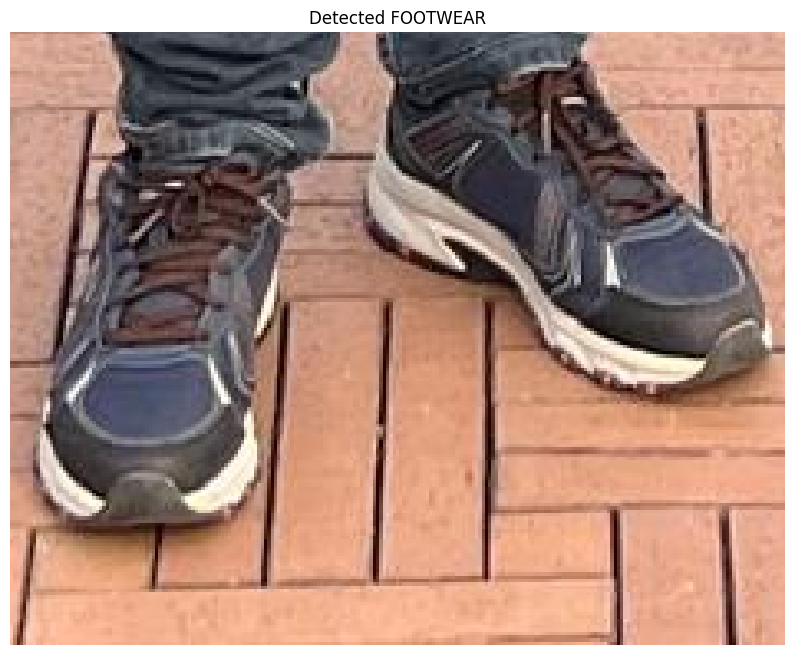

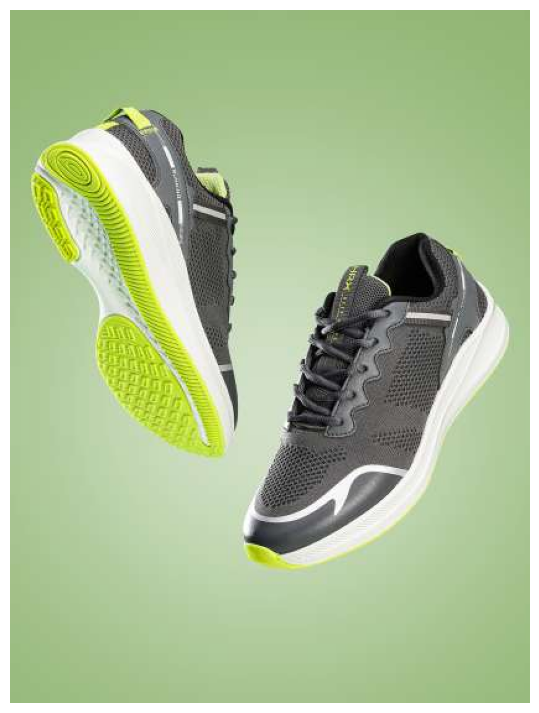

Shop Now @  https://www.myntra.com/sports-shoes/hrx+by+hrithik+roshan/hrx-by-hrithik-roshan-men-woven-design-running-shoes/18964330/buy


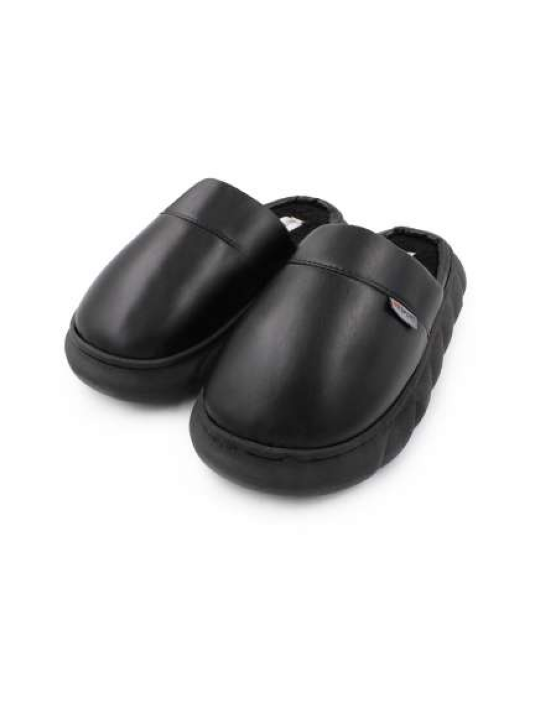

Shop Now @  https://www.myntra.com/flip-flops/jenna/jenna-men-warm-winter-fur-room-slippers/26178332/buy


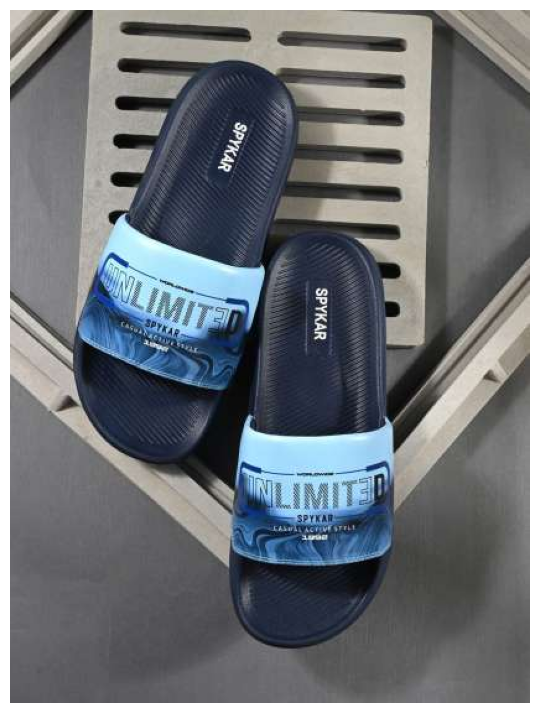

Shop Now @  https://www.myntra.com/flip-flops/spykar/spykar-men-printed-sliders/29973626/buy


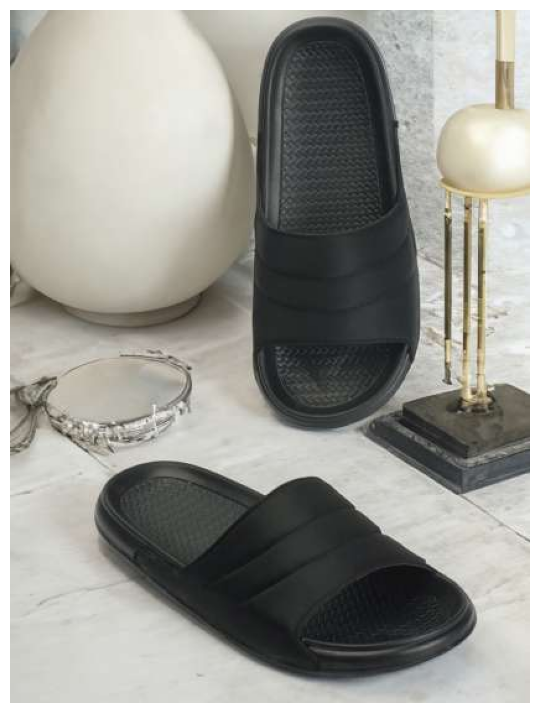

Shop Now @  https://www.myntra.com/flip-flops/pery+pao/pery-pao-men-striped-sliders/25213720/buy


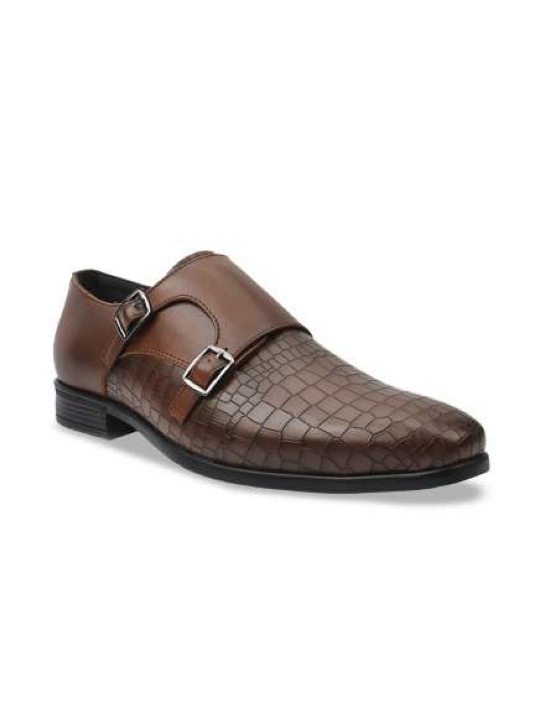

Shop Now @  https://www.myntra.com/formal-shoes/san+frissco/san-frissco-men-textured-formal-monk-shoes/27258240/buy


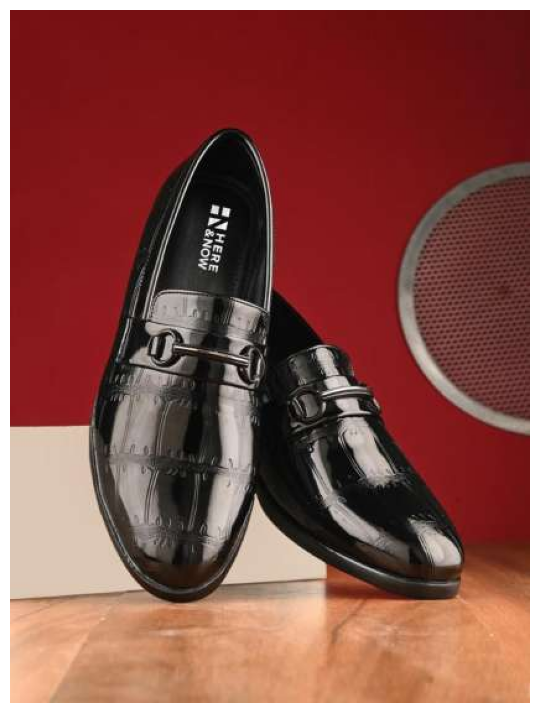

Shop Now @  https://www.myntra.com/formal-shoes/here%26now/herenow-men-textured-slip-on-formal-loafers/26731122/buy


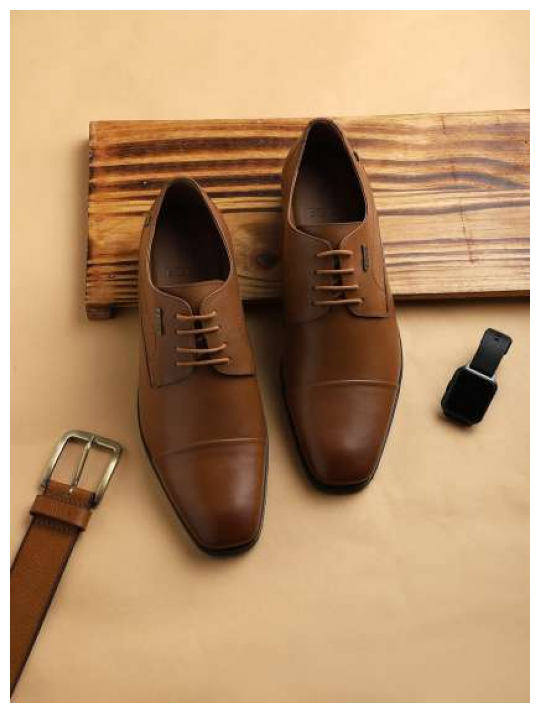

Shop Now @  https://www.myntra.com/formal-shoes/ezok/ezok-men-tan-colored-solid-leather-formal-derby-shoes/19709440/buy


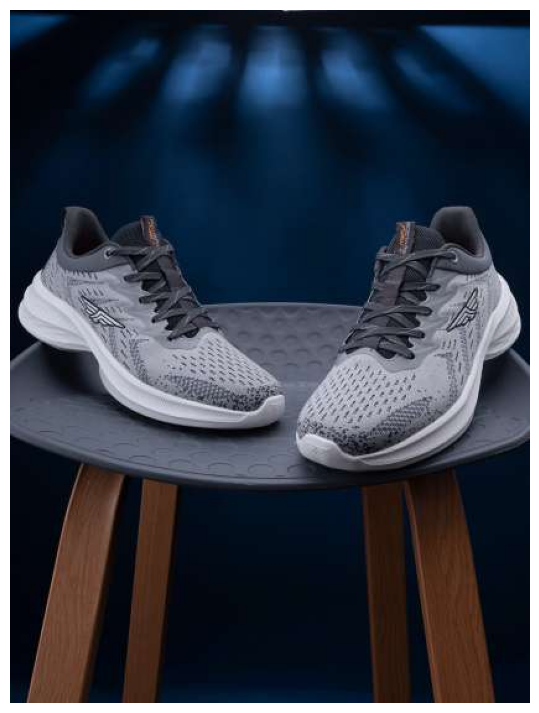

Shop Now @  https://www.myntra.com/sports-shoes/red+tape/red-tape-men-grey--white-textile-walking-shoes/18339118/buy


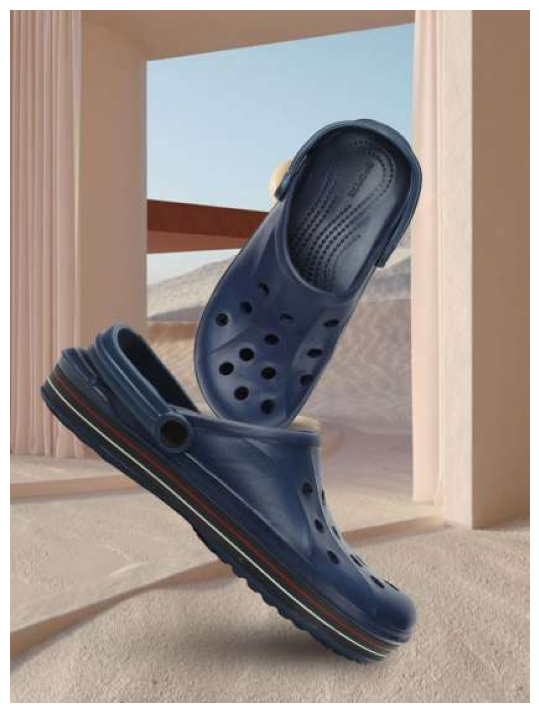

Shop Now @  https://www.myntra.com/flip-flops/m7+by+metronaut/m7-by-metronaut-men-self-design-clogs/23290782/buy


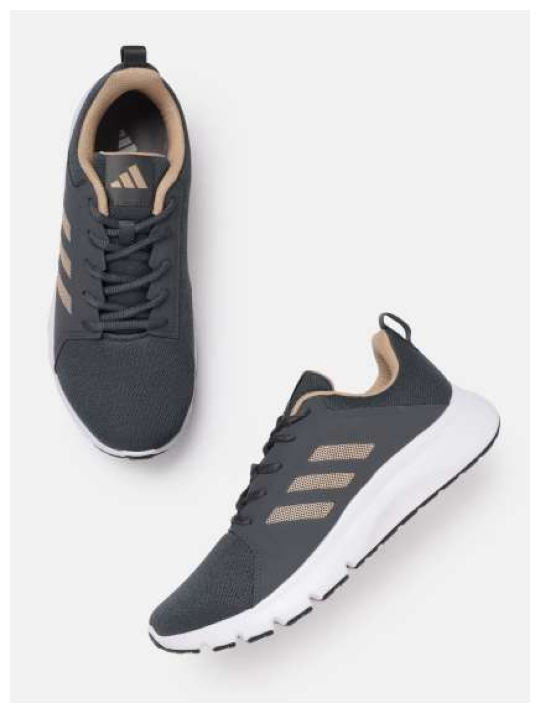

Shop Now @  https://www.myntra.com/sports-shoes/adidas/adidas-men-woven-design-apexo-walking-shoes/23130000/buy


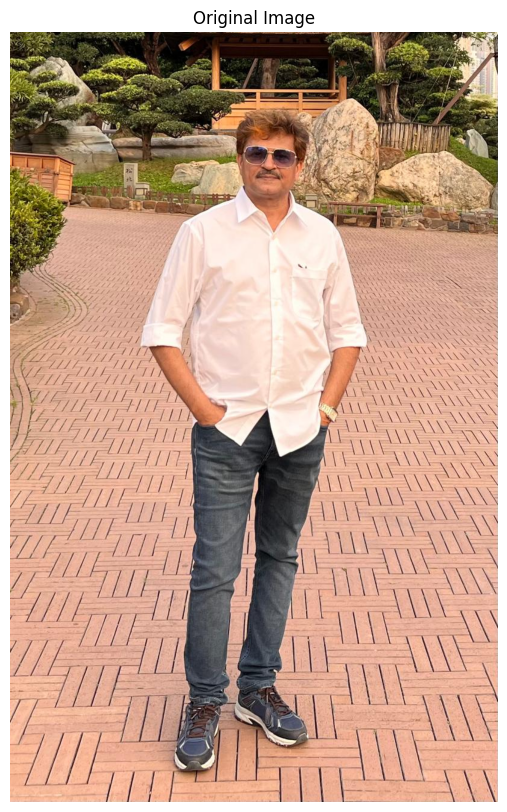

In [46]:
img_path = "./Examples/Person2_test1.jpeg"
weights_path = "./runs/detect/yolo_small_train/weights/best.pt"  


finder = FIND_SIMILAR_PRODUCTS(img_path, weights_path)
finder.run()

1/1 [==============================] - 0s 75ms/step
Predicted Gender: male

0: 512x448 1 TOPWEAR, 303.6ms
Speed: 10.1ms preprocess, 303.6ms inference, 12.2ms postprocess per image at shape (1, 3, 512, 448)


100%|██████████| 1738/1738 [00:01<00:00, 909.86it/s] 


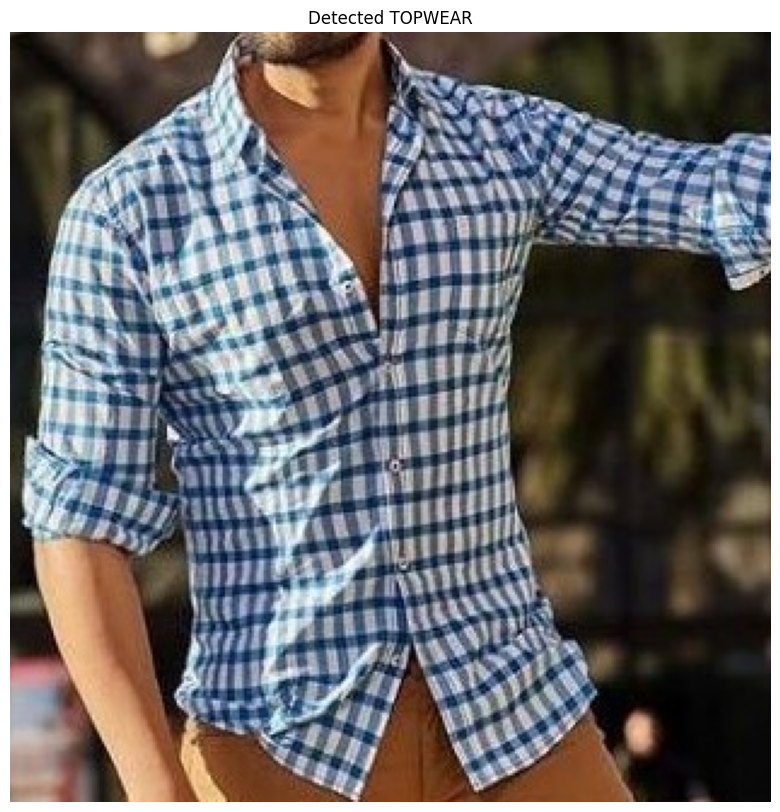

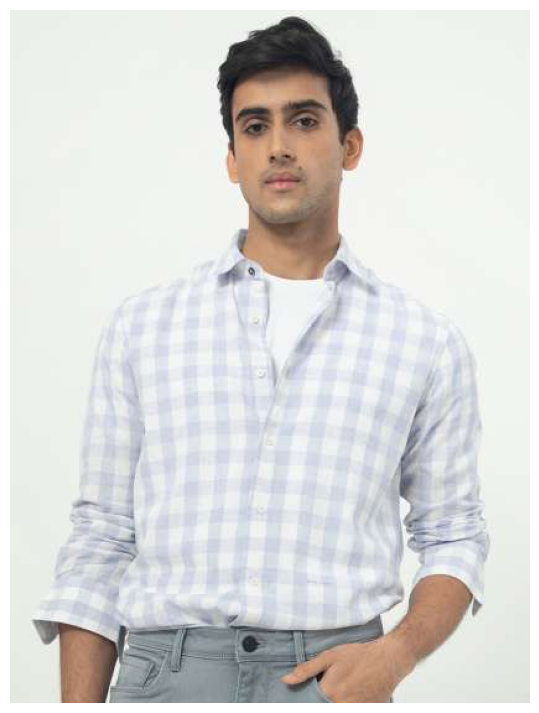

Shop Now @  https://www.myntra.com/shirts/rare+rabbit/rare-rabbit-men-cutro-slim-fit-gingham-checked-cotton-shirt/24219294/buy


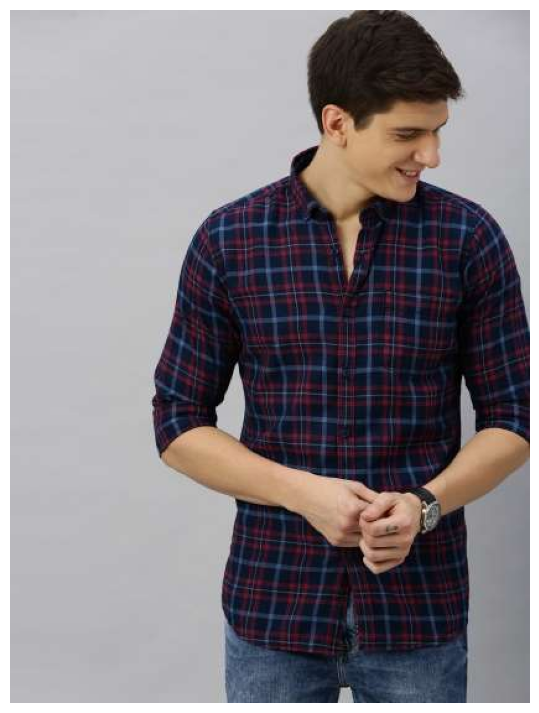

Shop Now @  https://www.myntra.com/shirts/mast+%26+harbour/mast--harbour-men-navy-blue--red-checked-casual-sustainable-shirt/11007314/buy


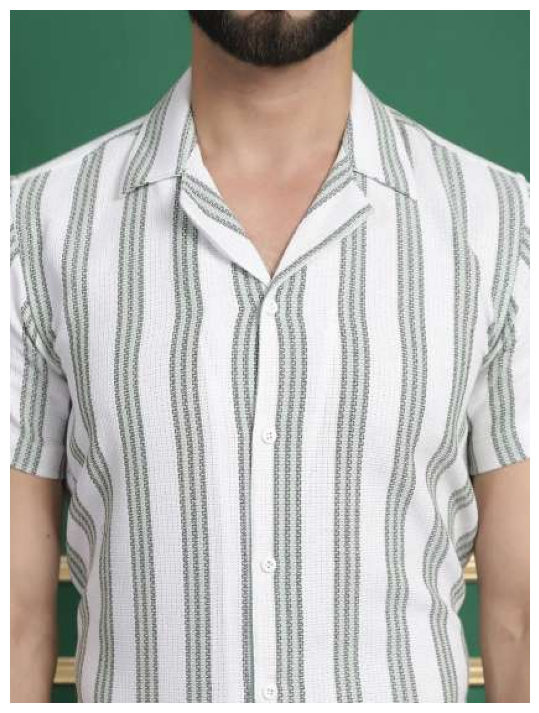

Shop Now @  https://www.myntra.com/shirts/indian+needle/indian-needle-classic-opaque-striped-cotton-wrinkle-free-formal-shirt/28647832/buy


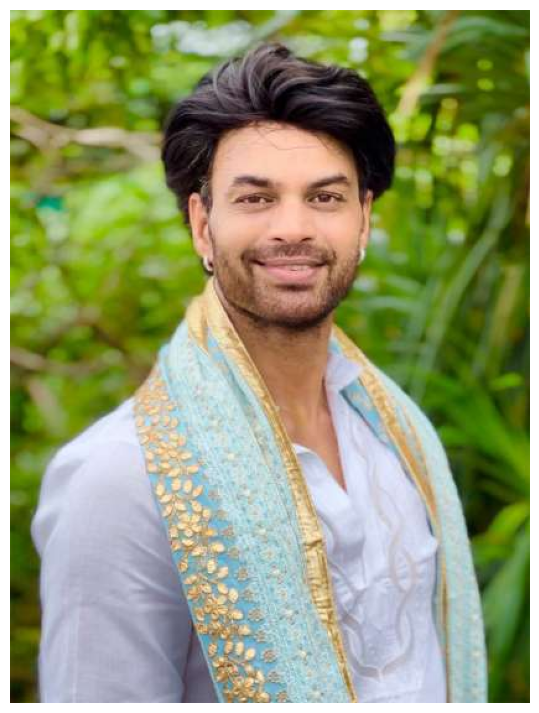

Shop Now @  https://www.myntra.com/dupatta/dupatta+bazaar/dupatta-bazaar-men-floral-lucknowi-work-embroidered-georgette-dupatta-with-gotta-patti/26288192/buy


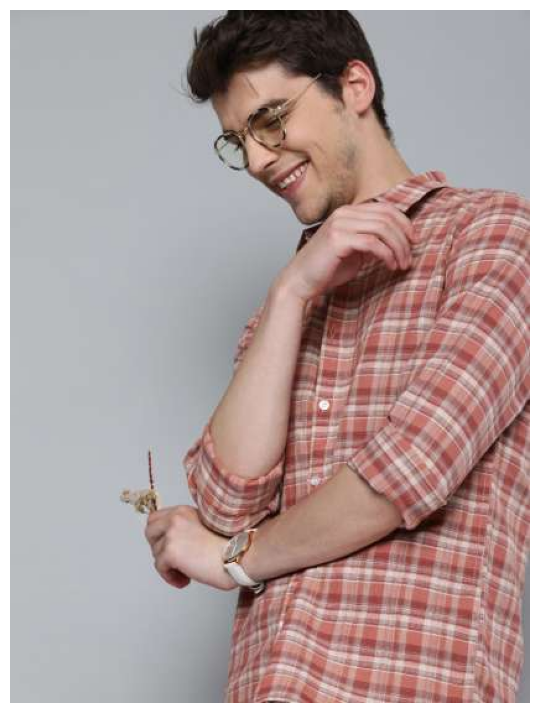

Shop Now @  https://www.myntra.com/shirts/mast+%26+harbour/mast--harbour-men-rust-pink--maroon-regular-fit-checked---casual-cotton-linen-sustainable-shirt/11369786/buy


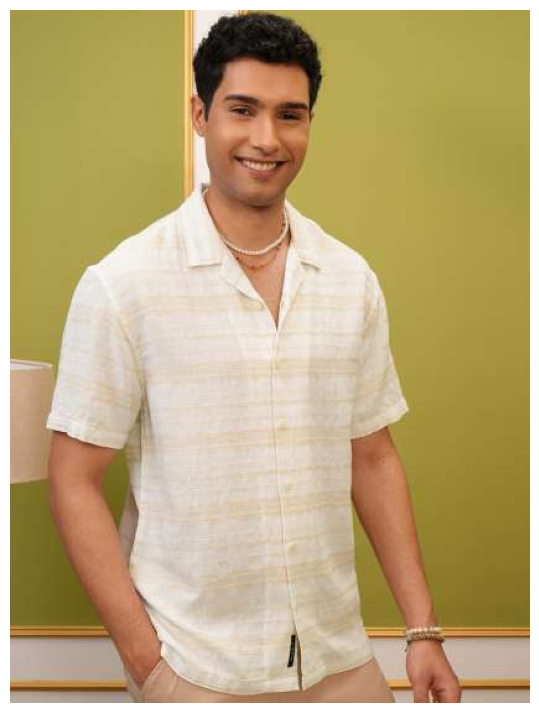

Shop Now @  https://www.myntra.com/shirts/locomotive/locomotive-premium-natural-yarn-dobby-textured-striped-cuban-collar-relaxed-shirt/28982352/buy


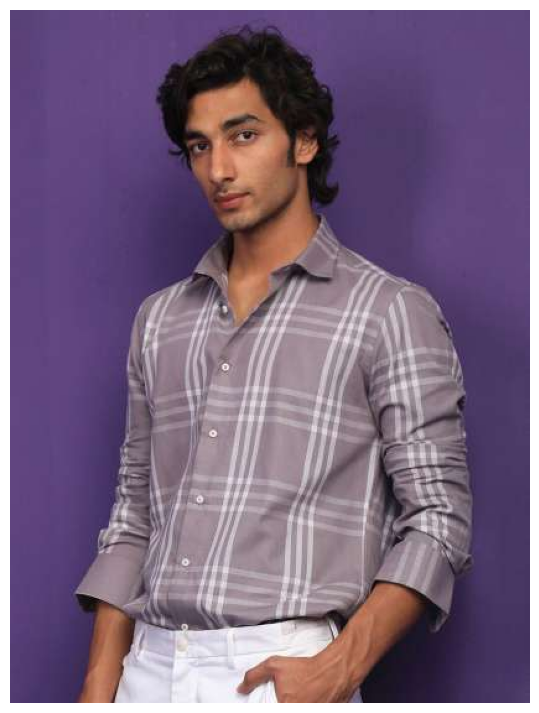

Shop Now @  https://www.myntra.com/shirts/rare+rabbit/rare-rabbit-men-carnet-slim-fit-opaque-checked-cotton-shirt/23409778/buy


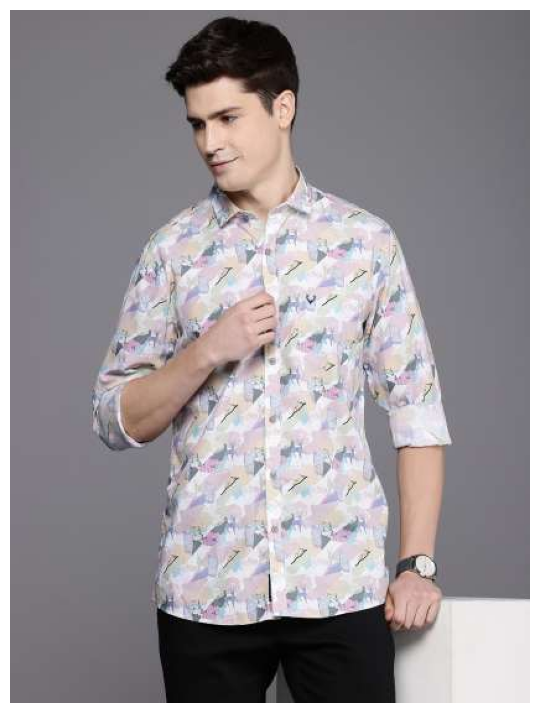

Shop Now @  https://www.myntra.com/shirts/allen+solly/allen-solly-pure-cotton-custom-fit-opaque-printed-casual-shirt/29078460/buy


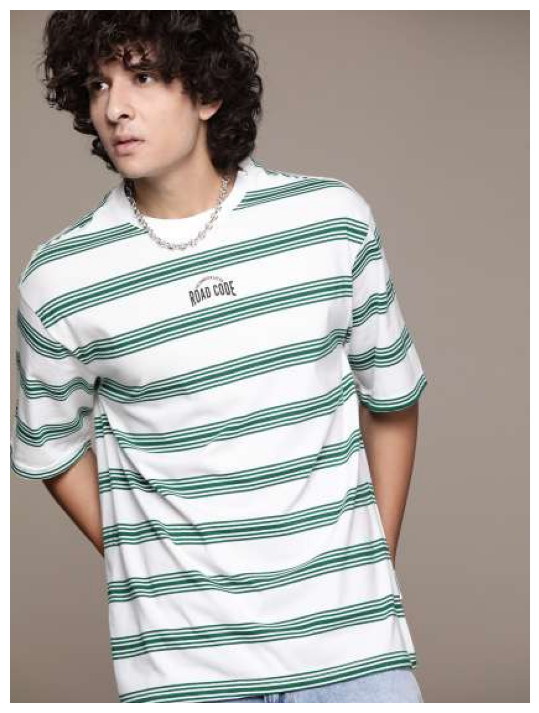

Shop Now @  https://www.myntra.com/tshirts/roadster/the-roadster-lifestyle-co-striped-relaxed-fit-t-shirt/27689440/buy


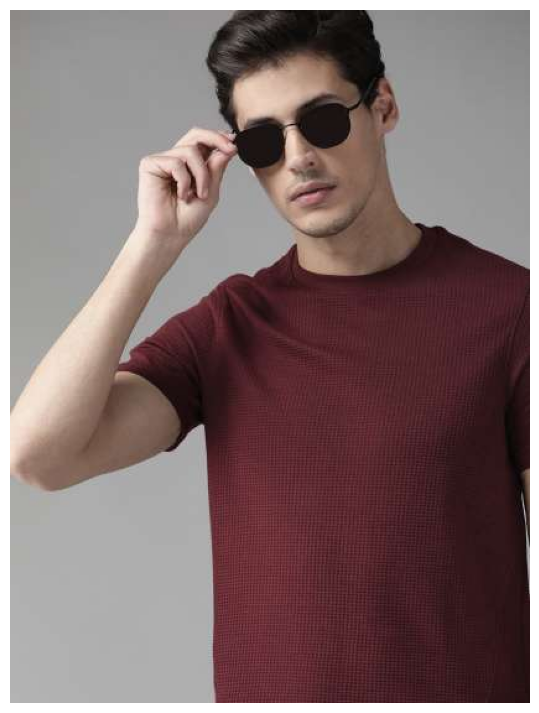

Shop Now @  https://www.myntra.com/tshirts/roadster/the-roadster-lifestyle-co-men-burgundy--waffle-texture-t-shirt/16998580/buy


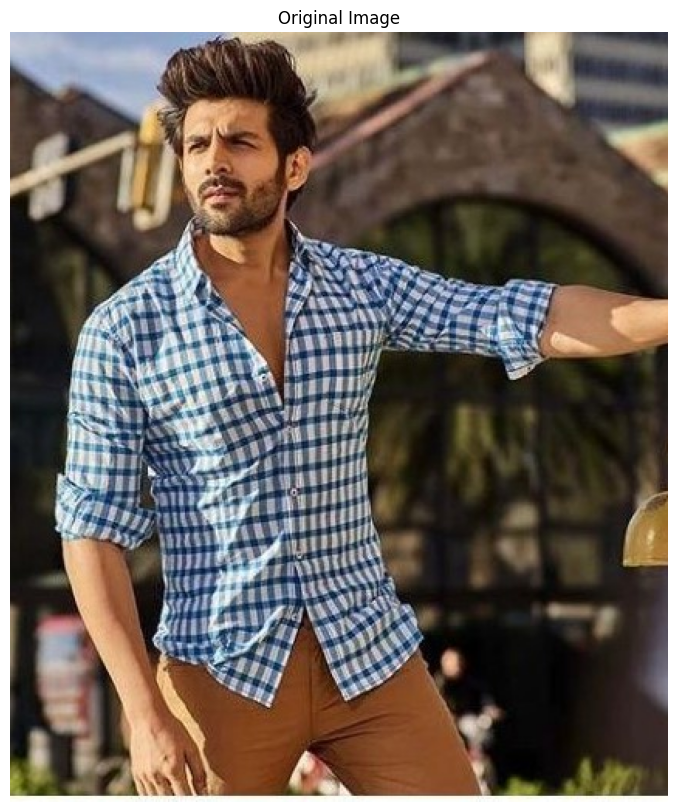

In [55]:
img_path = "./Examples/celebs3.jpg"
weights_path = "./runs/detect/yolo_small_train/weights/best.pt"  


finder = FIND_SIMILAR_PRODUCTS(img_path, weights_path)
finder.run()

1/1 [==============================] - 0s 40ms/step
Predicted Gender: female

0: 512x320 1 TOPWEAR, 1 BOTTOMWEAR, 1 FOOTWEAR, 1 HANDBAG, 200.8ms
Speed: 4.9ms preprocess, 200.8ms inference, 0.0ms postprocess per image at shape (1, 3, 512, 320)


100%|██████████| 706/706 [00:00<00:00, 1071.11it/s]


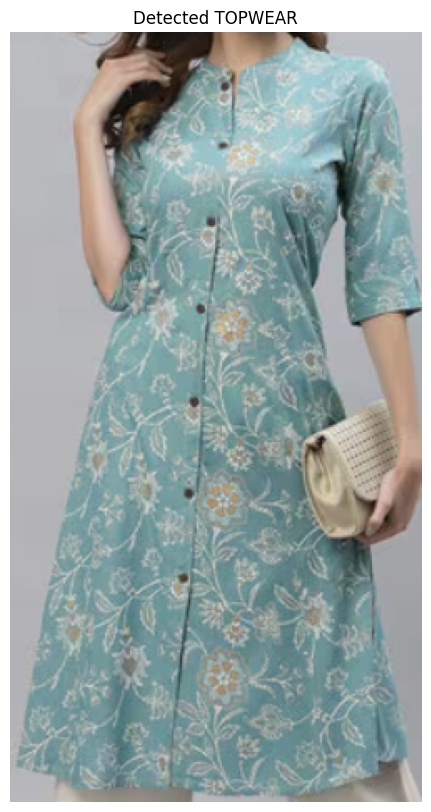

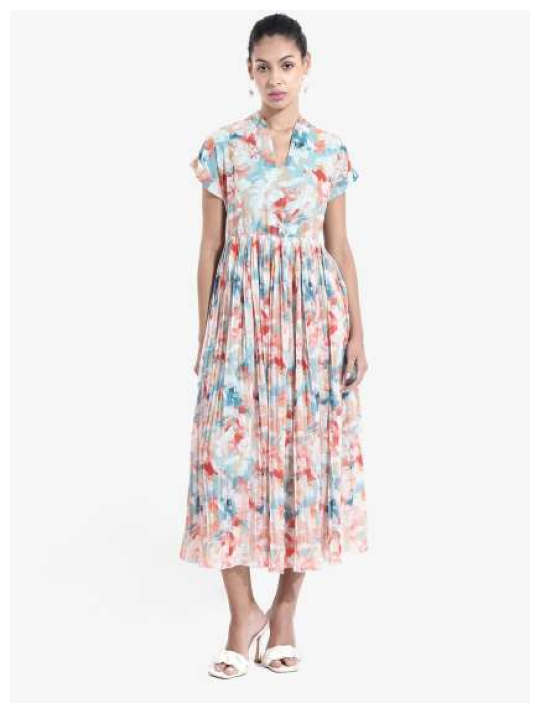

Shop Now @  https://www.myntra.com/dresses/rareism/rareism-floral-print-fit--flare-midi-dress/29997775/buy


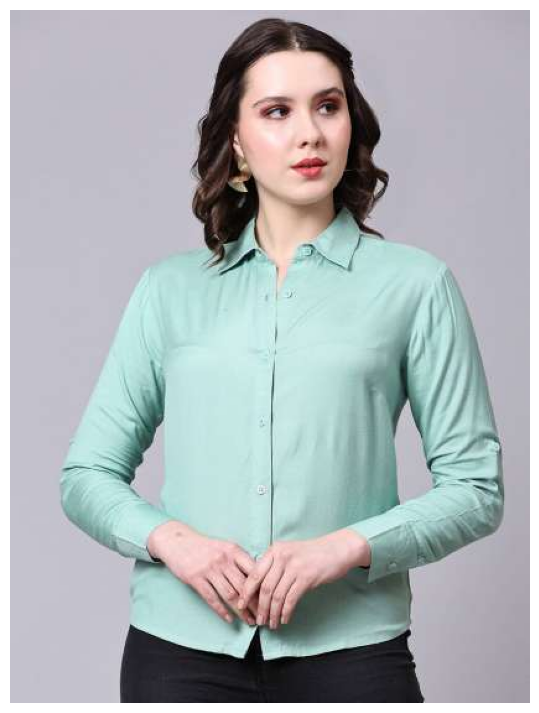

Shop Now @  https://www.myntra.com/shirts/pomegal/pomegal-classic-tailored-fit-opaque-formal-shirt/24835610/buy


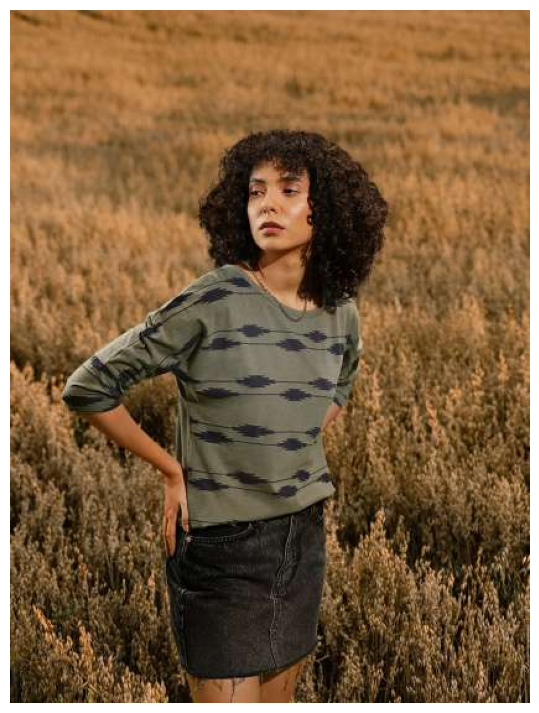

Shop Now @  https://www.myntra.com/tshirts/roadster/roadster-women-pure-cotton-printed-round-neck-t-shirt/8331077/buy


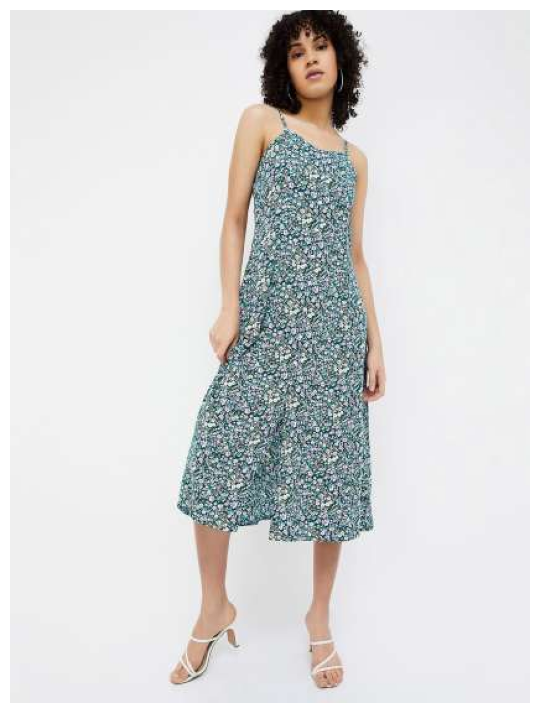

Shop Now @  https://www.myntra.com/dresses/ginger+by+lifestyle/ginger-by-lifestyle-floral-printed-a-line-midi-dress/29743012/buy


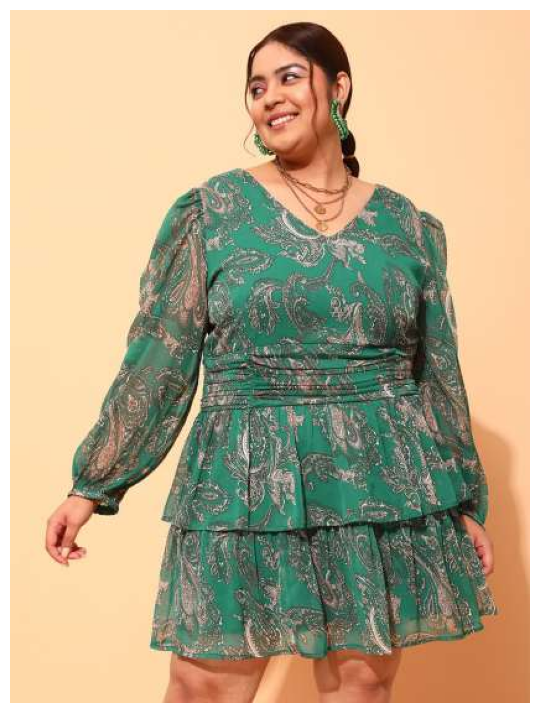

Shop Now @  https://www.myntra.com/dresses/curvy+street/curvy-street-plus-size-green--white-printed-v-neck-puff-sleeves-fit--flare-dress/22786672/buy


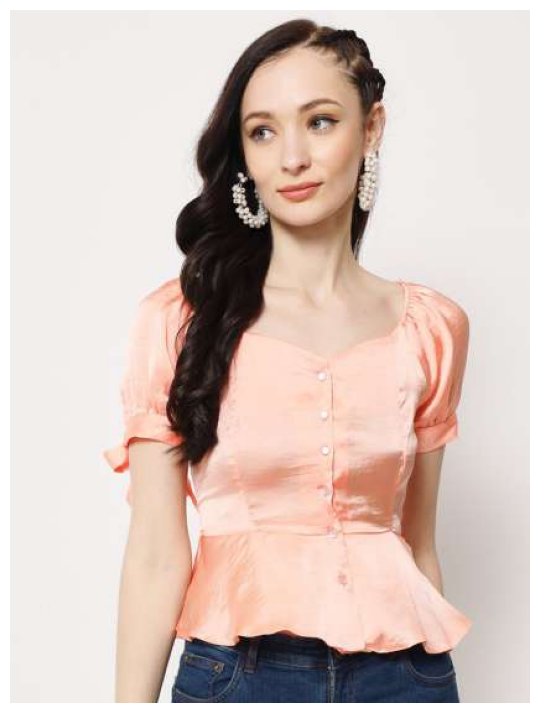

Shop Now @  https://www.myntra.com/tops/here%26now/herenow-sweetheart-neck-puff-sleeve-top/21442656/buy


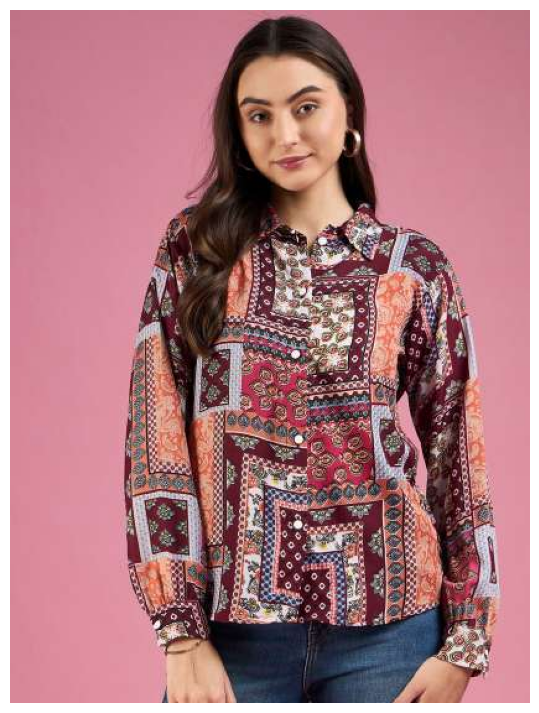

Shop Now @  https://www.myntra.com/shirts/dressberry/dressberry-red-smart-ethnic-motifs-printed-crepe-casual-shirt/29614288/buy


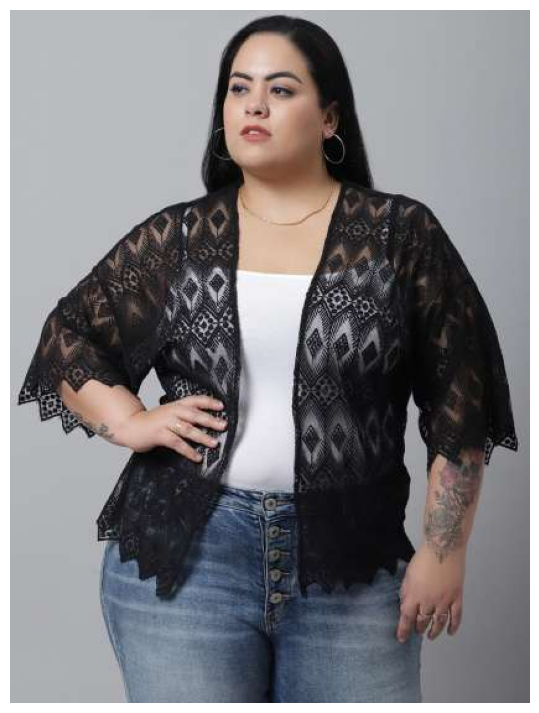

Shop Now @  https://www.myntra.com/shrug/rute/rute-women-black-self-design-plus-size-cotton-shrug/20808954/buy


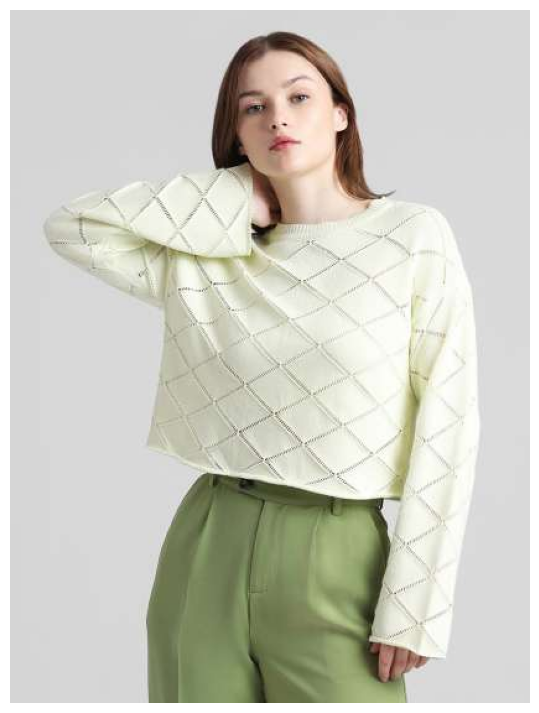

Shop Now @  https://www.myntra.com/sweaters/only/only-onlswing-ls-self-design-open-knit-crop-pure-cotton-pullover-sweater/25310790/buy


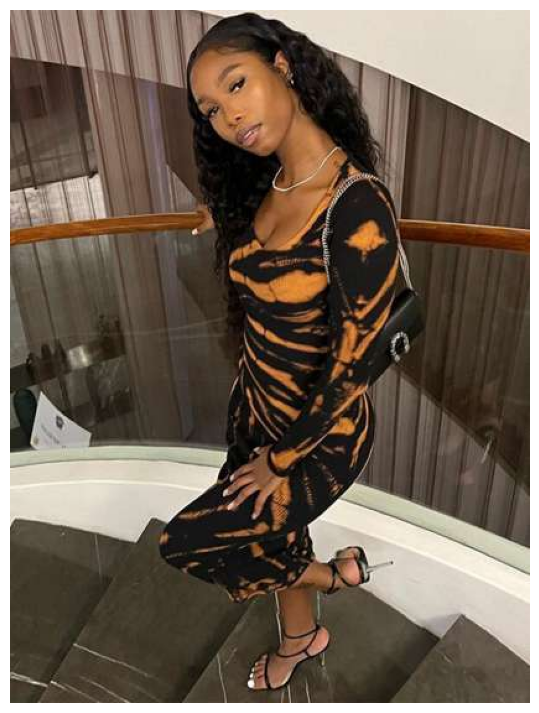

Shop Now @  https://www.myntra.com/dresses/stylecast/stylecast-black-abstract-printed-bodycon-midi-dress/25630392/buy


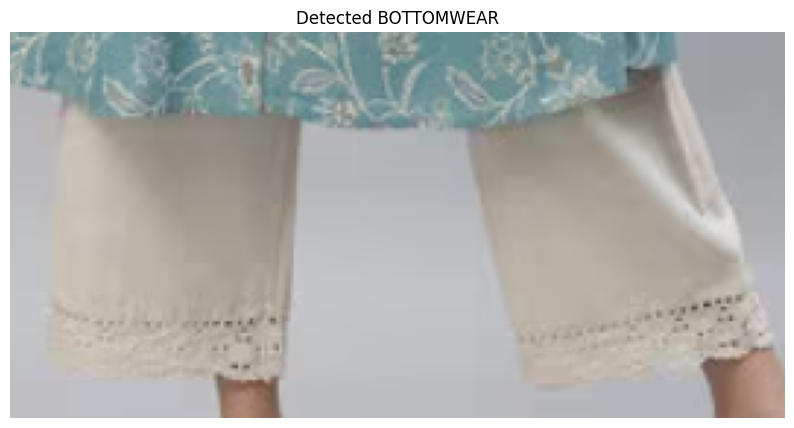

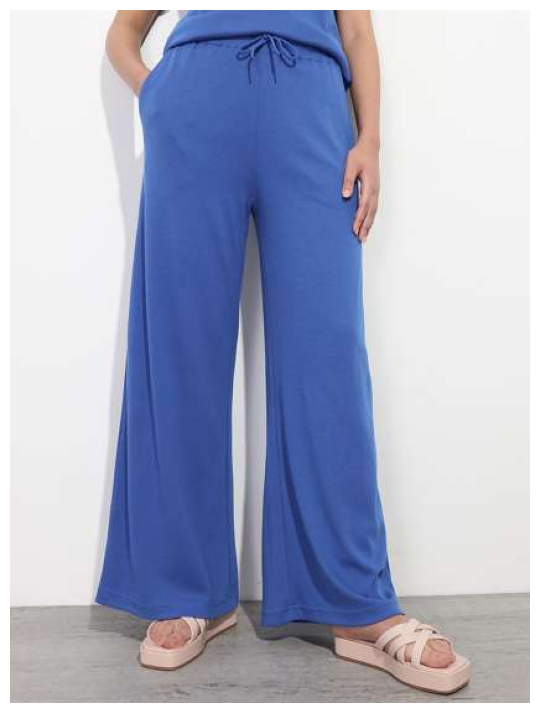

Shop Now @  https://www.myntra.com/trousers/dressberry/dressberry-women-electric-dreams-wide-wonders-trousers/28271370/buy


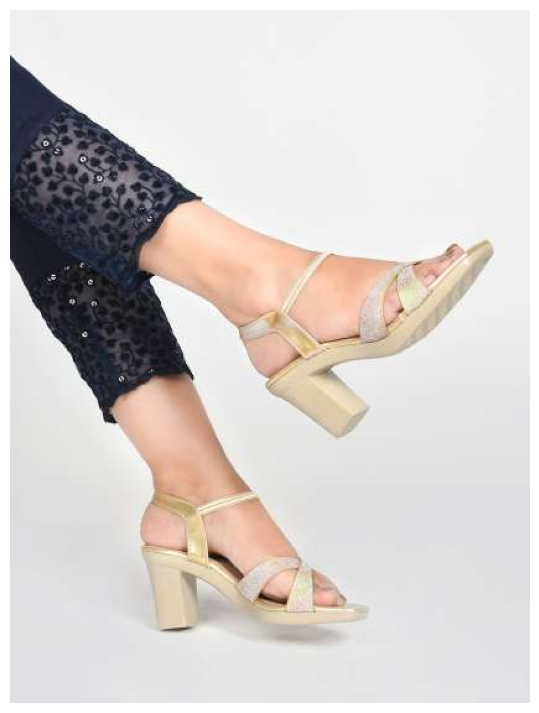

Shop Now @  https://www.myntra.com/heels/jm+looks/jm-looks-embellished-party-platform-heels-with-backstrap-/24965634/buy


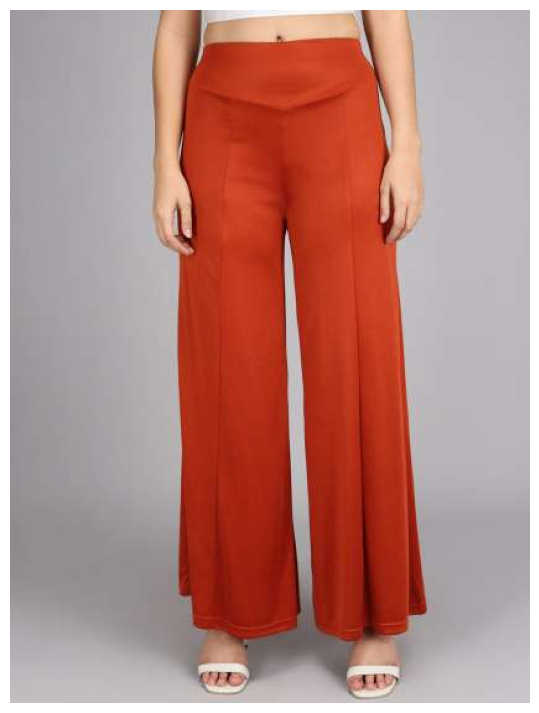

Shop Now @  https://www.myntra.com/trousers/kotty/kotty-women-maroon-flared-high-rise-parallel-trousers/14671614/buy


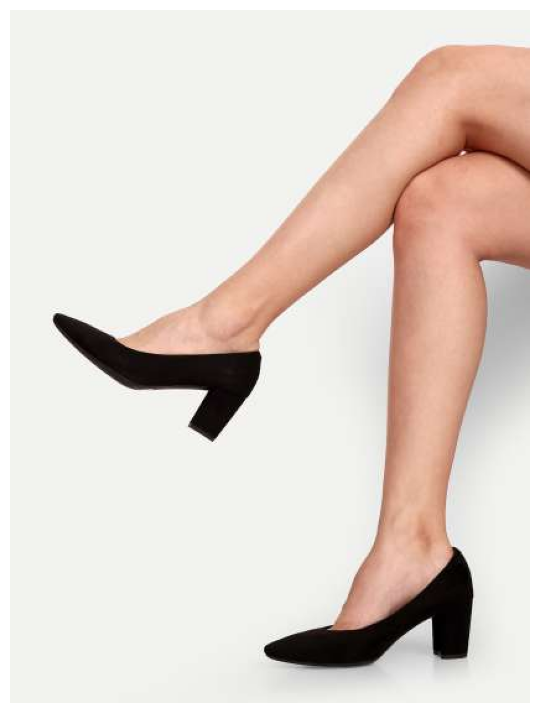

Shop Now @  https://www.myntra.com/heels/inc+5/inc-5-black-party-block-pumps/17282778/buy


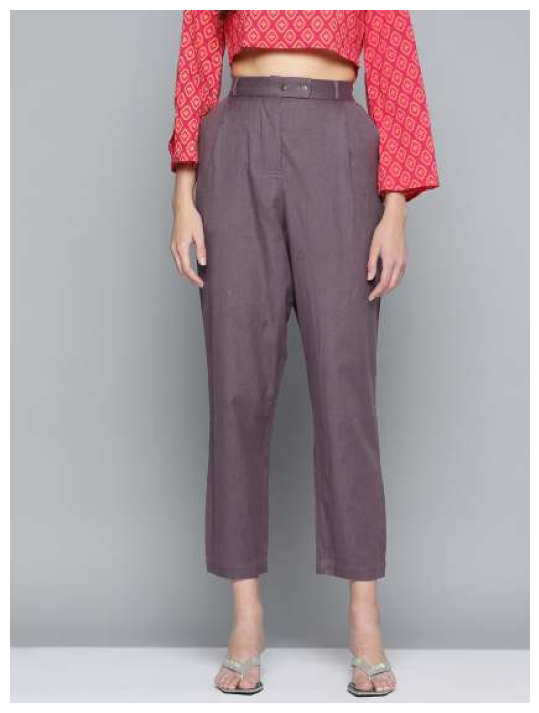

Shop Now @  https://www.myntra.com/trousers/here%26now/herenow-women-purple-solid-straight-fit-pleated-trousers/19763506/buy


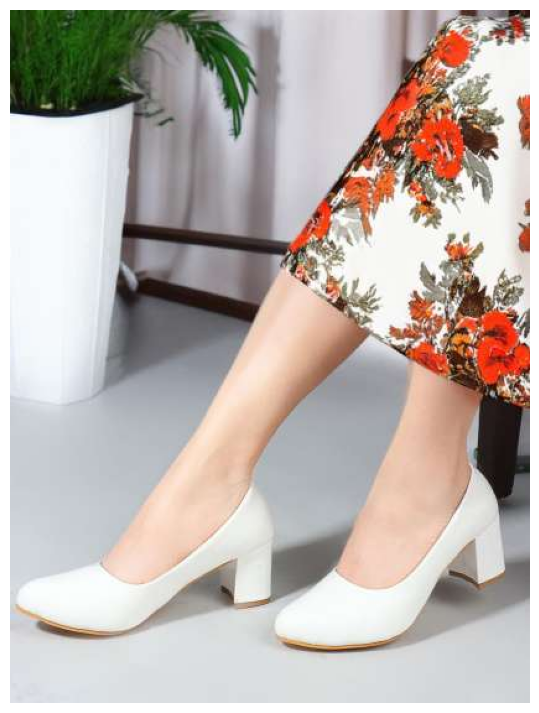

Shop Now @  https://www.myntra.com/heels/mast+%26+harbour/mast--harbour-party-block-pumps/29633596/buy


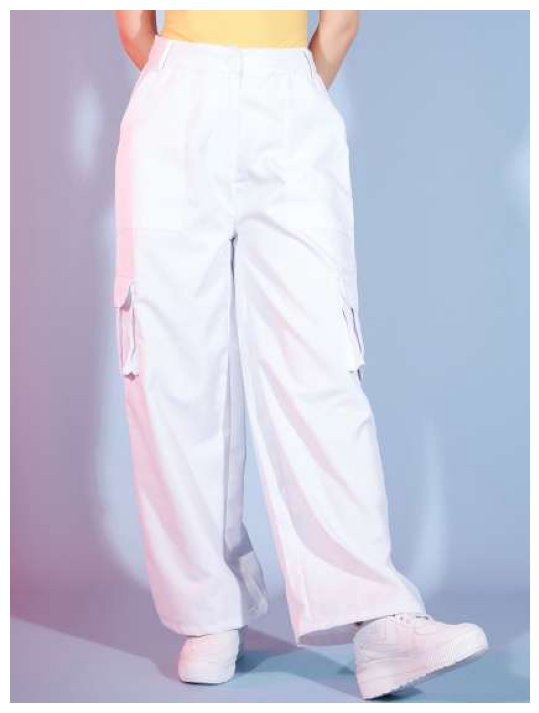

Shop Now @  https://www.myntra.com/trousers/mast+%26+harbour/mast--harbour-women-loose-fit-balloon-cargos-trouser/26591940/buy


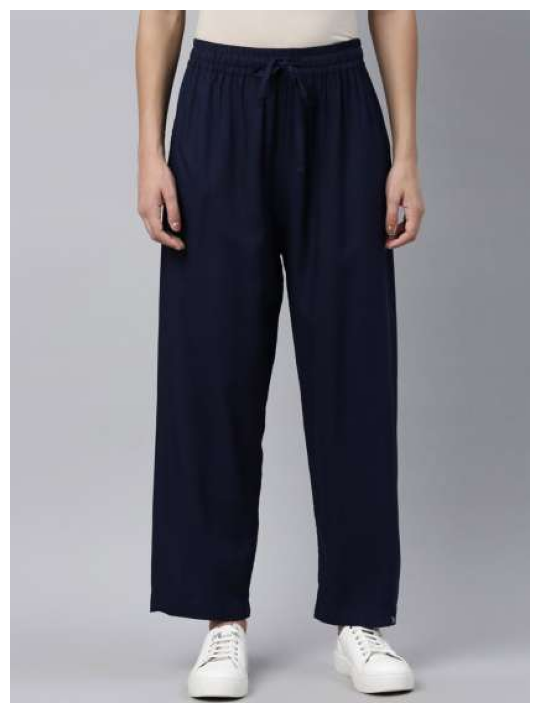

Shop Now @  https://www.myntra.com/trousers/twin+birds/twin-birds-women-relaxed-fit-trouser/28568560/buy


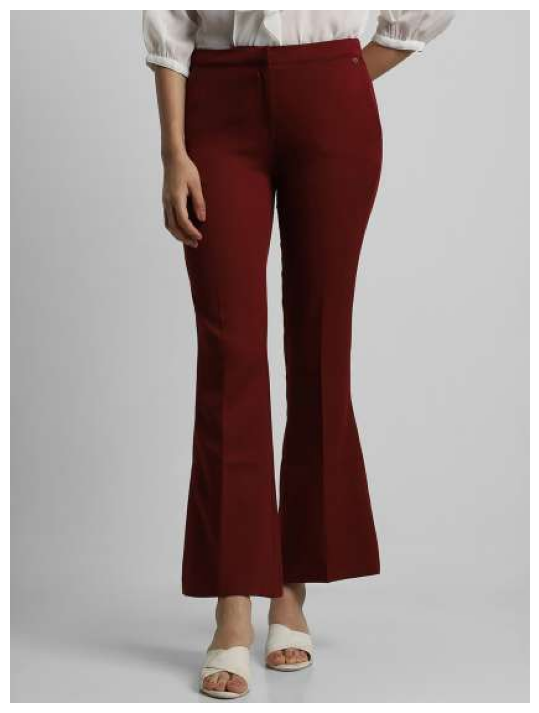

Shop Now @  https://www.myntra.com/trousers/allen+solly+woman/allen-solly-woman-women-maroon-trousers/25701118/buy


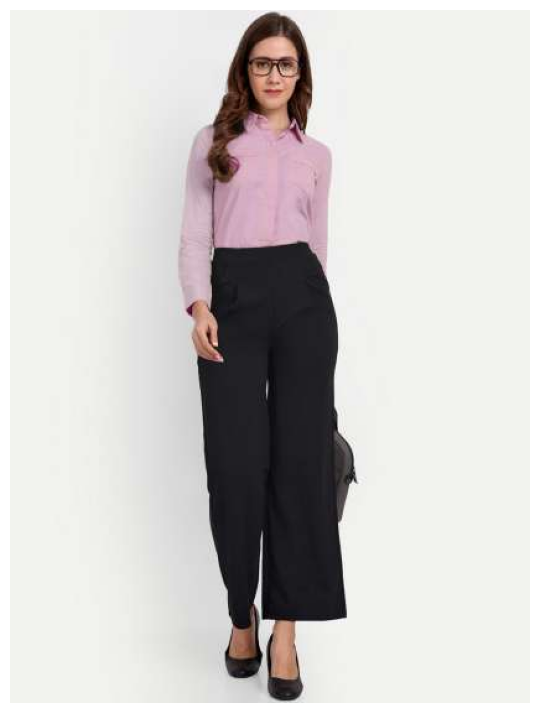

Shop Now @  https://www.myntra.com/trousers/next+one/next-one-women-tailored-loose-fit-high-rise-easy-wash-formal-trousers/21747086/buy


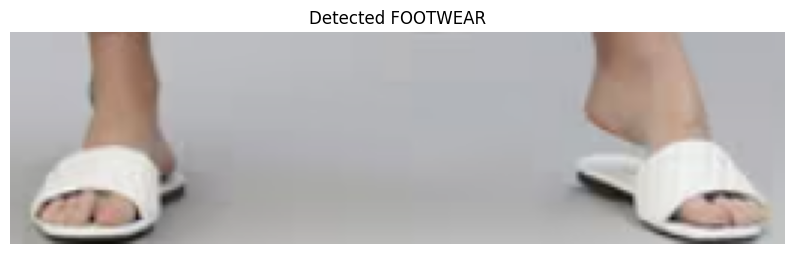

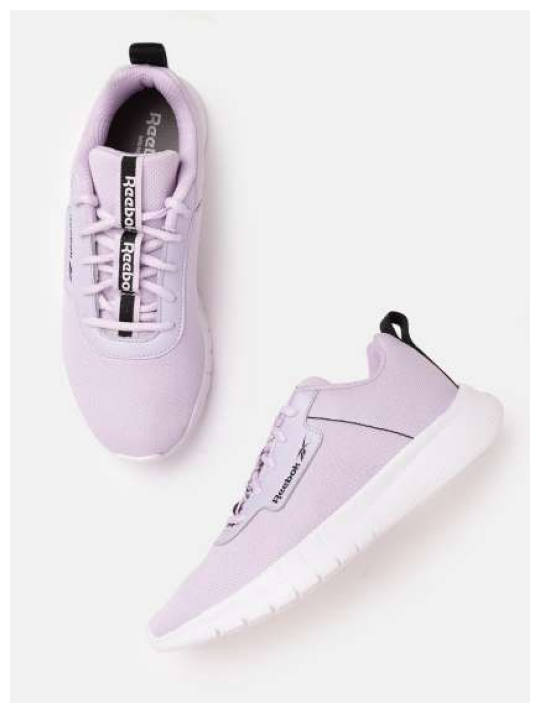

Shop Now @  https://www.myntra.com/sports-shoes/reebok/reebok-women-woven-design-stride-walker-shoes/21819330/buy


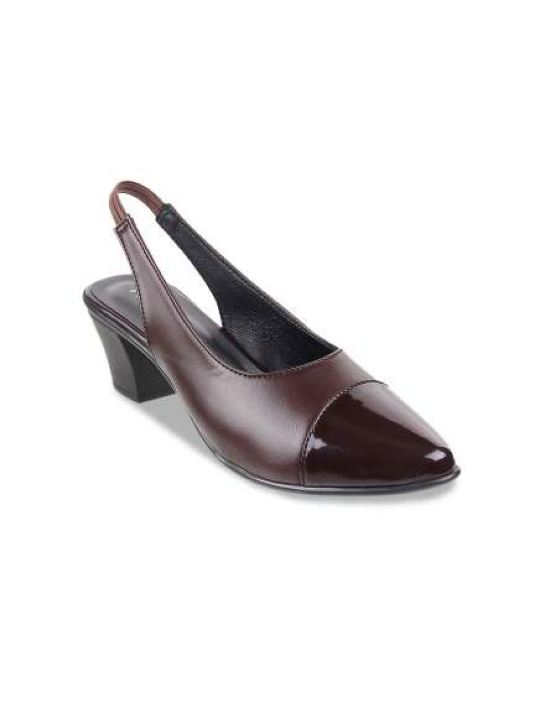

Shop Now @  https://www.myntra.com/heels/metro/metro-women-brown-block-mules/19921832/buy


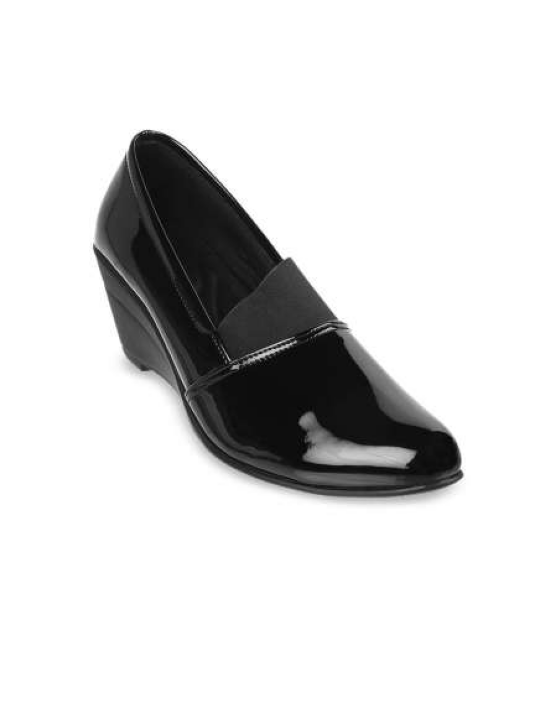

Shop Now @  https://www.myntra.com/heels/mochi/mochi-black-wedge-pumps/19121124/buy


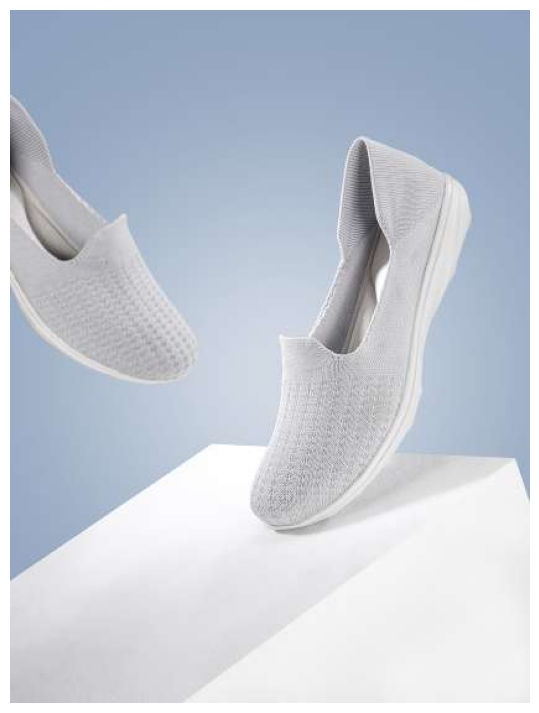

Shop Now @  https://www.myntra.com/sports-shoes/hrx+by+hrithik+roshan/hrx-by-hrithik-roshan-women-woven-design-walking-shoes/21800036/buy


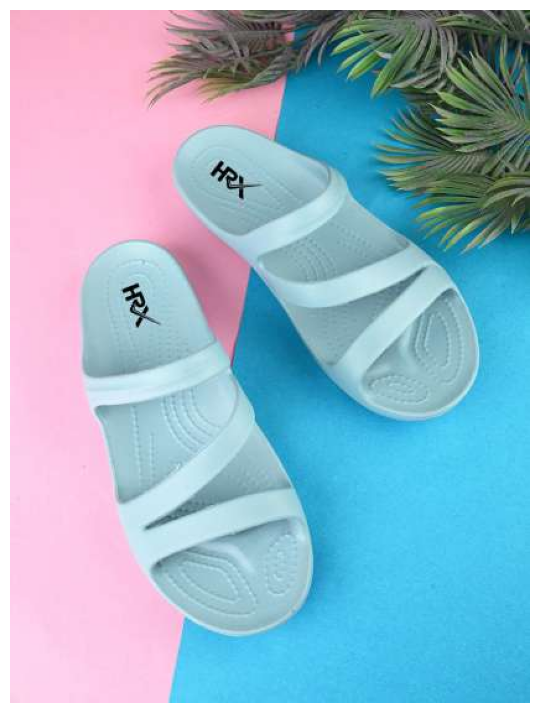

Shop Now @  https://www.myntra.com/flip-flops/hrx+by+hrithik+roshan/hrx-by-hrithik-roshan-women-blue-textured-sliders/25672860/buy


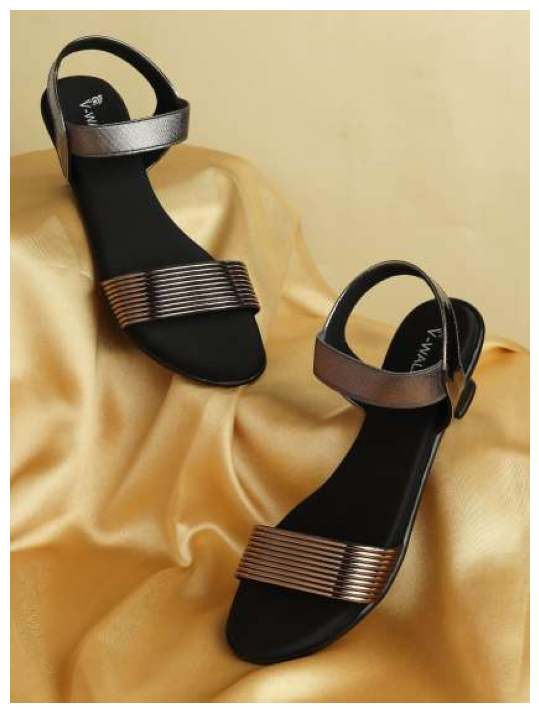

Shop Now @  https://www.myntra.com/heels/v-walk/v-walk-striped-party-block-sandals/24682806/buy


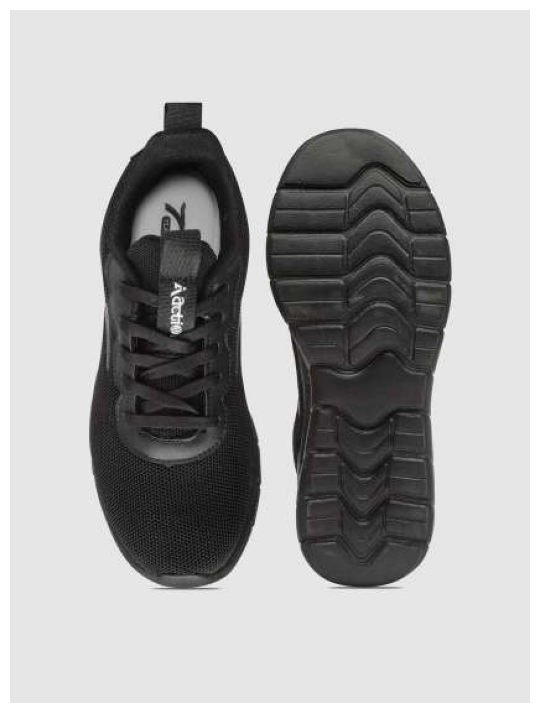

Shop Now @  https://www.myntra.com/sports-shoes/action/action-women-mesh-running-non-marking-shoes/29969805/buy


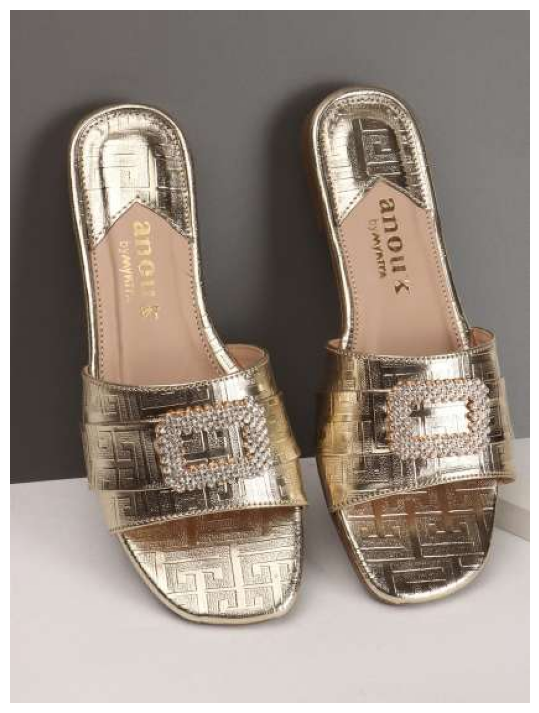

Shop Now @  https://www.myntra.com/flats/anouk/anouk-embellished-open-toe-flats/29504554/buy


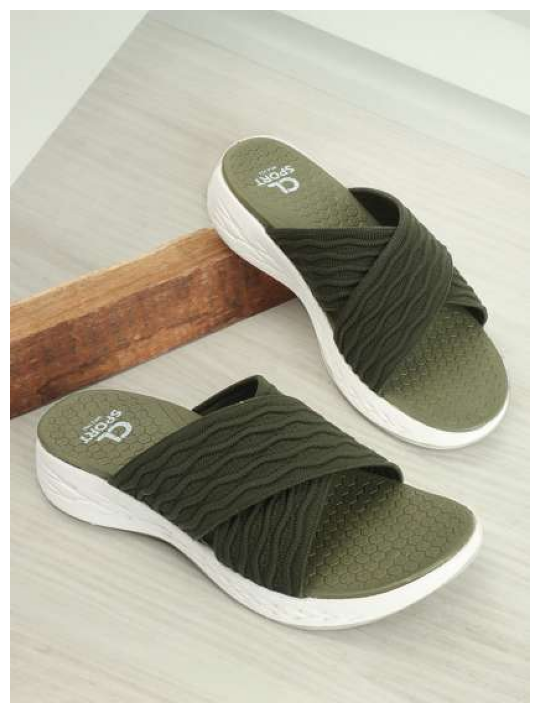

Shop Now @  https://www.myntra.com/flip-flops/carlton+london+sports/carlton-london-sports-women-olive-green--white-rubber-sliders/26350150/buy


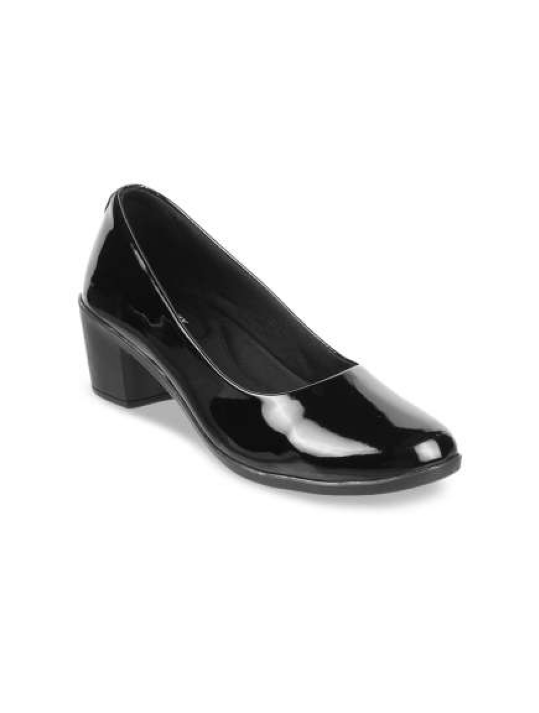

Shop Now @  https://www.myntra.com/heels/walkway+by+metro/walkway-by-metro-women-black-block-pumps/19710298/buy


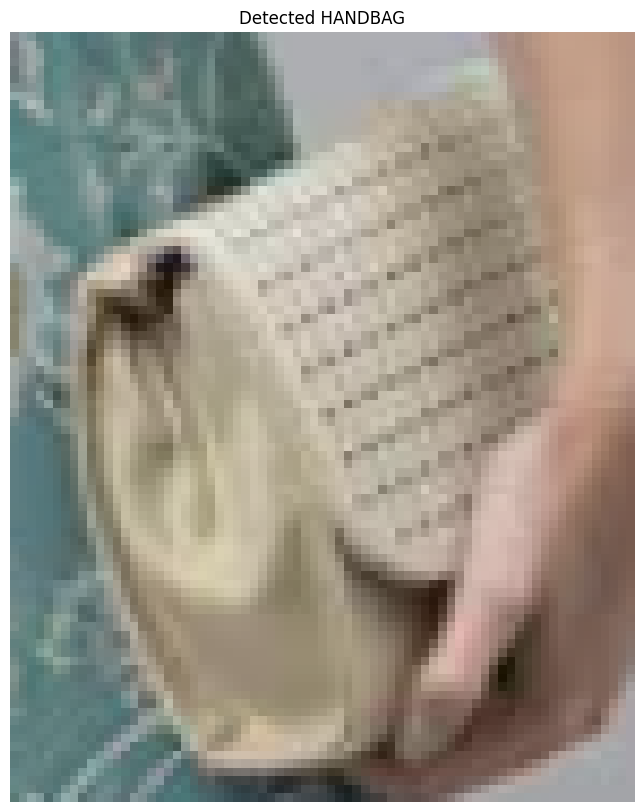

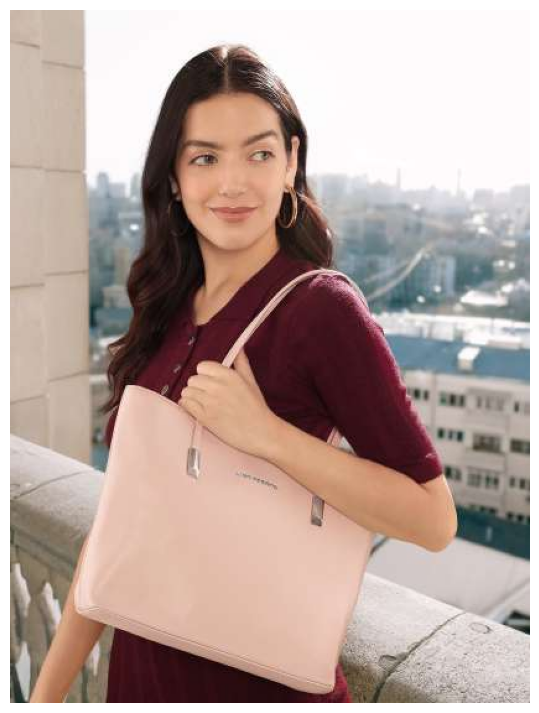

Shop Now @  https://www.myntra.com/handbags/lino+perros/lino-perros-dusty-pink-solid-laptop-bag/7743402/buy


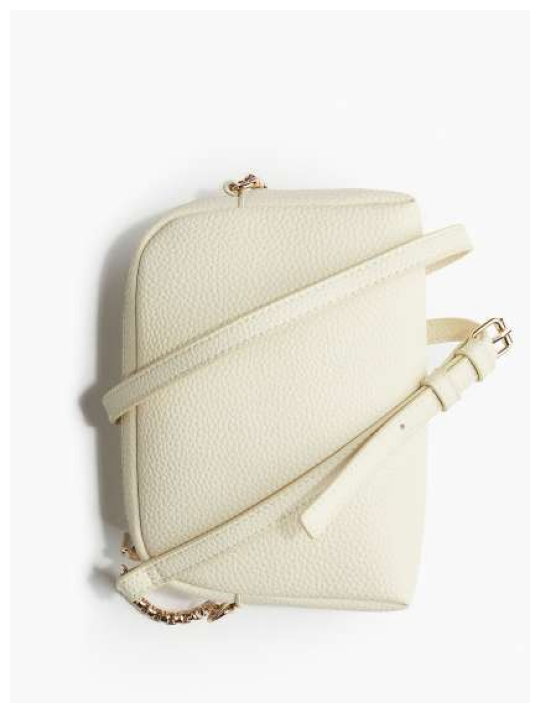

Shop Now @  https://www.myntra.com/handbags/h%26m/hm-small-crossbody-bag/28878442/buy


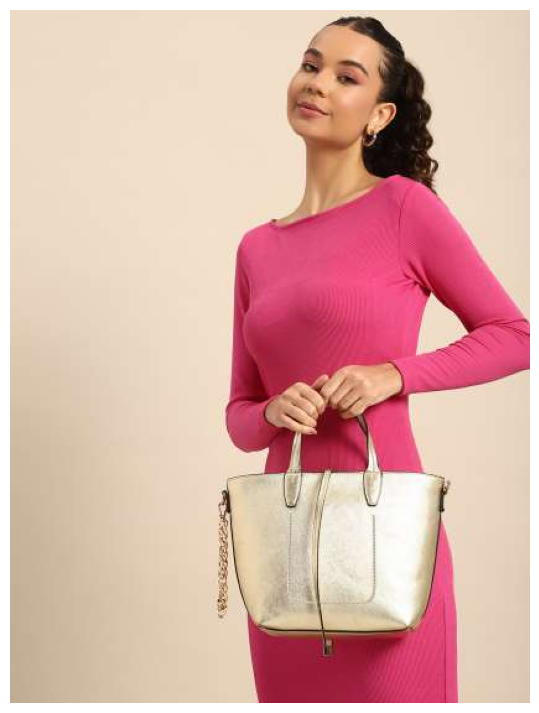

Shop Now @  https://www.myntra.com/handbags/dressberry/dressberry-abstract-textured-structured-handheld-bag/23287222/buy


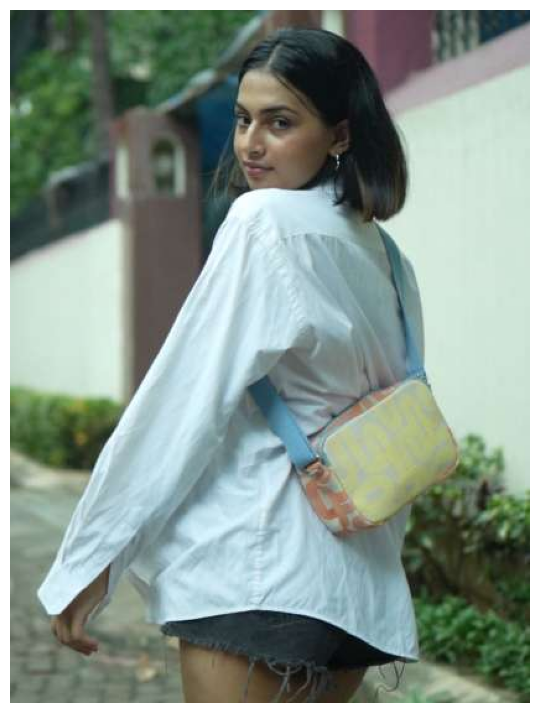

Shop Now @  https://www.myntra.com/handbags/ecoright/ecoright-printed-structured-sling-bag/27321356/buy


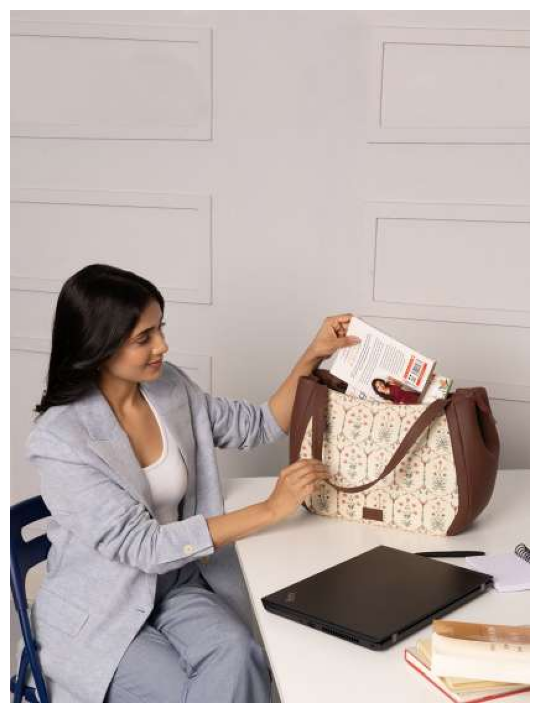

Shop Now @  https://www.myntra.com/handbags/zouk/zouk-floral-printed-oversized-structured-shoulder-bag/25485580/buy


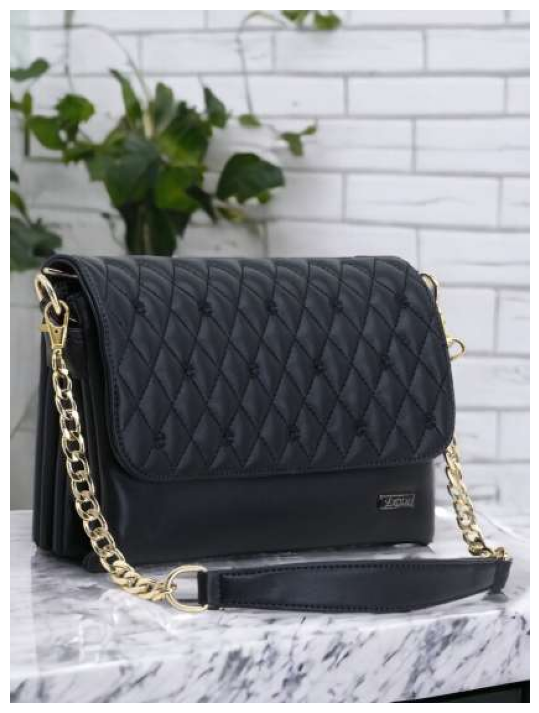

Shop Now @  https://www.myntra.com/handbags/exotic/exotic-black-textured-structured-sling-bag/16088988/buy


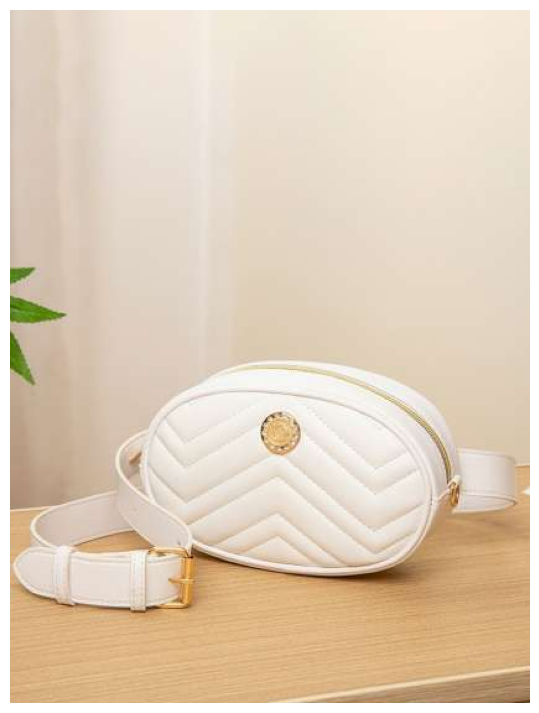

Shop Now @  https://www.myntra.com/handbags/diva+dale/diva-dale-detachable-sling-strap-pu-structured-sling-bag-with-quilted/24773586/buy


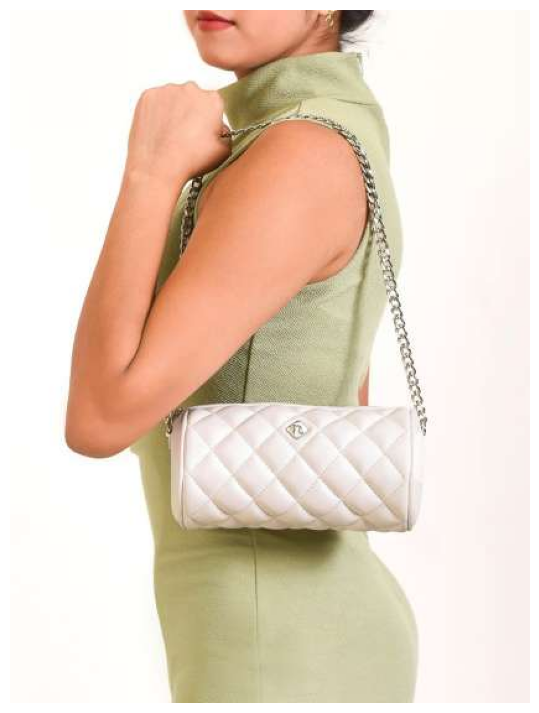

Shop Now @  https://www.myntra.com/handbags/nestasia/nestasia-quilted-structured-shoulder-bag/28916356/buy


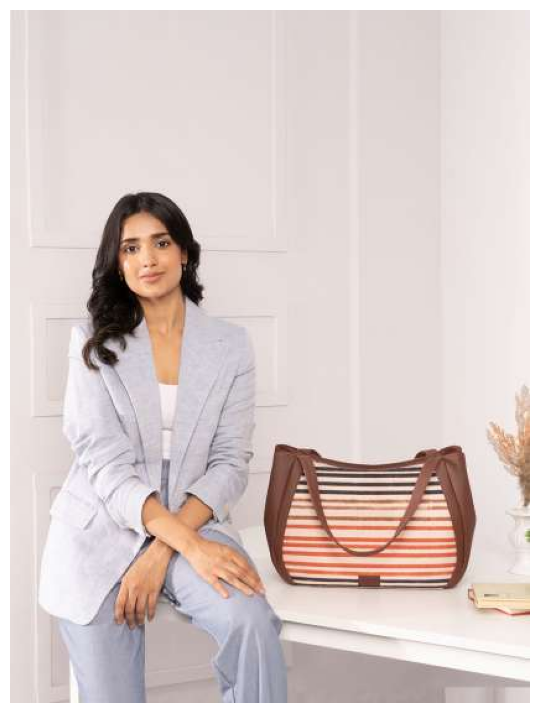

Shop Now @  https://www.myntra.com/handbags/zouk/zouk-striped-oversized-structured-jute-shoulder-bag-up-to-16-inch/25485628/buy


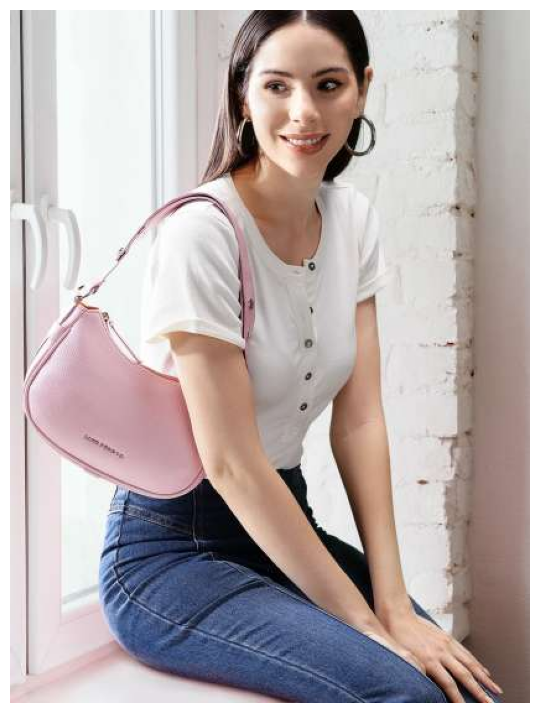

Shop Now @  https://www.myntra.com/handbags/lino+perros/lino-perros-women-lavender-solid-structured-baguette-bag/20216018/buy


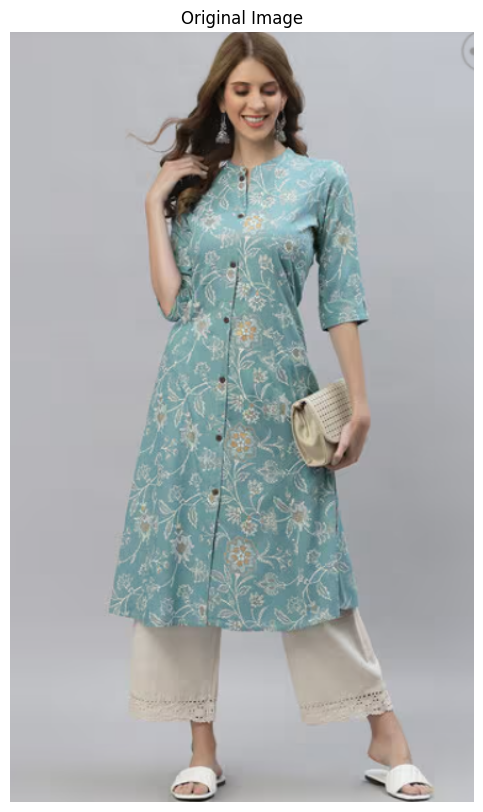

In [76]:
img_path = "./Examples/Test_withPurse.png"
weights_path = "./runs/detect/yolo_small_train/weights/best.pt"  


finder = FIND_SIMILAR_PRODUCTS(img_path, weights_path)
finder.run()